In [2]:
## fonctions de base

#packages

using Pkg
#Pkg.add("LinearAlgebra")
#Pkg.add("LinearSolve")
#Pkg.add("Plots")
#Pkg.add("Printf")
#Pkg.add("LaTeXStrings")
#Pkg.add("Interpolations")
#Pkg.add("NPZ")


using LinearAlgebra
using LinearSolve
using Plots
using LaTeXStrings
using Interpolations
using NPZ
using Printf


#-------------------------------------------------------------------------------------
#	dressing of function f (given as array f_discr, occupation ratio given as n_discr)
#-------------------------------------------------------------------------------------


function f_varphimat(lam_discr,gb)
    L = size(lam_discr)[1]
    varphi(lam) = 2*gb/( gb^2 + lam^2 )
    varphimat = zeros(L,L)
    

    for i = 1:L
        for j = 1:i
            varphimat[i,j] = varphi( lam_discr[i]-lam_discr[j] )
            varphimat[j,i] = varphi( lam_discr[i]-lam_discr[j] )
        end
    end
    varphimat = Symmetric(varphimat)
    return varphimat
end 

function f_dlam(lam_discr)
    L = size(lam_discr)[1]
    dlam = zeros(L)
    for i = 2:L-1
        dlam[i] = 0.5*(lam_discr[i+1]-lam_discr[i-1])
    end
    dlam[1] = 0.5*(lam_discr[2]-lam_discr[1])
    dlam[L] = 0.5*(lam_discr[L]-lam_discr[L-1])
    return dlam
end
    
function dress(gb, lam_discr, n_discr, f_discr)
    
    
    varphimat = f_varphimat(lam_discr,gb)
    dlam = f_dlam(lam_discr)
    
    A = I - 0.5/pi * varphimat*Diagonal(n_discr)*Diagonal(dlam)
    A\f_discr
end

#-------------------------------------------------------------------------------------
#	to evaluate charge density associated with function f
#-------------------------------------------------------------------------------------

function charge_density(gb, lam_discr, n_discr, f_discr)
    L = size(lam_discr)[1]
    varphi(lam) = 2*gb/( gb^2 + lam^2 )
    varphimat = zeros(L,L)
    dlam = zeros(L)

    for i = 1:L
        for j = 1:i
            varphimat[i,j] = varphi( lam_discr[i]-lam_discr[j] )
            varphimat[j,i] = varphi( lam_discr[i]-lam_discr[j] )
        end
    end
    varphimat = Symmetric(varphimat)

    for i = 2:L-1
        dlam[i] = 0.5*(lam_discr[i+1]-lam_discr[i-1])
    end
    dlam[1] = 0.5*(lam_discr[2]-lam_discr[1])
    dlam[L] = 0.5*(lam_discr[L]-lam_discr[L-1])
    A = I - 0.5/pi * varphimat*Diagonal(n_discr)*Diagonal(dlam)
    0.5/pi * dot(dlam , Diagonal(n_discr) * (A \ f_discr) )
end

#-------------------------------------------------------------------------
#	solve Yang-Yang equation
#-------------------------------------------------------------------------

function fun1(z)
    if z>0
        return log(1. +exp(-z))
    else
        return log(1. +exp(z)) - z
    end
end

function fun2(z)
    if z<0
        return 1. /(1. +exp(z))
    else
        return exp(-z)/(1. +exp(-z))
    end
end

function yangyang(gb, beta, lam_discr)
    L = size(lam_discr)[1]
    varphi(lam) = 2*gb/( gb^2 + lam^2 )
    varphimat = zeros(L,L)
    dlam = zeros(L)

    for i = 1:L
        for j = 1:i
            varphimat[i,j] = varphi( lam_discr[i]-lam_discr[j] )
            varphimat[j,i] = varphi( lam_discr[i]-lam_discr[j] )
        end
    end
    varphimat = Symmetric(varphimat)

    for i = 2:L-1
        dlam[i] = 0.5*(lam_discr[i+1]-lam_discr[i-1])
    end
    dlam[1] = 0.5*(lam_discr[2]-lam_discr[1])
    dlam[L] = 0.5*(lam_discr[L]-lam_discr[L-1])

    bare_E = 0.5 * beta[3] * lam_discr.^2 + beta[2] * lam_discr + beta[1] * ones(L)
    eps = copy(bare_E)
    n = fun2.(eps)

    #iterative solution
    diff = 1.
    while diff>1e-12
        old_n = copy(n)
        eps = bare_E - 0.5/pi * varphimat*Diagonal( fun1.(eps) )*dlam
        n = fun2.(eps)
        diff = norm(n-old_n)
    end
    eps = bare_E - 0.5/pi * varphimat*Diagonal( fun1.(eps) )*dlam
    n = fun2.(eps)
    return n
end

#-------------------------------------------------------------------------------------
#	compute effective velocity
#-------------------------------------------------------------------------------------

function veff(gb, lam_discr, n_discr)
    L = size(lam_discr)[1]
    varphi(lam) = 2*gb/( gb^2 + lam^2 )
    varphimat = zeros(L,L)
    dlam = zeros(L)

    for i = 1:L
        for j = 1:i
            varphimat[i,j] = varphi( lam_discr[i]-lam_discr[j] )
            varphimat[j,i] = varphi( lam_discr[i]-lam_discr[j] )
        end
    end
    varphimat = Symmetric(varphimat)

    for i = 2:L-1
        dlam[i] = 0.5*(lam_discr[i+1]-lam_discr[i-1])
    end
    dlam[1] = 0.5*(lam_discr[2]-lam_discr[1])
    dlam[L] = 0.5*(lam_discr[L]-lam_discr[L-1])
    dresser = I - 0.5/pi * varphimat*Diagonal(n_discr)*Diagonal(dlam)
    onedr = dresser\ones(L)
    iddr = dresser\copy(lam_discr)
    iddr ./ onedr
end

#-------------------------------------------------------------------------------------
#	time evolution for box expansion
#-------------------------------------------------------------------------------------

function evol_box_expansion(dt, x1, x2, gb, theta_tab, n_fun)
    npts_integral = 600
    L = size(x1)[1]
    
    veff1 = zeros(L)
    veff2 = zeros(L)
    #println(@sprintf "size x2 = %.3f , size theta_tab  = %.3f " size(x1)[1] size(theta_tab)[1])
    #display(x2)
    #display(theta_tab)
    f2 = linear_interpolation(x2, theta_tab)
    f1 = linear_interpolation(x1, theta_tab)
    #velocity of first and last points is the one of free particles
    veff1[1] = theta_tab[1]
    veff2[L] = theta_tab[L]

    for j in 2:L
        thet1 = theta_tab[j]
        if x1[j]<x2[1]
            thet2 = theta_tab[1]
        else
            thet2 = f2(x1[j])
        end
        lam_discr = LinRange(thet2,thet1,npts_integral)
        n_discr = n_fun.(lam_discr)
        veff1[j] = last(veff(gb, lam_discr, n_discr))
        #velocities of right contour (using parity symmetry)
        #veff2[L+1-j] = -veff1[j]
    end
    # sans symetrie
    for j in 1:L-1
        thet1 = theta_tab[j]
        if x2[j] > x1[L]
            thet2 = theta_tab[L]
        else 
            thet2 = f1(x2[j])
        end 
        lam_discr = LinRange(thet1, thet2, 600)
        n_discr = n_fun.(lam_discr)
        veff2[j] = veff(gb, lam_discr, n_discr)[1]
    end
    
    return x1 + dt*veff1, x2 + dt*veff2
end

#-------------------------------------------------------------------------------------
#	box expansion: calculate density (careful: return density in units of rapidities
#    for density in mu^-1 multiply by mass/hbar)
#-------------------------------------------------------------------------------------

function eval_density(x1, x2, gb, theta_tab, n_fun, ratio_m_hbar)
    L = size(x1)[1]
    
    dens = zeros(2,2*L)
    f2 = linear_interpolation(x2, theta_tab)
    f1 = linear_interpolation(x1, theta_tab)
    #density of first and last points is zero
    dens[1,1] = x1[1]
    dens[2,1] = 0
    dens[1,L+1] = x2[L]
    dens[2,L+1] = 0
    #println( @sprintf "n_p = %.3f" ratio_m_hbar * charge_density(gb, theta_tab, n_fun.(theta_tab), ones(size(theta_tab)[1]) ))
    for j in 2:L
        thet1 = theta_tab[j]
        if x1[j]<x2[1]
            thet2 = theta_tab[1]
        else
            #println("nnn")
            thet2 = f2(x1[j])
        end
        lam_discr = LinRange(thet2,thet1,600)
        n_discr = n_fun.(lam_discr)
        dens[1,j] = x1[j]
        dens[2,j] = ratio_m_hbar * charge_density(gb, lam_discr, n_discr, ones(size(lam_discr)[1]) )
        #if j == L 
        #    println( @sprintf " j = %.3f , theta 1 = %.3f , theta 2 = %.3f , n_p1 = %.3f" j thet2 thet1 dens[2,j])
        #end 
        #velocities of right contour (using parity symmetry)
        #dens[1,L+j] = x2[L+1-j]      
        #dens[2,L+j] = dens[2,j]
    end
    #without symmetry 
    for j in 1:L-1
        thet1 = theta_tab[j]
        if x2[j]>x1[L]
            thet2 = theta_tab[L]
        else 
            #println("nnn")
            thet2 = f1(x2[j])
        end 
        lam_discr = LinRange(thet1,thet2,600)
        n_discr = n_fun.(lam_discr)
        dens[1,2*L+1-j] = x2[j] 
        dens[2,2*L+1-j] = ratio_m_hbar * charge_density(gb, lam_discr, n_discr, ones(size(lam_discr)[1]) ) 
        #if j == 1 
        #    println( @sprintf " j = %.3f , theta 1 = %.3f , theta 2 = %.3f , n_p1 = %.3f" j thet1 thet2 dens[2,2*L+1-j])
        #end 
    end
    #sort densities according to positions, and return
    dens[:,sortperm(dens[1, :])]
end

#------------------------------------------------------------------------------------------------
#	function for simulating box expansion. Writes results in file 'data/density_expansion_t.npd'
#     where 't' is the time (takes a list of times to be saved as argument)
#------------------------------------------------------------------------------------------------

function box_expansion(n_fun, dt, list_t_save, theta_max, npts, gb, ratio_m_hbar)
    tmax = maximum(list_t_save)
    theta_tab = LinRange(-theta_max, theta_max, npts)
    x1 = -0.5 * ones(npts) + 0.0000001*theta_tab
    x2 = 0.5 * ones(npts) + 0.0000001*theta_tab
        
    t = 0
    while t<=tmax
        x1, x2 = evol_box_expansion(dt, x1, x2, gb, theta_tab, n_fun)
        t += dt
        
        for ts in list_t_save
            if t-dt<ts && ts<=t
                mydensity = eval_density(x1, x2, gb, theta_tab, n_fun, ratio_m_hbar)
                println(@sprintf "t = %.3f saved" t)
                #filename = @sprintf "%s/density_expansion_n_theta_etoile_conv_py_%.3f_%.3f_%.3f_%.3f.npz" new_date Float64(mu) Float64(T) Float64(Taille) Float64(t)
                #filename = @sprintf "%s/density_expansion_n_py_%.3f_%.3f_%.3f_%.3f.npz" new_date Float64(mu) Float64(T) Float64(Taille) Float64(t)
                filename = @sprintf "%s/density_expansion_n_theta_etoile_py_%.3f_%.3f_%.3f_%.3f.npz" new_date Float64(mup/kB) Float64(T) Float64(Taille) Float64(t)
                #filename = @sprintf "%s/density_expansion_n_tout_py_%.3f_%.3f_%.3f_%.3f.npz" new_date Float64(mup/kB) Float64(T) Float64(Taille) Float64(t)
                npzwrite(filename, mydensity)
            end
        end
    end
end



box_expansion (generic function with 1 method)

In [3]:
function DeltaMat(theta_discr , gbar )
    L = size(theta_discr)[1]
    varphi(theta) = 2*gbar/( gbar^2 + theta^2 )
    varphimat = zeros(L,L)
    

    for i = 1:L
        for j = 1:i
            varphimat[i,j] = varphi( theta_discr[i]-theta_discr[j] )
            varphimat[j,i] = varphi( theta_discr[i]-theta_discr[j] )
        end
    end
    varphimat = Symmetric(varphimat)
    return varphimat
end 

function Delta(theta_discr)
    L = size(theta_discr)[1]
    dtheta = zeros(L)
        
    for i = 2:L-1
        dtheta[i] = 0.5*(theta_discr[i+1]-theta_discr[i-1])
    end
    dtheta[1] = 0.5*(theta_discr[2]-theta_discr[1])
    dtheta[L] = 0.5*(theta_discr[L]-theta_discr[L-1])
    
    return dtheta
end 

function montrer_les_rho(theta_discr, nu_discr)
    L = length(theta_discr)
    
    varphimat = DeltaMat(theta_discr , gbar)
    dtheta = Delta(theta_discr)
    
    # Plot nu_tilde
    p = plot(xlabel="\$\\tilde{\\theta}\$", ylabel="f", legend=:topright)
    plot!(p , theta_discr , nu_discr, label="\$\\tilde{\\nu}\$")
    # Méthode 0
    rho_s_0 = 0.5 / pi * dress(gbar , theta_discr, nu_discr, ones(L))
    rho_0 = nu_discr .* rho_s_0
    
    # Méthode 1
    Mat_F_1 = I - (1 / (2 * pi)) * Diagonal(dtheta) * Diagonal(nu_discr) * varphimat
    B = (1 / (2 * pi)) * nu_discr
    rho_1 = Mat_F_1 \ B
    rho_s_1 = rho_1 ./ nu_discr

    # Méthode 2
    Mat_F_2 = I - 0.5 / pi * varphimat * Diagonal(nu_discr) * Diagonal(dtheta)
    B = (1 / (2 * pi)) * ones(L)
    rho_s_2 = Mat_F_2 \ B
    rho_2 = nu_discr .* rho_s_2
    
    # Plot résultats de la méthode 0
    plot!(p, theta_discr, rho_s_0, label="Meth 0 : \$\\tilde{\\rho_s}= \\frac{1}{2\\pi}\\\$")
    plot!(p, theta_discr, rho_0, label="Meth 0 : \$\\tilde{\\rho} = \\tilde{\\nu} * \\tilde{\\rho_s}\$")
    
    # Plot résultats de la méthode 1
    plot!(p, theta_discr, rho_1, label="Meth 1 : \$\\tilde{\\rho}= \\frac{\\tilde{\\nu}}{2\\pi} ( 1 + \\tilde{\\Delta} * \\tilde{\\rho}) \$")
    plot!(p, theta_discr, rho_s_1, label="Meth 1 : \$\\tilde{\\rho}_s  = \\frac{\\tilde{\\rho}}{\\tilde{\\nu}}  \$")
    
    # Plot résultats de la méthode 2
    plot!(p, theta_discr, rho_s_2, label="Meth 2 : \$\\tilde{\\rho_s}= \\frac{1}{2\\pi}\$")
    plot!(p, theta_discr, rho_2, label="Meth 2 : \$\\tilde{\\rho} = \\tilde{\\nu} * \\tilde{\\rho_s}\$")

    display(p)
    
    #p1 = plot(xlabel="\$\\tilde{\\theta}\$", ylabel="\$\\Delta\$", legend=:topright)

    # Plot des différences entre les résultats des deux méthodes
    #plot(p1,theta_discr, rho_s_1 - rho_s_2, label="\$ \\Delta \\tilde{\\rho_s}\$")
    #plot(p1,theta_discr, rho_1 - rho_2, label="\$\\Delta \\tilde{\\rho}\$")

    # Légendes et labels
    #display(p1)
end

#-------------------------------------------------------------------------------------
#	theta start
#-------------------------------------------------------------------------------------

using Roots
function find_nu_theta_star_discr( theta_discr , theta_star  , nu_discr )
    return ifelse.(theta_discr .> theta_star, 0, nu_discr)
end 

function find_theta_star(theta_discr, nu_discr ,  gbar)
    
    # Définition de la fonction f_veff_star_theta_star
    f_veff_star_theta_star = theta_star -> linear_interpolation(theta_discr, veff( gbar, theta_discr, find_nu_theta_star_discr(theta_discr, theta_star, nu_discr)))(theta_star)
    
    return fzero(f_veff_star_theta_star, theta_discr[1] , last(theta_discr))
end

find_theta_star (generic function with 1 method)

In [4]:
import Pkg
#Pkg.add("Dates")
using Dates

# Formater la date selon le format spécifié
new_date = Dates.format(Dates.today(), "yyyy-mm-dd")

# Creer  le dossier
if !isdir(new_date)
    mkdir(new_date)
end

# Afficher la date formatée
println(new_date)

2024-11-11


In [5]:
new_date = "analyse_2024-11-04"
# Creer  le dossier
if !isdir(new_date)
    mkdir(new_date)
end

# Afficher la date formatée
println(new_date)

analyse_2024-11-04


In [6]:
using Plots
using Printf
using Interpolations

# Définir les constantes
hbar = 1.05457182e-25   # um^2.kg/ms
mass =  1.44e-25        # kg (mass of Rubidium 87)
kB = 1.380649e-26       # um^2.ms^-2.kg.nK^{-1}
a3D = 5.3e-3            # um
om_perp = 2 * pi * 2.56  # kHz (transverse frequency)

# Calculer les constantes dérivées
g = 2 * hbar * a3D * om_perp        # effective 1d repulsion strength
c = mass / hbar^2 * g              # um^{-1}
gbar = g / hbar                   # um.ms^{-1}

0.17050051649562528

test_1
None
saved : test_1/theta_discr_1.npz
  0.730643 seconds (480.12 k allocations: 41.739 MiB, 89.52% compilation time)
saved : test_1/nu_discr_1_50.000_100.000.npz


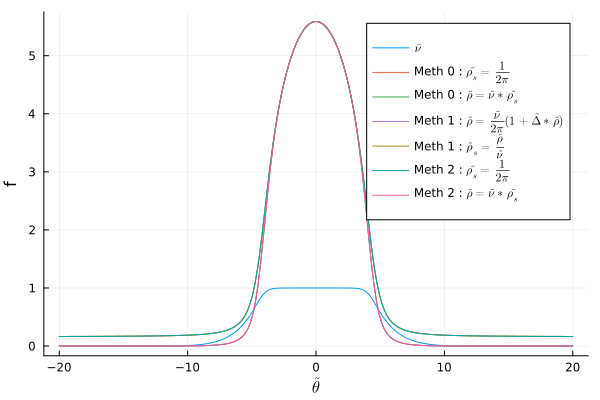

  0.009506 seconds (21 allocations: 1.840 MiB)
saved : test_1/rho_s_discr_1_50.000_100.000.npz
  0.102522 seconds (8.53 k allocations: 498.732 KiB, 99.94% compilation time)
saved : test_1/rho_discr_1_50.000_100.000.npz
  0.309569 seconds (197.73 k allocations: 15.438 MiB, 98.18% compilation time)
saved : test_1/veff_discr_1_50.000_100.000.npz
saved : test_1/veff_bord_discr_1_50.000_100.000.npz


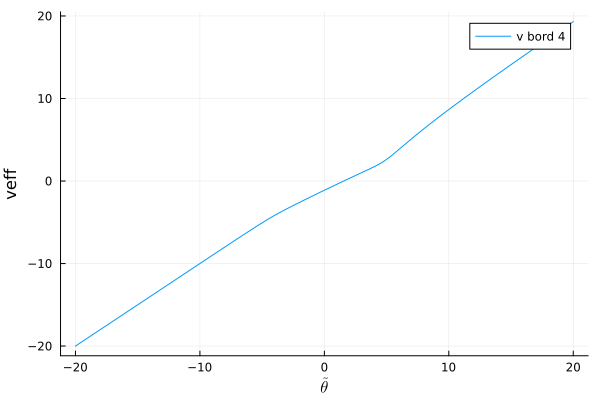

  1.093075 seconds (779.21 k allocations: 189.061 MiB, 12.35% gc time, 62.35% compilation time)
saved : test_1/test_1_50.000_100.000.npz
  0.000037 seconds (110 allocations: 5.250 KiB)
saved : test_1/nu_test_discr_1_50.000_100.000.npz
theta_star = 1.398 
  0.003438 seconds (21 allocations: 1.840 MiB)
saved : test_1/rho_s_test_discr_1_50.000_100.000.npz
  0.000056 seconds (3 allocations: 1.828 KiB)
saved : test_1/rho_test_discr_1_50.000_100.000.npz


(LinRange{Float64}(-20.0, 20.0, 200), [1.4531222746508125e-9, 2.2058584871022947e-9, 3.334464801109599e-9, 5.019353354315963e-9, 7.523894482865387e-9, 1.1230809827263456e-8, 1.66937178753668e-8, 2.470977912938341e-8, 3.642156845123399e-8, 5.345921946280571e-8  …  5.3459219462805325e-8, 3.642156845123399e-8, 2.470977912938341e-8, 1.66937178753668e-8, 1.1230809827263336e-8, 7.523894482865387e-9, 5.019353354315963e-9, 3.334464801109599e-9, 2.2058584871022947e-9, 1.4531222746508125e-9], [0.22503534685250134, 0.22520024451152806, 0.22537057994330534, 0.22554659938508423, 0.22572856345796677, 0.22591674821868526, 0.22611144631303168, 0.22631296823019126, 0.2265216436751248, 0.22673782307455503  …  0.22673782307455514, 0.22652164367512498, 0.2263129682301911, 0.22611144631303196, 0.22591674821868504, 0.2257285634579669, 0.22554659938508434, 0.22537057994330553, 0.225200244511528, 0.22503534685250118], [3.270038750951413e-10, 4.967598706532661e-10, 7.514902660266086e-10, 1.1320980801780812e-9,

In [7]:
theta_max = 20
npts = 200
theta_discr = LinRange(-theta_max, theta_max , npts) 


#------------------------------------------------------------------------------------------------
#	Fonction pour calculer les nu , rho et rho_s et predire cest fonction apres la coupure 1 
#-
function save_nu_rho_rho_s(new_date , nom , theta_discr, n_p  , mup , T , Taille , gbar )
    if mup == "None" 
       mup = hbar * om_perp * (sqrt(1 + 4 * n_p * a3D) - 1)   #kg um^2.ms^-1
    else 
        n_p = (((mup / (hbar * om_perp)) + 1)^2 - 1) / (4 * a3D)
    end
    # Discrétisation de theta
    beta = [-mup / (kB * T) 0 mass * g^2/(kB * T * hbar^2)]
    beta = [-mup / (kB * T) 0 mass /(kB * T)]

    # Définir la date sous forme de chaîne

    index_last_underscore = findlast(isequal('_'), nom)

    
    filename = @sprintf "%s/theta_discr_%s.npz" new_date nom[index_last_underscore+1:end]
    npzwrite(filename, theta_discr )
    println("saved : ", filename)  

    @time nu_discr = yangyang(gbar, beta, theta_discr)
    #println(nu_discr)
    #println("size : ", size(nu_discr)[1])
    #println(new_date, nom[index_last_underscore+1:end], mup/kB, T)
    #println(T)
    #densite = mass/hbar* charge_density(gbar, theta_discr, nu_discr, ones(size(theta_discr)[1]) )
    #println(@sprintf "dendite : %.3f atom/mu m " densite)
    filename = @sprintf "%s/nu_discr_%s_%.3f_%.3f.npz" new_date nom[index_last_underscore+1:end] mup/kB T
    npzwrite(filename, nu_discr )
    println("saved : ", filename)
    montrer_les_rho(theta_discr , nu_discr)

    @time rho_s_discr = 0.5 / pi * mass/hbar*dress(gbar, theta_discr, nu_discr, ones(size(theta_discr)[1]))
    filename = @sprintf "%s/rho_s_discr_%s_%.3f_%.3f.npz" new_date nom[index_last_underscore+1:end] mup/kB T
    npzwrite(filename, rho_s_discr )
    println("saved : ", filename)

    @time rho_discr = nu_discr .* rho_s_discr
    filename = @sprintf "%s/rho_discr_%s_%.3f_%.3f.npz" new_date nom[index_last_underscore+1:end] mup/kB T
    npzwrite(filename, rho_discr )
    println("saved : ", filename)
    
    ## veff de bord j'ai 3 metdode qui donnent la meme foction à voir 
    @time veff_discr = veff( gbar, theta_discr, nu_discr)
    filename = @sprintf "%s/veff_discr_%s_%.3f_%.3f.npz" new_date nom[index_last_underscore+1:end] mup/kB T
    npzwrite(filename, veff_discr )
    println("saved : ", filename)
    
    #theta_veff = linear_interpolation(veff_discr, theta_discr)
    #f_veff_star_theta_star = theta_star -> linear_interpolation(theta_discr, veff( gbar, theta_discr, ifelse.(theta_discr .< theta_star, 0, nu_discr)))(theta_star)
    #theta_star = 0 
    #println( @sprintf "veff (%.3f) = %.3f" theta_star f_veff_star_theta_star(theta_star))
    #montrer_les_rho(theta_discr , nu_discr)
    #veff_discr_1 = [f_veff_star_theta_star(theta) for theta in theta_discr]
    
    function f_veff_star_theta_star_2(theta_star)
        theta_max = last(theta_discr)
        #println(@sprintf "max : %.3f"  maximum(theta_discr))
        #println("mim : " , minimum(theta_discr))    
        if theta_star == -theta_max 
            return -theta_max
        end 
        lam_discr = LinRange(-theta_max, theta_star , 200)
        n_fun = LinearInterpolation(theta_discr , nu_discr)
        n_discr = n_fun.(lam_discr)
        return last(veff( gbar, lam_discr, n_discr))
    end 
        
    #find_nu_theta_star_discr( theta_discr , theta_star  , nu_discr )return ifelse.(theta_discr .> theta_star, 0, nu_discr)
    function f_veff_star_theta_star_3(theta_star)
        theta_max = last(theta_discr)
        #println(@sprintf "max : %.3f"  maximum(theta_discr))
        #println("mim : " , minimum(theta_discr))    
        if theta_star == -theta_max 
            return -theta_max
        end 
        n_discr_3 = find_nu_theta_star_discr( theta_discr , theta_star  , nu_discr )
        #plot!(p, theta_discr,  n_discr_3, label="n_{$(theta_star)}")
        #plot!(p1, theta_discr,  veff( gbar, theta_discr, n_discr_3), label="v_{$(theta_star)}")
        veff_fun = LinearInterpolation(theta_discr,veff( gbar, theta_discr, n_discr_3)  )
        return veff_fun(theta_star)
    end 
        
    
    #println( @sprintf "veff (%.3f) = %.3f" theta_star f_veff_star_theta_star_2(theta_star))
    #veff_discr_2 = [f_veff_star_theta_star_2(theta) for theta in theta_discr]
        
    L = size(theta_discr)[1]    
    veff_discr_4 = zeros(L)
    #p = plot(xlabel="\$\\tilde{\\theta}\$", ylabel="n", legend=:topright)
    #p1 = plot(xlabel="\$\\tilde{\\theta}\$", ylabel="veff", legend=:topright)
    for i = 1 : L 
        veff_discr_4[i] = f_veff_star_theta_star_3(theta_discr[i])
    end 
    #display(p)
    #display(p1)

    
    #@time veff_discr_3 = [theta_star == theta_max ? theta_max : veff(gbar, LinRange(theta_star, theta_max, 600), LinearInterpolation(theta_discr, nu_discr).(LinRange(theta_star, theta_max, 600)))[1] for theta_star in theta_discr]
    filename = @sprintf "%s/veff_bord_discr_%s_%.3f_%.3f.npz" new_date nom[index_last_underscore+1:end] mup/kB T
    npzwrite(filename, veff_discr_4 )
    println("saved : ", filename)
        
    p = plot(xlabel="\$\\tilde{\\theta}\$", ylabel="veff", legend=:topright)
    #plot!(p, theta_discr, veff_discr, label="v_0")
    #plot!(p, theta_discr, veff_discr_1, label="v bord 1")
    #plot!(p, theta_discr, veff_discr_2, label="v bord 2")
    #plot!(p, theta_discr, veff_discr_3, label="v bord 3")
    plot!(p, theta_discr, veff_discr_4, label="v bord 4")
    display(p)
            
            
    f = theta_star -> f_veff_star_theta_star_2(theta_star)
    
    @time theta_star = fzero(f, theta_discr[1] , last(theta_discr))
    #@time theta_star = find_theta_star(theta_discr, nu_discr ,gbar)
    filename = @sprintf "%s/%s_%.3f_%.3f.npz" new_date nom mup/kB T
    npzwrite(filename, theta_star )
    println("saved : ", filename)

    @time nu_theta_star_discr = find_nu_theta_star_discr(theta_discr , theta_star  , nu_discr )
    filename = @sprintf "%s/nu_%s_discr_%s_%.3f_%.3f.npz" new_date nom[1:index_last_underscore-1] nom[index_last_underscore+1:end] mup/kB T
    nu_theta_star_discr = Float64.(nu_theta_star_discr)
    npzwrite(filename, nu_theta_star_discr )
    println("saved : ", filename)
    
    #f_veff_star_theta_star = theta_star -> linear_interpolation(theta_discr, veff( gbar, theta_discr, ifelse.(theta_discr .> theta_star, 0, nu_discr)))(theta_star)
    #println( @sprintf "veff (%.3f) = %.3f" theta_star f_veff_star_theta_star(theta_star))

    
    #function f_veff_star_theta_star_2(theta_star, theta_discr, veff, gbar, nu_discr)
        #nu_theta_star_discr = find_nu_theta_star_discr(theta_discr, theta_star, nu_discr)
    #    nu_theta_star_discr_ast = ifelse.(theta_discr .> theta_star, 0, nu_discr)
    #    v_eff = veff(gbar, theta_discr, nu_theta_star_discr_ast)
    #    interpolation = LinearInterpolation(theta_discr, v_eff)
    #    return interpolation(theta_star)
    #end

    # Calculer f_veff_star_theta_star pour chaque élément de theta_star
    #f_veff_star_theta_star_vector = [f_veff_star_theta_star_2(theta_star, theta_discr, veff, gbar, nu_discr) for theta_star in theta_star]
    #display(f_veff_star_theta_star_vector)
    #f_veff_star_theta_star_vector_1 = zeros(npts)
    #f_veff_star_theta_star_vector_2 = zeros(npts)
    #for i = 1:npts
    #    f_veff_star_theta_star_vector_1[i] = f_veff_star_theta_star(theta_discr[i])
    #    f_veff_star_theta_star_vector_2[i] = f_veff_star_theta_star_2(theta_discr[i], theta_discr, veff, gbar, nu_discr)
    #end
    # Affichage des résultats
    #for (theta_star_value, f_value) in zip(theta_discr, f_veff_star_theta_star_vector_2)
    #    if abs.(f_value)<1 
    #        println(@sprintf "veff (%.3f) = %.3f" theta_star_value f_value)
    #    end
    #end
    
    
    #theta_star = fzero(f_veff_star_theta_star, theta_star-1 , theta_star+1)
    println(@sprintf "theta_star = %.3f " theta_star)



    @time rho_s_theta_star_discr = 0.5 / pi * mass/hbar * dress(gbar, theta_discr, nu_theta_star_discr, ones(size(theta_discr)[1]))
    filename = @sprintf "%s/rho_s_%s_discr_%s_%.3f_%.3f.npz" new_date nom[1:index_last_underscore-1] nom[index_last_underscore+1:end] mup/kB T
    npzwrite(filename, rho_s_theta_star_discr )
    println("saved : ", filename)

    @time rho_theta_star_discr = nu_theta_star_discr .* rho_s_theta_star_discr
    filename = @sprintf "%s/rho_%s_discr_%s_%.3f_%.3f.npz" new_date nom[1:index_last_underscore-1] nom[index_last_underscore+1:end] mup/kB T
    npzwrite(filename, rho_theta_star_discr )
    println("saved : ", filename)
    
    return theta_discr , nu_discr , rho_s_discr , rho_discr , veff_discr , veff_discr_4 ,  
                            theta_star, nu_theta_star_discr, rho_s_theta_star_discr, rho_theta_star_discr

end 

new_date = "test_1"
if !isdir(new_date)
    mkdir(new_date)
    end
nom = "test_1"

    
# Afficher la date formatée
println(new_date)
mup = 50 * kB
n_p = "None"
println(n_p)
T = 100                           
theta_discr , nu_discr , rho_s_discr , rho_discr ,veff_bord, veff_bord_coup , theta_star, nu_theta_star_discr, rho_s_theta_star_discr, rho_theta_star_discr = save_nu_rho_rho_s(new_date , nom , theta_discr, n_p , mup ,  T , 30 , gbar )


In [8]:
T = 600#coef(fit)[1]  
n_p = 56.46504685
mu = hbar*om_perp * (sqrt(1 + 4 * n_p * a3D) - 1)/kB
println("mu = ", mu)
mu = coef(curve_fit(model_mu, T*ones(1) , n_p*ones(1) , mu*kB/hbar*ones(1) ))[1] 
#mu = 29.993145799296883
println("mu = ", mu)
println("T = ", T) 
println("n_p , model_mu(T , mu)", model_mu(T*ones(1) , mu*ones(1))[1])
mup = mu*kB
Taille = 24.780000000000086  #mu m 
n_p = "None"
println("npts = ", npts)
@time theta_discr = LinRange(-theta_max, theta_max, npts)


theta_discr , nu_discr , rho_s_discr , rho_discr ,veff_bord, veff_bord_coup ,
theta_star, nu_theta_star_discr, rho_s_theta_star_discr, rho_theta_star_discr = 
save_nu_rho_rho_s(new_date , nom , theta_discr, n_p , mup ,  T , Taille , gbar )

@time beta = [-mup / (kB * T) 0 mass /(kB * T)]
@time nu_discr = yangyang(gbar, beta, theta_discr)

p = plot(xlabel="\$\\tilde{\\theta}\$", ylabel="nu", legend=:topright)
plot!(p, theta_discr, nu_discr, label="nu")
display(p)


mu = 59.24928388361869


LoadError: UndefVarError: `model_mu` not defined

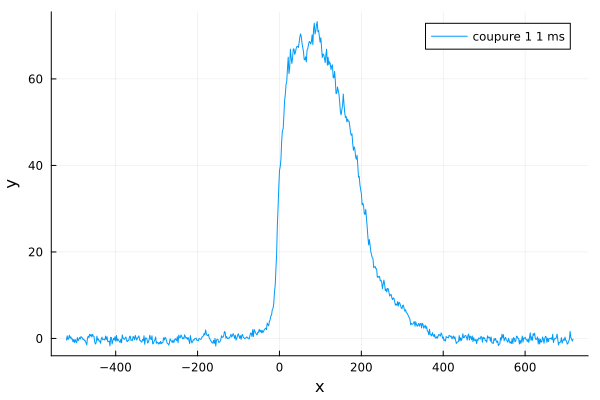

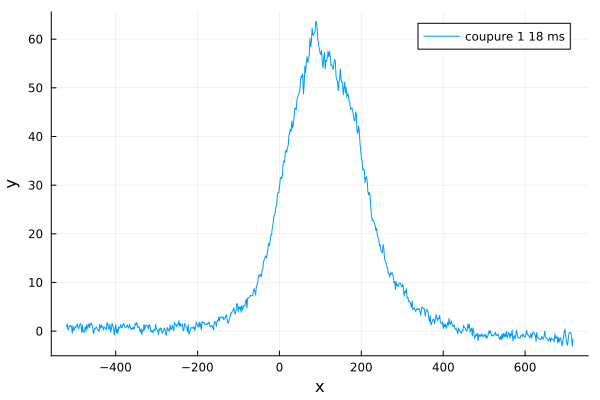

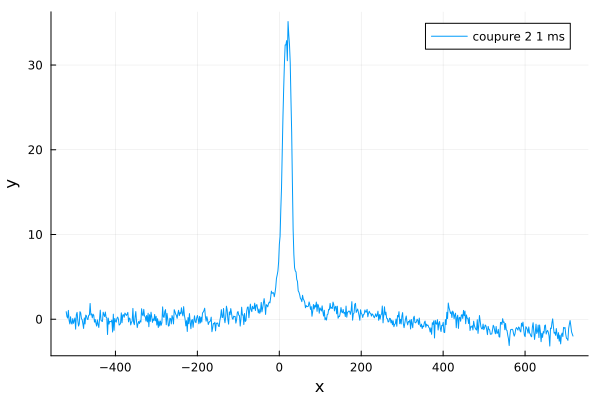

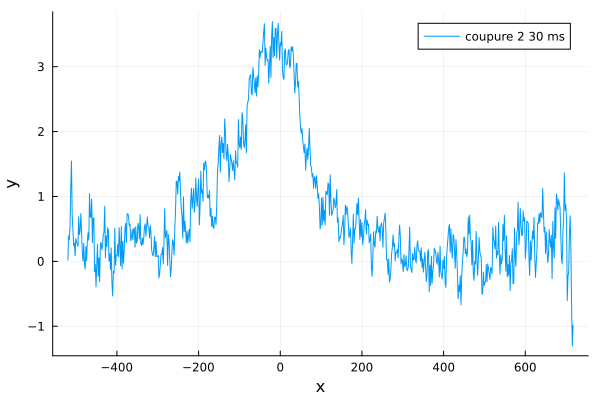

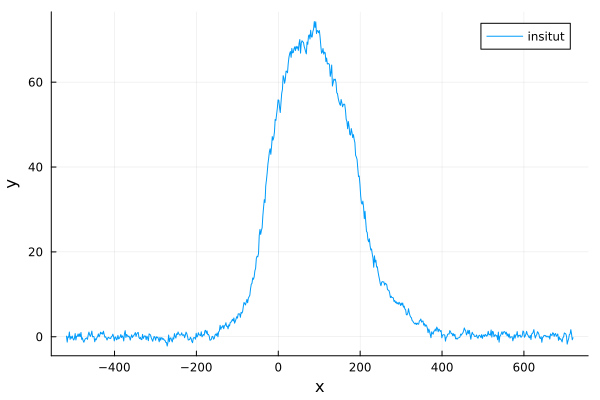

In [9]:
using DelimitedFiles

date_donnees = "2024-04-24"

DONNEES = []

if date_donnees == "None"
    fichier_x = "Scan43_coupure2_1ms_x.txt"
    fichier_y = "Scan43_coupure2_1ms_n.txt"
    Donnees = [readdlm("2024-02-05/Donnees/$(fichier_x)") , reverse(readdlm("2024-02-05/Donnees/$(fichier_y)")) * 0 , "2em coupure 1ms"]
    push!(DONNEES, Donnees)
    fichier_x = "Scan43_coupure1_10ms_x.txt"
    fichier_y = "Scan43_coupure1_10ms_n.txt"
    Donnees = [readdlm("2024-02-05/Donnees/$(fichier_x)") , reverse(readdlm("2024-02-05/Donnees/$(fichier_y)")) * 0 , "1er coupure 10 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "Scan43_x.txt"
    fichier_y = "Scan43_n.txt"
    Donnees = [readdlm("2024-02-05/Donnees/$(fichier_x)") , reverse(readdlm("2024-02-05/Donnees/$(fichier_y)")) * 0 , "2em coupure 40 ms"]
    push!(DONNEES, Donnees)
elseif date_donnees == "2024-02-05"
    fichier_x = "Scan43_coupure2_1ms_x.txt"
    fichier_y = "Scan43_coupure2_1ms_n.txt"
    Donnees = [readdlm("$(date_donnees)/Donnees/$(fichier_x)") , reverse(readdlm("$(date_donnees)/Donnees/$(fichier_y)")) , "2em coupure 1ms"]
    push!(DONNEES, Donnees)
    fichier_x = "Scan43_coupure1_10ms_x.txt"
    fichier_y = "Scan43_coupure1_10ms_n.txt"
    Donnees = [readdlm("$(date_donnees)/Donnees/$(fichier_x)") , reverse(readdlm("$(date_donnees)/Donnees/$(fichier_y)")) , "1er coupure 10 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "Scan43_x.txt"
    fichier_y = "Scan43_n.txt"
    Donnees = [readdlm("$(date_donnees)/Donnees/$(fichier_x)") , reverse(readdlm("$(date_donnees)/Donnees/$(fichier_y)")) , "2em coupure 40 ms"]
    push!(DONNEES, Donnees)
elseif date_donnees == "2024-02-09"
    fichier_x = "X_Scan704_18ms.txt"
    fichier_y = "Y_Scan704_18ms.txt"
    Donnees = [-readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "Première coupure expansion 18 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "X_Scan696_1ms.txt"
    fichier_y = "Y_Scan696_1ms.txt"
    Donnees = [-readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "Seconde coupure sélection 1 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "X_Scan696_50ms.txt"
    fichier_y = "Y_Scan696_50ms.txt"
    Donnees = [-readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "Seconde coupure expansion 50 ms"]
    push!(DONNEES, Donnees)
elseif date_donnees == "2024-02-29" 
    fichier_x = "X_coupure1_1ms.txt"
    fichier_y = "Y_coupure1_1ms.txt"
    Donnees = [-readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "coupure 1 1 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "X_coupure1_28ms.txt"
    fichier_y = "Y_coupure1_28ms.txt"
    Donnees = [-readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "coupure 1 28 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "X_coupure2_1ms.txt"
    fichier_y = "Y_coupure2_1ms.txt"
    Donnees = [-readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "coupure 2 1 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "X_coupure2_50ms.txt"
    fichier_y = "Y_coupure2_50ms.txt"
    Donnees = [-readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "coupure 2 50 ms"]
    push!(DONNEES, Donnees)
elseif date_donnees == "2024-04-24"
    fichier_x = "X_coupure1_1ms.txt"
    fichier_y = "Y_coupure1_1ms.txt"
    Donnees = [readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "coupure 1 1 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "X_coupure1_18ms.txt"
    fichier_y = "Y_coupure1_18ms.txt"
    Donnees = [readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "coupure 1 18 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "X_coupure2_1ms.txt"
    fichier_y = "Y_coupure2_1ms.txt"
    Donnees = [readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "coupure 2 1 ms"]
    push!(DONNEES, Donnees)
    fichier_x = "X_coupure2_30ms.txt"
    fichier_y = "Y_coupure2_30ms.txt"
    Donnees = [readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "coupure 2 30 ms"]
    push!(DONNEES, Donnees)    
    fichier_x = "X_insitut.txt"
    fichier_y = "Y_insitut.txt"
    Donnees = [readdlm("$(date_donnees)/Donnees/$(fichier_x)") , readdlm("$(date_donnees)/Donnees/$(fichier_y)") , "insitut"]
    push!(DONNEES, Donnees)                         
end

for i in 1:length(DONNEES)
    p = plot(xlabel="x", ylabel="y", legend=:topright)                           
    x , y , label = DONNEES[i]    
    plot!(p, x,  y, label = label)
    display(p)                         
end                             

# Bord ( 2em coupure homogène)

In [10]:
function pre_model_fit_homo(new_date , nom , theta_discr, n_p , mup ,  T , Taille , gbar )
    
    function box_expansion(n_fun, dt, list_t_save, theta_max, npts, gb, ratio_m_hbar)
        
        filename0 = @sprintf "%s/density_expansion_nu_julia_%.3f_%.3f_%.3f_" new_date Float64(mup/kB) Float64(T) Float64(Taille)
        filename0 = @sprintf "%s/density_expansion_nu_%s_%.3f_%.3f_%.3f_" new_date nom Float64(mup/kB) Float64(T) Float64(Taille)
    
        tmax = maximum(list_t_save)
        theta_tab = LinRange(-theta_max, theta_max, npts)
        x1 = -0.5 * ones(npts) + 0.0000001*theta_tab
        x2 = 0.5 * ones(npts) + 0.0000001*theta_tab

        t = 0

        mydensity = eval_density(x1, x2, gb, theta_tab, n_fun, ratio_m_hbar)
        println(@sprintf "t = %.3f saved" t*Taille)
        filename = filename0 * @sprintf("%.3f.npz", Float64(t))
        println("saved : ", filename)
        npzwrite(filename, mydensity)

        #p = plot(xlabel="x", ylabel="n", legend=:topright)
        #plot!(p, mydensity[1,:],  mydensity[2,:] )
        #display(p)
        while t<tmax
            x1, x2 = evol_box_expansion(dt, x1, x2, gb, theta_tab, n_fun)
            t += dt

            for ts in list_t_save
                if ts <= t < (ts + dt)
                    mydensity = eval_density(x1, x2, gb, theta_tab, n_fun, ratio_m_hbar)
                    println(@sprintf "t = %.3f saved" t*Taille)
                    filename = filename0 * @sprintf("%.3f.npz", Float64(t*Taille))
                    println("saved : ", filename)
                    npzwrite(filename, mydensity)

                    #p = plot(xlabel="x", ylabel="n", legend=:topright)
                    #plot!(p, mydensity[1,:],  mydensity[2,:] )
                    #display(p)
                end
            end
        end  
        
        p = plot(xlabel="x", ylabel="n", legend=:topright)
        plot!(p, mydensity[1,:],  mydensity[2,:] )
        display(p)
        return mydensity[1,:],  mydensity[2,:]
    end
    
    theta_discr , nu_discr , rho_s_discr , rho_discr , veff_bord , veff_bord_coup ,theta_star, nu_theta_star_discr, rho_s_theta_star_discr, rho_theta_star_discr = save_nu_rho_rho_s(new_date , nom , theta_discr, n_p , mup ,  T , Taille , gbar )
    # Créer l'interpolation
    #@time nu_fun = LinearInterpolation(theta_discr, nu_discr)
    @time nu_fun = LinearInterpolation(theta_discr, nu_theta_star_discr)

    # Afficher l'interpolation
    #p = plot(xlabel="theta", ylabel="nu", legend=:topright)
    #plot!(p, theta_discr,  nu_discr )
    #plot!(p, theta_discr, nu_fun(theta_discr))
    #display(p)
    
    temps_sav = [0.1/Taille, 0.5/Taille, 1/Taille, 1.5/Taille, 2/Taille , 2.5/Taille , 3/Taille, 4/Taille, 5/Taille, 6/Taille, 7/Taille , 8/Taille , 9/Taille,  10.0/Taille, 20.0/Taille, 30.0/Taille, 40.0/Taille ]
    temps_sav = [ 3/Taille, 4/Taille, 5/Taille, 6/Taille, 7/Taille , 8/Taille , 9/Taille,  10.0/Taille, 20.0/Taille, 30.0/Taille, 40.0/Taille, 50.0/Taille ]
    dt = 0.9/Taille
    temps_sav = [0.1/Taille, 0.5/Taille, 1/Taille, 1.5/Taille, 2/Taille , 2.5/Taille , 3/Taille, 4/Taille, 5/Taille, 6/Taille, 7/Taille , 8/Taille , 9/Taille,  10.0/Taille, 20.0/Taille, 30.0/Taille, 40.0/Taille , 50.0/Taille  ]
    temps_sav = [ 1/Taille, 2/Taille ,  3/Taille, 4/Taille, 5/Taille, 6/Taille, 7/Taille , 8/Taille , 9/Taille,  10.0/Taille, 20.0/Taille, 30.0/Taille, 40.0/Taille , 50.0/Taille  ]

    #temps_sav = [ 50.0/Taille  ]
    dt = 1/Taille
    return box_expansion(nu_fun, dt ,temps_sav  , theta_max , npts , gbar, mass/hbar)
end

nom = "theta_star_1.0_h"
theta_discr = LinRange(-theta_max, theta_max , npts) 

function model_fit_homo(x , p )
    mup , T = p[1]*kB , p[2]
    n_p = "None"
    println("mup = ", mup/kB)
    println("T = ", T)  
    
    x_simul , y_simul = pre_model_fit_homo(new_date , nom , theta_discr, n_p , mup ,  T , Taille , gbar )
    density_fun = LinearInterpolation(x_simul , y_simul) 
    p = plot(xlabel="xxx", ylabel="n", legend=:topright)
    plot!(p, x,  last(DONNEES)[2])
    plot!(p, x,  density_fun.(x))
    display(p)
    return Float64.(density_fun.(x))
end 

model_fit_homo (generic function with 1 method)

# Bord (2em coupure ihomogène)

## evolution d'un bord 

In [11]:
#-------------------------------------------------------------------------------------
#	time evolution for box expansion
#-------------------------------------------------------------------------------------

function evol_edge_expansion(dt, x, gb, theta_tab, n_fun)
    npts_integral = 600
    L = size(x)[1]
    
    veff_tab = zeros(L)

    f = linear_interpolation(x, theta_tab)

    #velocity of first and last points is the one of free particles
    veff_tab[1] = theta_tab[1]

    for j in 2:L
        thet1 = theta_tab[j]
        thet2 = theta_tab[1]
        lam_discr = LinRange(thet2,thet1,npts_integral)
        n_discr = n_fun.(lam_discr)
        #println("vell")
        #@time veff_tab[j] = last(veff(gb, lam_discr, n_discr))
        veff_tab[j] = last(veff(gb, lam_discr, n_discr))
        #velocities of right contour (using parity symmetry)
    end
    
    return x + dt*veff_tab
end

function evol_edge_expansion_balistic(dt, x, gb, theta_tab, n_fun)
    npts_integral = 600
    L = size(x)[1]
    
    veff_tab = zeros(L)

    f = linear_interpolation(x, theta_tab)

    #velocity of first and last points is the one of free particles
    veff_tab[1] = theta_tab[1]

    for j in 2:L
        thet1 = theta_tab[j]
        thet2 = theta_tab[1]
        lam_discr = LinRange(thet2,thet1,npts_integral)
        n_discr = n_fun.(lam_discr)
        veff_tab[j] = last(veff(gb, lam_discr, n_discr))
        #velocities of right contour (using parity symmetry)
    end
    
    return x + dt*veff_tab
end

#-------------------------------------------------------------------------------------
#	box expansion: calculate density (careful: return density in units of rapidities
#    for density in mu^-1 multiply by mass/hbar)
#-------------------------------------------------------------------------------------

function eval_edge_density(x, gb, theta_tab, nu_fun, ratio_m_hbar)
    npts_integral = 600
    
    L = size(x)[1]
    dens = zeros(2,L)
    dens[1,1] = x[1]
    dens[2,1] = 0
    thet1 = theta_tab[1]


    for j in 2:L
        thet1 = theta_tab[j]
        thet2 = theta_tab[1]
        lam_discr = LinRange(thet2,thet1,npts_integral)
        nu_discr = nu_fun.(lam_discr)
        dens[1,j] = x[j]      
        dens[2,j] = ratio_m_hbar * charge_density(gb, lam_discr, nu_discr, ones(size(lam_discr)[1]) )
    end
    
    println( "la densité haute est : " , dens[2,L])

    #sort densities according to positions, and return
    return dens[:,sortperm(dens[1, :])] #, nu
end



eval_edge_density (generic function with 1 method)

In [12]:
function pre_model_fit_inhomo(new_date , nom,  theta_discr, n_p , mup ,  T , Taille , gbar , mode , x , y  )
    
    calcule_deformation, fit_deformation, calcule_expension, fit_expension = mode
    
    nom = "theta_edge_1.0_ih1"
    
    if calcule_deformation
        
        if fit_deformation && n_p != "None"
            mup = hbar * om_perp * (sqrt(1 + 4 * n_p * a3D) - 1)   #kg um^2.ms^-1
            println( "mup : " , mup , "    " ,  mup/kB )
        end
        
        
        theta_discr , nu_discr , rho_s_discr , rho_discr ,veff_bord, veff_bord_coup ,
        theta_star, nu_theta_star_discr, rho_s_theta_star_discr, rho_theta_star_discr = 
        save_nu_rho_rho_s(new_date , nom , theta_discr, n_p , mup ,  T , Taille , gbar )

        filename0 = @sprintf "%s/density_expansion_nu_%s_%.3f_%.3f_%.3f_" new_date nom Float64(mup/kB) Float64(T) Float64(Taille)
        filename1 = @sprintf "%s/nu_%s_%.3f_%.3f_%.3f_" new_date nom Float64(mup/kB) Float64(T) Float64(Taille)

        function edge_expansion(n_fun, theta_max, npts, gb, ratio_m_hbar)
            theta_tab = LinRange(-theta_max, theta_max, npts)
            x = 0.0000001*theta_tab
            
            
            t = 0
            mydensity = eval_edge_density(x , gb, theta_tab, n_fun, ratio_m_hbar)
            println(@sprintf "t = %.3f saved" t*Taille)
            filename = filename0 * @sprintf("%.3f.npz", Float64(t))
            println("saved : ", filename)
            npzwrite(filename, mydensity)
            filename = @sprintf "%s/bord_%s_%.3f_%.3f_%.3f_%.3f.npz" new_date nom Float64(mup/kB) Float64(T) Float64(Taille) Float64(t*Taille)
            println("saved : ", filename)
            npzwrite(filename, x)

            p = plot(xlabel="x", ylabel="n", legend=:topright)
            plot!(p, mydensity[1,:],  mydensity[2,:] , label = " t = 0.0000001" )
            #display(p)
            
            t = "veff_bord"
            x += veff_bord_coup
            #filename = @sprintf "%s/bord_%s_%.3f_%.3f_%.3f_%s.npz" new_date nom Float64(mup/kB) Float64(T) Float64(Taille) t)
            #println("saved : ", filename)
            #npzwrite(filename, x)
            mydensity = eval_edge_density(x , gb, theta_tab, n_fun, ratio_m_hbar)
            println(@sprintf "t = %s saved" t)
            filename = filename0 * @sprintf("%s.npz", t)
            println("saved : ", filename)
            npzwrite(filename, mydensity)
            
 
            #p = plot(xlabel="v", ylabel="n", legend=:topright)
            plot!(p, mydensity[1,:],  mydensity[2,:]  , label = " t = hydro ")
            #display(p)
        end

        # Créer l'interpolation
        nu_fun = LinearInterpolation(theta_discr, nu_discr)

        # Afficher l'interpolation
        p1 = plot(xlabel="theta", ylabel="nu", legend=:topright)
        plot!(p1, theta_discr,  nu_discr , label = "nu_discret" )
        plot!(p1, theta_discr, nu_fun(theta_discr) , label = "nu_fun(theta_discr)")
        display(p1)

        edge_expansion(nu_fun, theta_max , npts , gbar, mass/hbar)

        ###Coupure de taile $\ell$ + evolution
        t = "veff_bord"
        filename0 = @sprintf "%s/density_expansion_nu_%s_%.3f_%.3f_%.3f_" new_date nom Float64(mup/kB) Float64(T) Float64(Taille)
        filename = filename0 * @sprintf("%s.npz", t)
        #filename = @sprintf "%s/density_expansion_nu_edge_julia_%.3f_%.3f_%.3f_%.3f.npz" new_date Float64(mup/kB) Float64(T) Float64(Taille) Float64(t*Taille)
        density = npzread(filename)

        t_deforme = 18

        x1 = density[1,:]#*t_deforme#/Taille
        
        #filename = @sprintf "%s/bord_%s_%.3f_%.3f_%.3f_%s.npz" new_date nom Float64(mup/kB) Float64(T) Float64(Taille) Float64(t)
        #x1 = npzread(filename)*t_deforme
        #p = plot(ylabel="n", xlabel="x", legend=:topright)
        plot!(p,  x1 , density[2,:] , label = " t = 18 ")
        display(p)
        
        if fit_deformation 
            return x1 , density[2,:] 
        end
    end 
    
    if calcule_expension 
    
        ###Coupure de taile $\ell$ + evolution
        #t = 1/Taille
        #filename0 = @sprintf "%s/density_expansion_nu_%s_%.3f_%.3f_%.3f_" new_date nom Float64(mup/kB) Float64(T) Float64(Taille)
        #filename = filename0 * @sprintf("%.3f.npz", Float64(t*Taille))
        #filename = @sprintf "%s/density_expansion_nu_edge_julia_%.3f_%.3f_%.3f_%.3f.npz" new_date Float64(mup/kB) Float64(T) Float64(Taille) Float64(t*Taille)
        #density = npzread(filename)

        #t_deforme = 28/Taille
        # on coupe où (x/\ell)^2 > 1/4 
        #x1 = density[1,:]*t_deforme/t    

        #println( size(x1))
        #y1 = density[2,:]
        #g , d  = 110 - 10 , 110+10
        #p = plot(ylabel="x", xlabel="n", legend=:topright)
        #plot!(p,  x1[g:d] , y1[g:d])
        #display(p)
        #x_fun = LinearInterpolation(theta_discr,x1)
        #theta_fun = LinearInterpolation(x1, theta_discr)
        #x_squared = x1 .^ 2
        #x_squared_fun = LinearInterpolation(theta_discr, x_squared)

        #f = LinearInterpolation(theta_discr, x_squared)
        #f = theta -> linear_interpolation(theta_discr, x_squared.-1/4)(theta)
        #p = plot(ylabel="theta", xlabel="x^2 - 1/4", legend=:topright)
        #plot!(p,  theta_discr , f(theta_discr))
        #display(p)
        #theta_1 = fzero(f, theta_discr[1] , theta_fun(0))
        #theta_2 = fzero(f, theta_fun(0) , last(theta_discr))

        #x2 = ifelse.(x_squared .> 1/4, 0, x1)

        #p = plot(ylabel="theta", xlabel="x", legend=:topright)
        #plot!(p,  x1 , theta_discr)
        #plot!(p,  x2 , theta_discr)
        #vline!(p, [x_fun(theta_1), x_fun(theta_2)], linestyle=:dash, color=:red, linewidth=2)
        #hline!(p, [theta_1, theta_2], linestyle=:dash, color=:red, linewidth=2)
        #display(p)

        #npts = 200
        #theta_discr_2 = LinRange(theta_1, theta_2 , npts)
        #max_abs_theta = maximum(abs.(theta_discr_2))
        #max_abs_theta = maximum([20 , max_abs_theta])
        #theta_discr_gauche = LinRange(-max_abs_theta, theta_1 , npts)
        #theta_discr_2 = cat(theta_discr_gauche, theta_discr_2, dims=1)

        nom = "theta_edge_1.0_ih2"
        index_last_underscore = findlast(isequal('_'), nom)
        println(nom[index_last_underscore+1:end])

        ## bord gauche 
        #x_2 = cat(x_fun(theta_1) * ones(size(theta_discr_gauche)[1]) , LinRange(x_fun(theta_1), x_fun(theta_2) , npts) , dims = 1 )
        #x_2_fun = LinearInterpolation(theta_discr_2, x_2)
        #theta_discr_2 = LinRange(theta_discr_2[1], last(theta_discr_2) , npts)
        #x_2 = x_2_fun(theta_discr_2)
        #filename = @sprintf "%s/theta_discr_%s_%.3f_%.3f_%.3f_%.3f.npz" new_date nom[index_last_underscore+1:end] Float64(mup/kB) Float64(T) Float64(Taille) Float64(t*Taille)
        #npzwrite(filename, theta_discr_2 )
        #println("saved : ", filename)
        #filename = @sprintf "%s/x_%s_%.3f_%.3f_%.3f_%.3f.npz.npz" new_date nom[index_last_underscore+1:end] Float64(mup/kB) Float64(T) Float64(Taille) Float64(t*Taille)
        #npzwrite(filename, x_2 )
        #println("saved : ", filename)



        #p = plot(ylabel="theta", xlabel="x", legend=:topright)
        #plot!(p,  x1 , theta_discr)
        #plot!(p,  x_2 , theta_discr_2)
        #vline!(p, [x_fun(theta_1), x_fun(theta_2)], linestyle=:dash, color=:red, linewidth=2)
        #hline!(p, [theta_1, theta_2], linestyle=:dash, color=:red, linewidth=2)
        #display(p)

        #p = plot(ylabel="theta", xlabel="x", legend=:topright)
        #plot!(p,  x_2 , theta_discr_2)
        #vline!(p, [0 , x_fun(theta_star)], linestyle=:dash, color=:red, linewidth=2)
        #hline!(p, [theta_fun(0) , theta_star], linestyle=:dash, color=:red, linewidth=2)
        #display(p)
        
        x_fun = LinearInterpolation(theta_discr,x1)
        theta_fun = LinearInterpolation(x1, theta_discr)
        x_1 , x_2 = 0.43393268627490844, 1.7461461601247348#0.38599379698434566 , 1.7092275073793108#7.2307096175967445/t_deforme  , 32.01070961759683/t_deforme
        
        theta_1 , theta_2 = theta_fun(x_1), theta_fun(x_2)
        max_abs_theta = maximum([20 , abs(theta_1) , abs(theta_2)])
        
        theta_bord1 = LinRange(-max_abs_theta, theta_1 , 100)
        x1_bord1 = x_1*ones(size(theta_bord1)[1])
        
        
        theta_bord2 = LinRange(theta_1+0.0000001, theta_2 , 100)
        L = size(theta_bord2)[1]
        x1_bord2 = zeros(L)
        for i = 1 : L 
            x1_bord2[i] = x_fun(theta_bord2[i])
        end 
        
        theta_discr = cat(theta_bord1 ,theta_bord2 , dims = 1 )
        x1 = cat(x1_bord1 ,x1_bord2 , dims = 1 )*t_deforme /Taille
        
        x2 = x_2*ones(size(theta_discr)[1])*t_deforme /Taille
        
        p = plot(ylabel="theta", xlabel="x", legend=:topright)
        plot!(p,  x1 , theta_discr , label = "x1")
        plot!(p,  x2 , theta_discr , label = "x2")
        plot!(p,  x1_bord1 , theta_bord1 , label = "x1_bord1")
        plot!(p,  x1_bord2 , theta_bord2 , label = "x1_bord2")
        
        #vline!(p, [0 , x_fun(theta_star)], linestyle=:dash, color=:red, linewidth=2)
        #hline!(p, [theta_fun(0) , theta_star], linestyle=:dash, color=:red, linewidth=2)
        display(p)
        

        #save_nu_rho_rho_s(new_date , nom , theta_discr_2, n_p , mup , T , Taille , gbar )
        theta_discr , nu_discr , rho_s_discr , rho_discr ,veff_bord, veff_bord_coup ,  theta_star, nu_theta_star_discr, rho_s_theta_star_discr, rho_theta_star_discr = save_nu_rho_rho_s(new_date , nom , theta_discr, n_p , mup ,  T , Taille , gbar )


        #println( mup )
        filename0 = @sprintf "%s/density_expansion_nu_julia_%.3f_%.3f_%.3f_" new_date Float64(mup/kB) Float64(T) Float64(Taille)
        filename0 = @sprintf "%s/density_expansion_nu_theta_edge_2_julia_%.3f_%.3f_%.3f_" new_date Float64(mup/kB) Float64(T) Float64(Taille)
        filename0 = @sprintf "%s/density_expansion_nu_%s_%.3f_%.3f_%.3f_" new_date nom Float64(mup/kB) Float64(T) Float64(Taille)


        function box_expansion(n_fun,theta_tab, x1 , x2 , dt, list_t_save,  npts, gb, ratio_m_hbar)
            tmax = maximum(list_t_save)
            x1 = x1 + 0.0000001*theta_tab
            x2 = x2 + 0.0000001*theta_tab

            t = 0.0000001

            mydensity = eval_density(x1, x2, gb, theta_tab, n_fun, ratio_m_hbar)
            println(@sprintf "t = %.3f saved" t*Taille)
            filename = filename0 * @sprintf("%.3f.npz", Float64(t*Taille))
            println("saved : ", filename)
            npzwrite(filename, mydensity)
            filename = @sprintf "%s/bord1_%s_%.3f_%.3f_%.3f_%.3f.npz" new_date nom Float64(mup/kB) Float64(T) Float64(Taille) Float64(t*Taille)
            println("saved : ", filename)
            npzwrite(filename, x1)
            filename = @sprintf "%s/bord2_%s_%.3f_%.3f_%.3f_%.3f.npz" new_date nom Float64(mup/kB) Float64(T) Float64(Taille) Float64(t*Taille)
            println("saved : ", filename)
            npzwrite(filename, x2)

            p = plot(xlabel="x", ylabel="n", legend=:topright)
            plot!(p, mydensity[1,:],  mydensity[2,:] )
            display(p)

            println(@sprintf "t = %.3f " t*Taille)
            while t<=tmax

                x1, x2 = evol_box_expansion(dt, x1, x2, gb, theta_tab, n_fun)
                t += dt
                println(@sprintf "t = %.3f saved" t*Taille)

                for ts in list_t_save
                    if ts - 0.0001/Taille <= t < (ts + dt) + 0.0001/Taille
                        #println( ts , t , ts+dt )
                        mydensity = eval_density(x1, x2, gb, theta_tab, n_fun, ratio_m_hbar)
                        println(@sprintf "t = %.3f saved" t*Taille)
                        filename = filename0 * @sprintf("%.3f.npz", Float64(t*Taille))
                        println("saved : ", filename)
                        npzwrite(filename, mydensity)
                        filename = @sprintf "%s/bord1_%s_%.3f_%.3f_%.3f_%.3f.npz" new_date nom Float64(mup/kB) Float64(T) Float64(Taille) Float64(t*Taille)
                        println("saved : ", filename)
                        npzwrite(filename, x1)
                        filename = @sprintf "%s/bord2_%s_%.3f_%.3f_%.3f_%.3f.npz" new_date nom Float64(mup/kB) Float64(T) Float64(Taille) Float64(t*Taille)
                        println("saved : ", filename)
                        npzwrite(filename, x2)
                        p = plot(xlabel="x", ylabel="n", legend=:topright)
                        plot!(p, mydensity[1,:],  mydensity[2,:] )
                        display(p)
                    end
                end

            end
            p = plot(xlabel="x", ylabel="n", legend=:topright)
            plot!(p, mydensity[1,:],  mydensity[2,:] )
            display(p)

            return mydensity[1,:],  mydensity[2,:]
        end

        p = plot(xlabel="theta", ylabel="nu", legend=:topright)
        plot!(p, theta_discr,  nu_discr )
        plot!(p, theta_discr, nu_fun(theta_discr))
        display(p)

        temps_sav = [0.1/Taille, 0.5/Taille, 1/Taille, 1.5/Taille, 2/Taille , 2.5/Taille , 3/Taille, 4/Taille, 5/Taille, 6/Taille, 7/Taille , 8/Taille , 9/Taille,  10.0/Taille, 20.0/Taille, 30.0/Taille, 40.0/Taille , 50.0/Taille ,51.0/Taille ]
        temps_sav = [ 1/Taille, 2/Taille ,  3/Taille, 4/Taille, 5/Taille, 6/Taille, 7/Taille , 8/Taille , 9/Taille,  10.0/Taille, 20.0/Taille, 30.0/Taille, 40.0/Taille , 50.0/Taille  ]
        #temps_sav = [ 1/Taille, 2/Taille ,  3/Taille, 4/Taille, 5/Taille, 6/Taille, 7/Taille , 8/Taille , 9/Taille,  10.0/Taille, 20.0/Taille, 30.0/Taille, 40.0/Taille , 50.0/Taille , 100.0/Taille ,200.0/Taille,300.0/Taille,400.0/Taille , 500.0/Taille  ]
        temps_sav = [ 1/Taille, 2/Taille ,  3/Taille, 4/Taille, 5/Taille, 6/Taille, 7/Taille , 8/Taille , 9/Taille,  10.0/Taille, 20.0/Taille, 30.0/Taille ]
        temps_sav = [0.1/Taille , 10/Taille , 20/Taille, 30.0/Taille ]
       
        #temps_sav = [1/Taille]
        dt = 1/Taille

        if fit_expension 
            return box_expansion(nu_fun, theta_discr , x1 , x2 , dt ,temps_sav  , npts , gbar, mass/hbar)
        end

    end
end 

new_date = "test_1"
if !isdir(new_date)
    mkdir(new_date)
end

# Afficher la date formatée
println(new_date)
mup = 23.722 * kB
n_p = 26.6
println(n_p)
T = 346

calcule_deformation = 1 == 1 # si on veut calculer les deformations
fit_deformation = 0 == 1 # si on veut fiter la deformation
    
calcule_expension = 1 == 1 # Si on veut fair les clacule GHD d'expension 
fit_expension = 0 == 1 # si on veut faire un fit sur l'expension 

mode = [calcule_deformation, fit_deformation, calcule_expension, fit_expension]
#pre_model_fit_inhomo(new_date , nom,  theta_discr, n_p , mup ,  T , 10 , gbar  , mode , "None" , "None")

test_1
26.6


4-element Vector{Bool}:
 1
 0
 1
 0

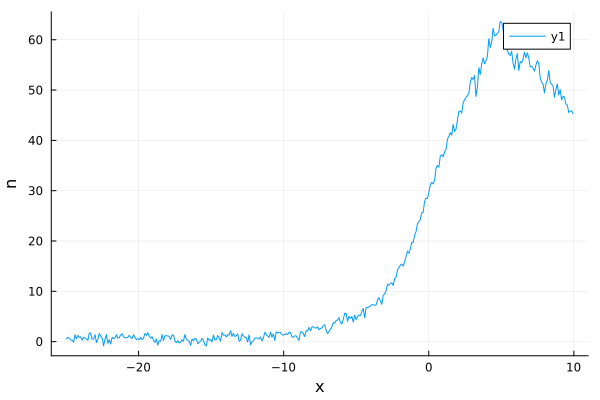

size x dat :(356,)
size(p0) : (1,)
lower_bounds = [174.0174287132106](1,)
upper_bounds = [522.0522861396317](1,)
3
size x_data : (356,)
size y_data : (356,)


In [13]:


function model_prel_mu(T,mu)
    #println(@sprintf "T = %.3f ,mu = %.3f " T mu)
    
    theta_discr_integrer = LinRange(-theta_max, theta_max, 600)
    mup = mu * kB
    beta = [-mup / (kB * T) 0 mass /(kB * T)]
    nu_discr = yangyang(gbar, beta, theta_discr)
    nu_fun = LinearInterpolation(theta_discr, nu_discr)
    thet2 , thet1 , npts_integral = theta_discr_integrer[1], theta_discr_integrer[600] , 600
    lam_discr = LinRange(thet2,thet1,npts_integral)
    nu_discr = nu_fun.(lam_discr)    
    densite = mass/hbar* charge_density(gbar, lam_discr, nu_discr, ones(size(lam_discr)[1]) )
    #println(densite)
    return densite
end

function model_mu(T,mu)
    
    OutDensite = 0*ones(size(T)[1])
    for i in 1:size(T)[1]
        #println(@sprintf "i =, T = %.3f ,mu = %.3f " i T[i] mu[i])
        OutDensite[i] = model_prel_mu(T[i],mu[i])
        #println("OutDensite = " ,OutDensite )
    end
    
    if 1 == 0                                                                    
        # Création du graphique
        p = plot(xlabel="mu", ylabel="densite", legend=:topright)
        # Ajout des points avec des marqueurs personnalisés
        plot!(p, mu, OutDensite, seriestype=:scatter, markersize=12, markerstrokewidth=2, markerstrokecolor=:DarkSlateGrey)
        # Affichage du graphique
        display(p)
    end
    
    #println(OutDensite)
    return OutDensite
    
end

if 1 == 0 
    T = LinRange(10, 600 , 3)
    Densite = 56.46504685*ones(size(T)[1])
    p0 = 50*ones(size(T)[1])
    fit = curve_fit(model_mu, T , Densite , p0 )
    
    mu = coef(fit)
    # Création du graphique
    p = plot(xlabel="mu", ylabel="densite", legend=:topright)
    # Ajout des points avec des marqueurs personnalisés
    plot!(p, mu, model_mu(T,mu), seriestype=:scatter, markersize=12, markerstrokewidth=2, markerstrokecolor=:DarkSlateGrey)
    # Affichage du graphique
    display(p)
    
    # Création du graphique
    p = plot(xlabel="T", ylabel="mu", legend=:topright)
    # Ajout des points avec des marqueurs personnalisés
    plot!(p, T, mu, seriestype=:scatter, markersize=12, markerstrokewidth=2, markerstrokecolor=:DarkSlateGrey)
    # Affichage du graphique
    display(p)
end 

function trier_x_et_y(x::Vector{T}, y::Vector{T}) where T
    # Obtenir les indices qui trient x en ordre croissant
    indices_tries = sortperm(x)
    
    # Trier x en ordre croissant
    x_tries = x[indices_tries]
    
    # Réorganiser y en conséquence
    y_tries = y[indices_tries]
    
    return x_tries, y_tries
end
;

fit_deformation = 1 == 1 
fit_expension = 0 == 1
if fit_deformation
    x_data = DONNEES[2][1]/18 
    y_data = DONNEES[2][2]
    mask = (x_data .> -25 ) .& (x_data .< 10)
    x_data = x_data[mask]
    y_data = y_data[mask]
elseif fit_expension 
    x_data = last(DONNEES)[1]./Taille 
    y_data = last(DONNEES)[2]
end

new_date = date_donnees
# Creer  le dossier
if !isdir(new_date)
    mkdir(new_date)
end

function model_fit_inhomo_un(x, p)
    T = p[1]
    n_p = 56.46504685
    mu = coef(curve_fit(model_mu, T*ones(1) , n_p*ones(1) , 30*ones(1) ))[1]  
    #mup = hbar * om_perp * (sqrt(1 + 4 * n_p * a3D) - 1)   #kg um^2.ms^-1
    println("mu = ", mu)
    println("T = ", T) 
    println("n_p , model_mu(T , mu)", model_mu(T*ones(1) , mu*ones(1)) ) 
    mup = mu*kB
    Taille = 24.780000000000086  #mu m 
    n_p = "None"
    theta_discr = LinRange(-theta_max, theta_max, npts)
    
    calcule_deformation = 1 == 1 # si on veut calculer les deformations
    fit_deformation = 1 == 1 # si on veut fiter la deformation
    
    calcule_expension = 0 == 1 # Si on veut fair les clacule GHD d'expension 
    fit_expension = 0 == 1 # si on veut faire un fit sur l'expension 

    mode = [calcule_deformation, fit_deformation, calcule_expension, fit_expension]
    x_simul, y_simul = pre_model_fit_inhomo(new_date, nom, theta_discr, n_p, mup, T, Taille, gbar , mode , "None" ,"None")    
    
    #x_simul,y_simul = Float64.(x) , Float64.(y_data)
    #x_simul, y_simul = trier_x_et_y(x_simul[:,1], y_simul[:,1])
    
    function density_fun(x)
        L = size(x)[1]
        y = ones(L)
        fun = LinearInterpolation(x_simul, y_simul)
        for i in 1:L
            if minimum(x_simul) < x[i] < maximum(x_simul) 
                y[i] = fun(x[i])
            elseif x[i]<minimum(x_simul)
                y[i] = fun(minimum(x_simul))
            else 
                y[i] = fun(maximum(x_simul))
            end
        end 
        return y
    end
    #density_fun = LinearInterpolation(x_simul, y_simul) 
    p = plot(xlabel="x/Taille", ylabel="n", legend=:topright)

    densi = density_fun(x)

    plot!(p, x,  y_data, label = "data")
    plot!(p, x_simul, y_simul , label = "simule")
    plot!(p, x, densi , label = "intepol")
    display(p)
    return densi
end 
    
using LsqFit


#x_data, y_data = trier_x_et_y(x_data[:,1], y_data[:,1])



# Tracer les données
scatter(x_data, y_data, label="Données", xlabel="x", ylabel="y", legend=:topleft)                                                                        
p = plot(xlabel="x", ylabel="n", legend=:topright)
plot!(p, x_data, y_data )
display(p)
                                                                        
println("size x dat :"  , size(x_data))
p0 = 348.0348574264212*ones(1) 
println( "size(p0) : " , size(p0))
# Bornes des paramètres
lower_bounds = 0.5 .* p0.*ones(size(p0)[1])
upper_bounds = 1.5 .* p0.*ones(size(p0)[1])
# Afficher les bornes
println("lower_bounds = ", lower_bounds , size(lower_bounds))
println("upper_bounds = ", upper_bounds, size(upper_bounds))
# Effectuer l'ajustement avec bornes
println("3")
println("size x_data : " , size(x_data))
println("size y_data : " , size(y_data))    
#fit = curve_fit(model_fit_inhomo_un, x_data, y_data , p0 ) 




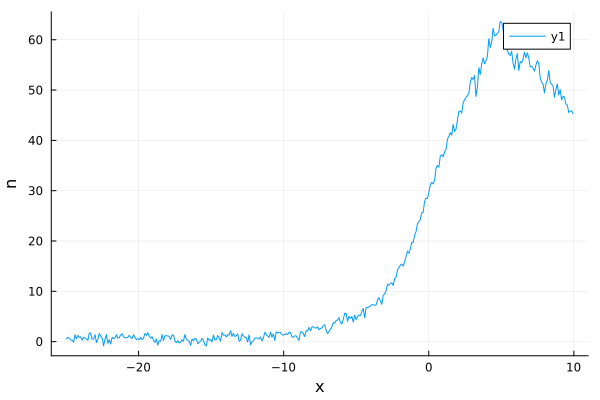

size x dat :(356,)
size(p0) : (1,)
lower_bounds = [50.0](1,)
upper_bounds = [150.0](1,)
3
size x_data : (356,)
size y_data : (356,)
mu = 59.24928388361869
mu = 65.22418406647107
T = 100.0
n_p , model_mu(T , mu) 56.46504684999994
saved : 2024-04-24/theta_discr_ih1.npz
  0.021298 seconds (6.93 k allocations: 12.249 MiB)
saved : 2024-04-24/nu_discr_ih1_65.224_100.000.npz


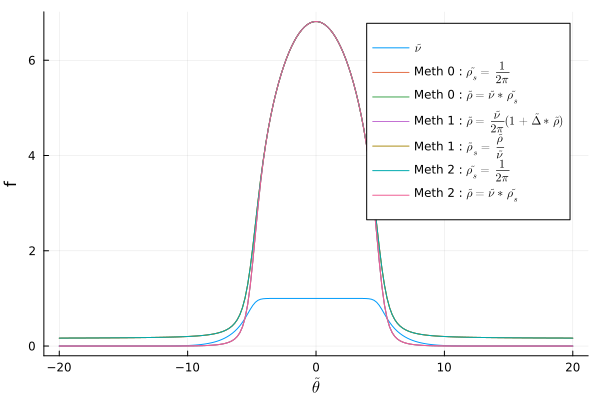

  0.001653 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.224_100.000.npz
  0.000025 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.224_100.000.npz
  0.002682 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_65.224_100.000.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.224_100.000.npz


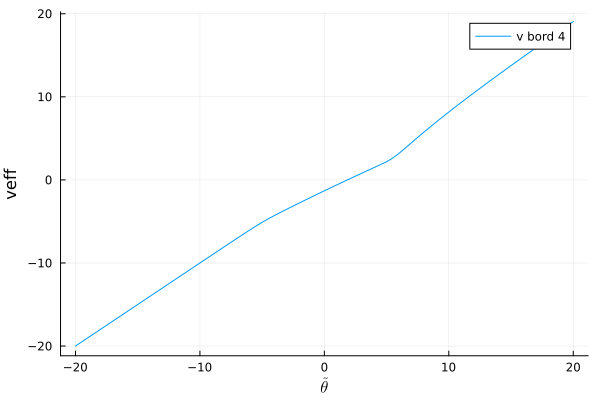

  0.179267 seconds (2.32 k allocations: 137.763 MiB, 4.36% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.224_100.000.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.224_100.000.npz
theta_star = 1.626 
  0.001600 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.224_100.000.npz
  0.000016 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.224_100.000.npz


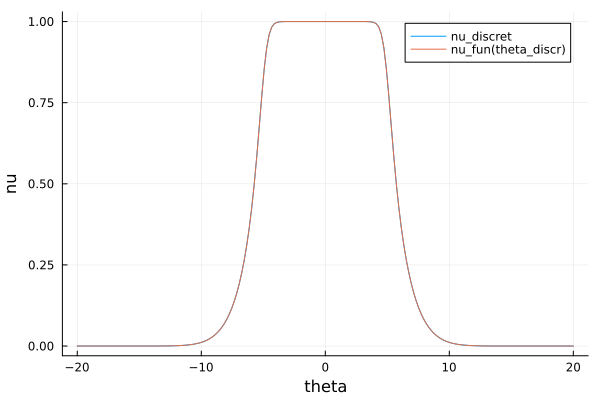

la densité haute est : 56.46504684999994
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.224_100.000_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.224_100.000_2.000_0.000.npz
la densité haute est : 56.46504684999994
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.224_100.000_2.000_veff_bord.npz


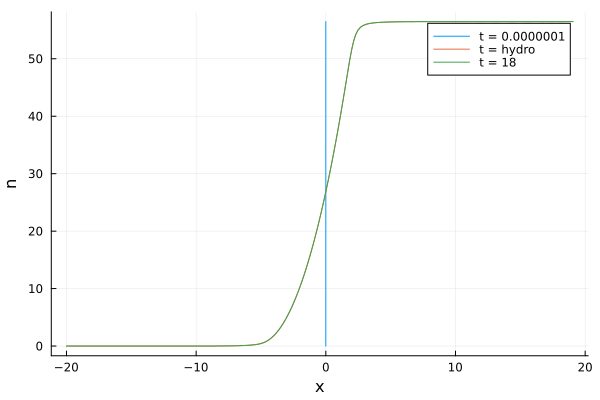

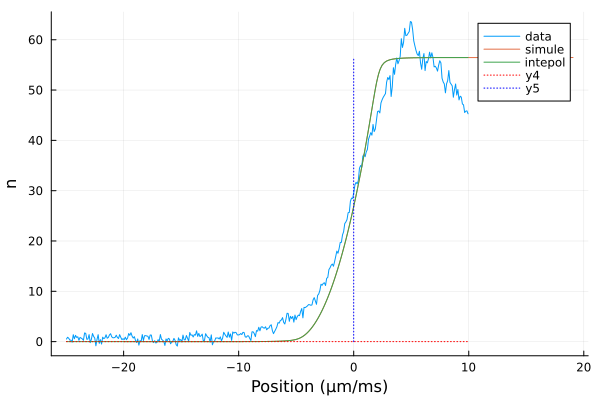

mu = 59.24928388361869
mu = 65.22418406647107
T = 100.0
n_p , model_mu(T , mu) 56.46504684999994
saved : 2024-04-24/theta_discr_ih1.npz
  0.020433 seconds (6.93 k allocations: 12.249 MiB)
saved : 2024-04-24/nu_discr_ih1_65.224_100.000.npz


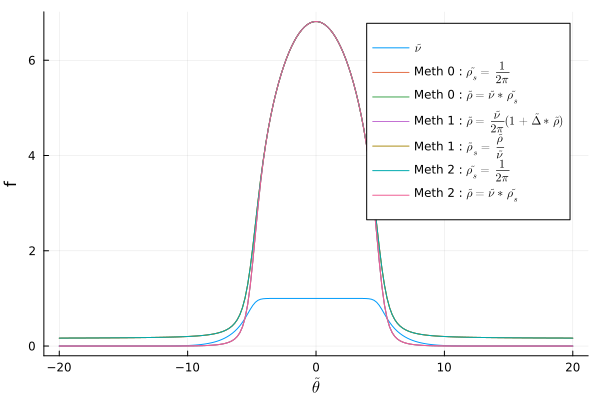

  0.001567 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.224_100.000.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.224_100.000.npz
  0.008198 seconds (23 allocations: 2.149 MiB, 66.65% gc time)
saved : 2024-04-24/veff_discr_ih1_65.224_100.000.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.224_100.000.npz


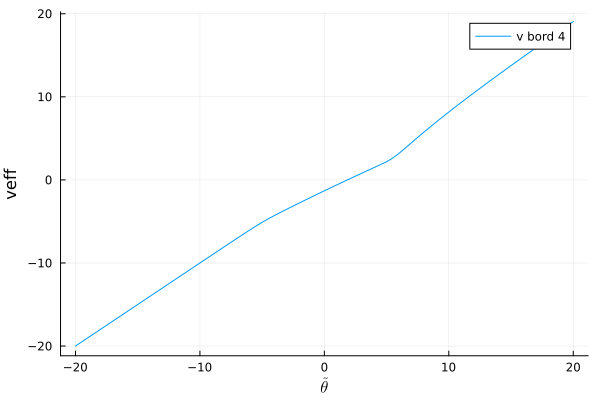

  0.176834 seconds (2.32 k allocations: 137.763 MiB, 4.90% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.224_100.000.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.224_100.000.npz
theta_star = 1.626 
  0.001693 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.224_100.000.npz
  0.000018 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.224_100.000.npz


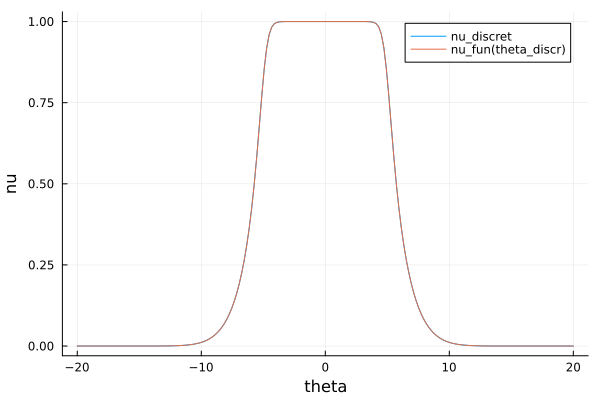

la densité haute est : 56.46504684999994
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.224_100.000_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.224_100.000_2.000_0.000.npz
la densité haute est : 56.46504684999994
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.224_100.000_2.000_veff_bord.npz


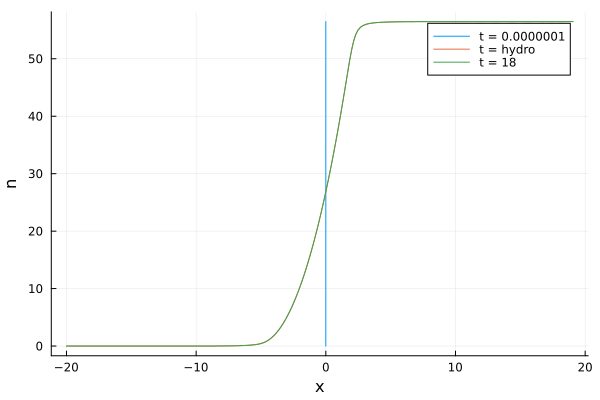

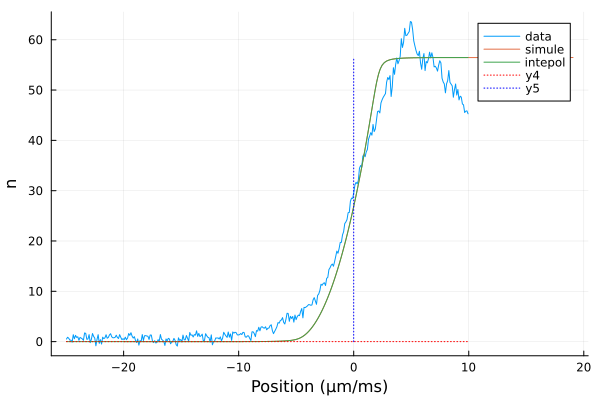

mu = 59.24928388361869
mu = 65.2241838664982
T = 100.00060554544524
n_p , model_mu(T , mu) 56.46504685000001
saved : 2024-04-24/theta_discr_ih1.npz
  0.020540 seconds (6.93 k allocations: 12.249 MiB)
saved : 2024-04-24/nu_discr_ih1_65.224_100.001.npz


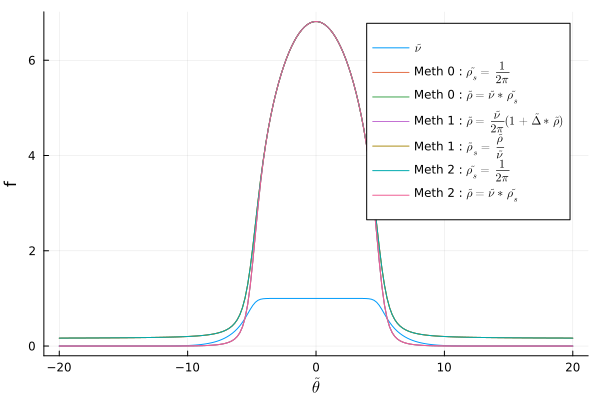

  0.001570 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.224_100.001.npz
  0.000018 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.224_100.001.npz
  0.008050 seconds (23 allocations: 2.149 MiB, 66.17% gc time)
saved : 2024-04-24/veff_discr_ih1_65.224_100.001.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.224_100.001.npz


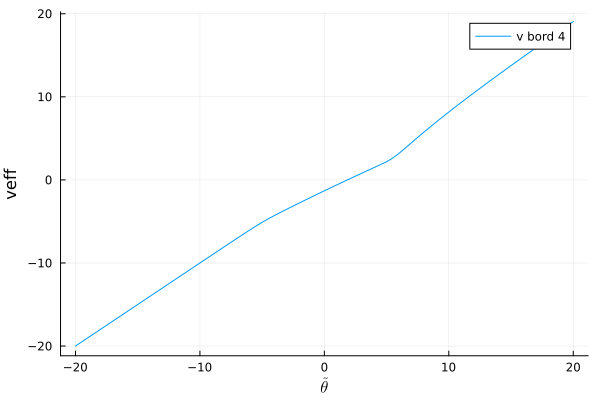

  0.176268 seconds (2.32 k allocations: 137.763 MiB, 4.84% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.224_100.001.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.224_100.001.npz
theta_star = 1.626 
  0.001558 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.224_100.001.npz
  0.000016 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.224_100.001.npz


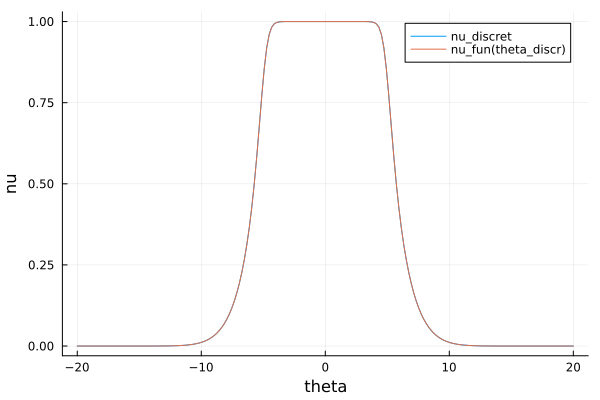

la densité haute est : 56.46504685000001
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.224_100.001_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.224_100.001_2.000_0.000.npz
la densité haute est : 56.46504685000001
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.224_100.001_2.000_veff_bord.npz


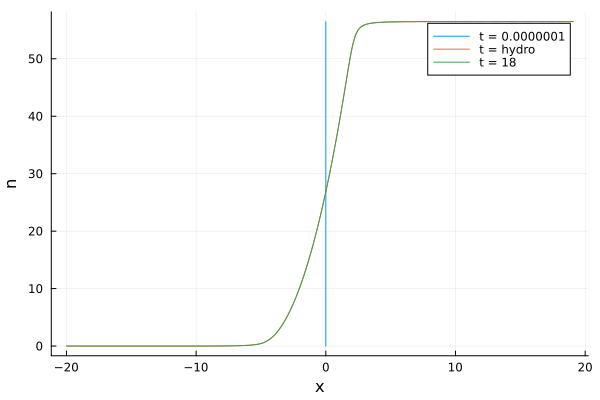

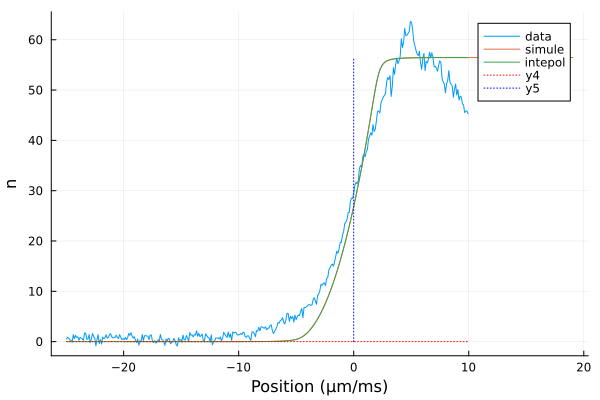

mu = 59.24928388361869
mu = 65.22418426645224
T = 99.99939445455476
n_p , model_mu(T , mu) 56.46504685000001
saved : 2024-04-24/theta_discr_ih1.npz
  0.020416 seconds (6.93 k allocations: 12.249 MiB)
saved : 2024-04-24/nu_discr_ih1_65.224_99.999.npz


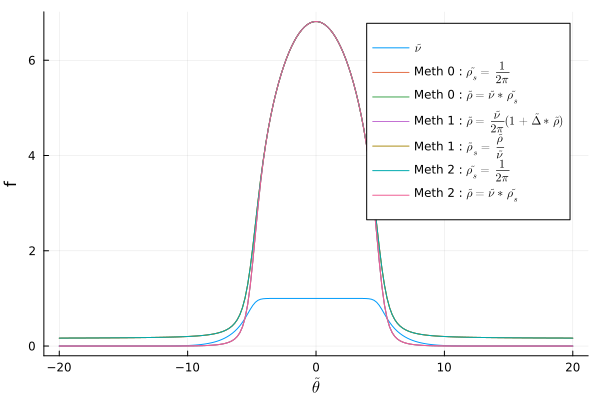

  0.001578 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.224_99.999.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.224_99.999.npz
  0.008068 seconds (23 allocations: 2.149 MiB, 66.05% gc time)
saved : 2024-04-24/veff_discr_ih1_65.224_99.999.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.224_99.999.npz


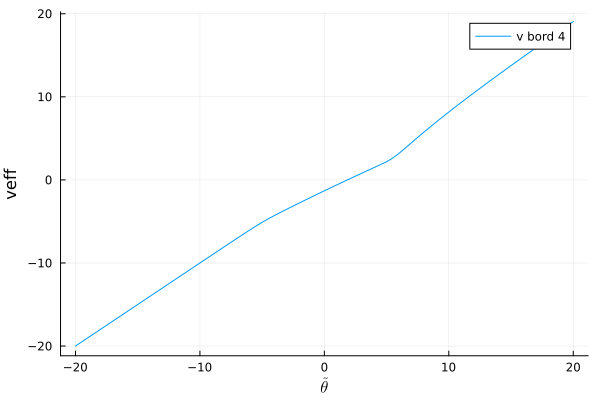

  0.176063 seconds (2.32 k allocations: 137.763 MiB, 4.98% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.224_99.999.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.224_99.999.npz
theta_star = 1.626 
  0.001547 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.224_99.999.npz
  0.000015 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.224_99.999.npz


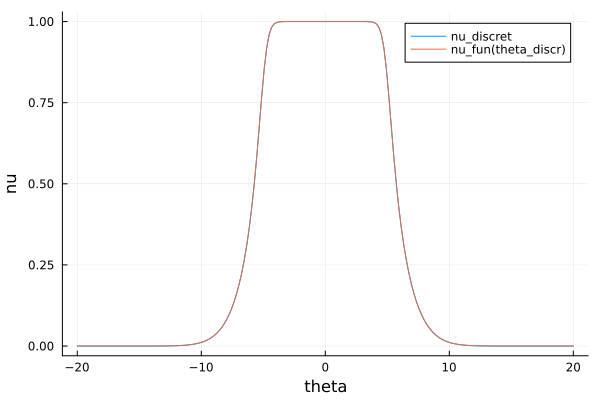

la densité haute est : 56.46504685000001
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.224_99.999_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.224_99.999_2.000_0.000.npz
la densité haute est : 56.46504685000001
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.224_99.999_2.000_veff_bord.npz


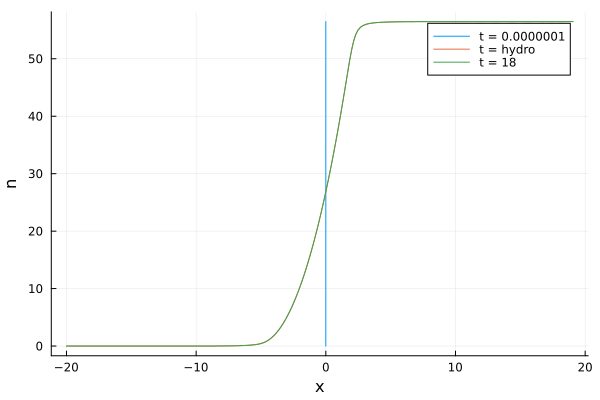

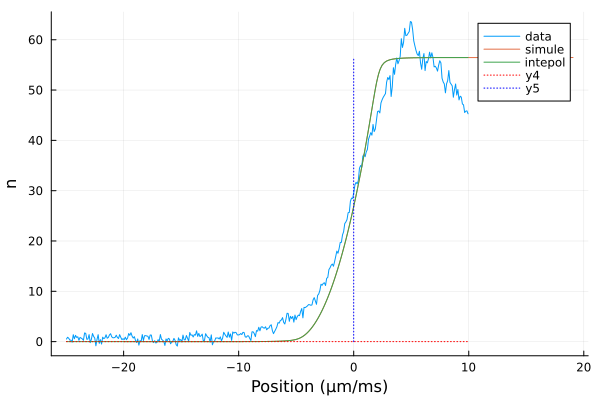

mu = 59.24928388361869
mu = 65.23451510507256
T = 148.40299761931107
n_p , model_mu(T , mu) 56.46504684999999
saved : 2024-04-24/theta_discr_ih1.npz
  0.018214 seconds (6.70 k allocations: 11.849 MiB)
saved : 2024-04-24/nu_discr_ih1_65.235_148.403.npz


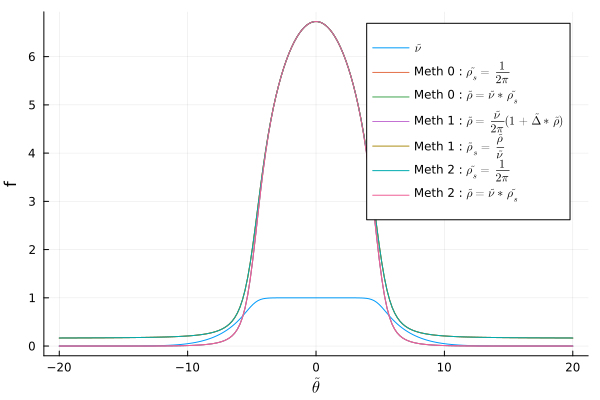

  0.001547 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.235_148.403.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.235_148.403.npz
  0.002659 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_65.235_148.403.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.235_148.403.npz


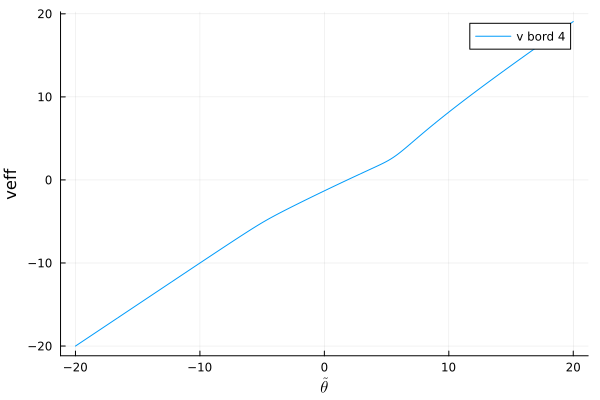

  0.142816 seconds (2.32 k allocations: 137.763 MiB, 6.13% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.235_148.403.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.235_148.403.npz
theta_star = 1.629 
  0.001294 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.235_148.403.npz
  0.000016 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.235_148.403.npz


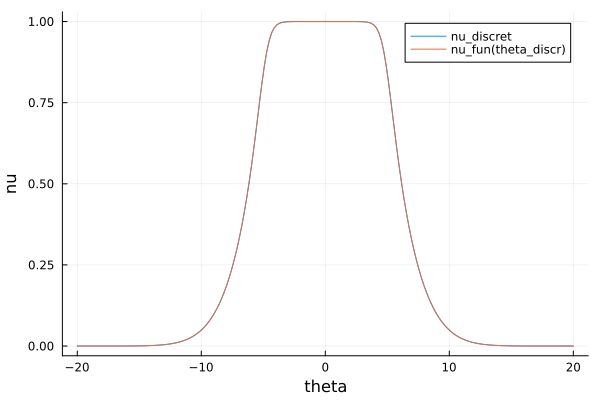

la densité haute est : 56.46504684999999
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.235_148.403_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.235_148.403_2.000_0.000.npz
la densité haute est : 56.46504684999999
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.235_148.403_2.000_veff_bord.npz


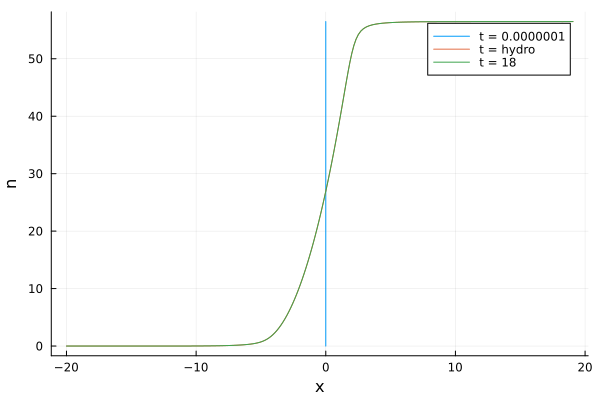

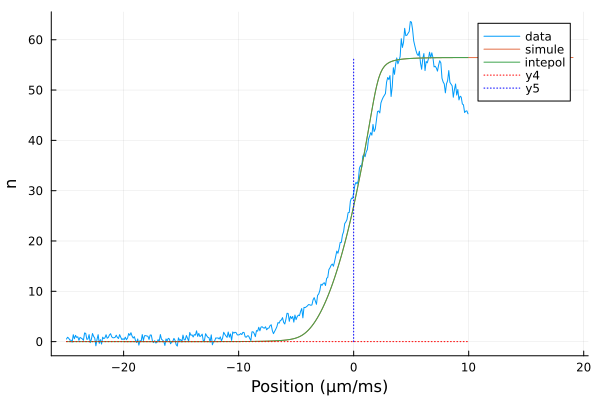

mu = 59.24928388361869
mu = 65.23451510507256
T = 148.40299761931107
n_p , model_mu(T , mu) 56.46504684999999
saved : 2024-04-24/theta_discr_ih1.npz
  0.018636 seconds (6.70 k allocations: 11.849 MiB)
saved : 2024-04-24/nu_discr_ih1_65.235_148.403.npz


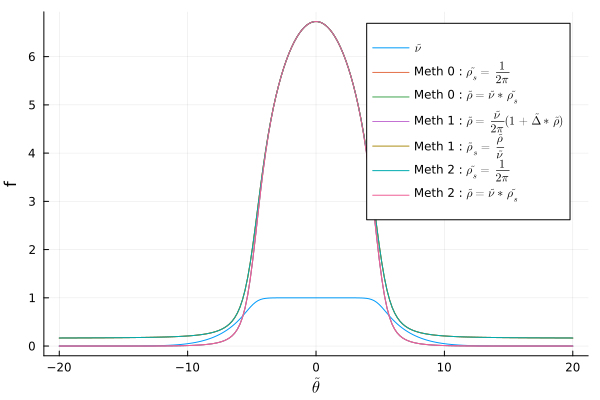

  0.001307 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.235_148.403.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.235_148.403.npz
  0.002150 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_65.235_148.403.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.235_148.403.npz


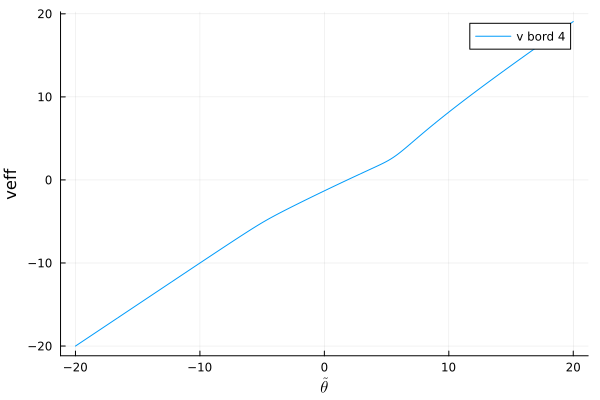

  0.143250 seconds (2.32 k allocations: 137.763 MiB, 6.16% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.235_148.403.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.235_148.403.npz
theta_star = 1.629 
  0.001304 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.235_148.403.npz
  0.000016 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.235_148.403.npz


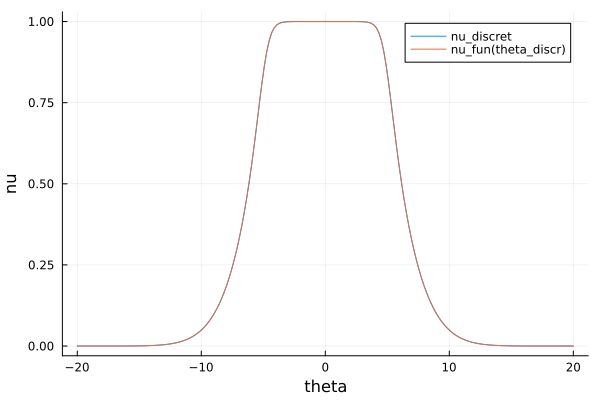

la densité haute est : 56.46504684999999
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.235_148.403_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.235_148.403_2.000_0.000.npz
la densité haute est : 56.46504684999999
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.235_148.403_2.000_veff_bord.npz


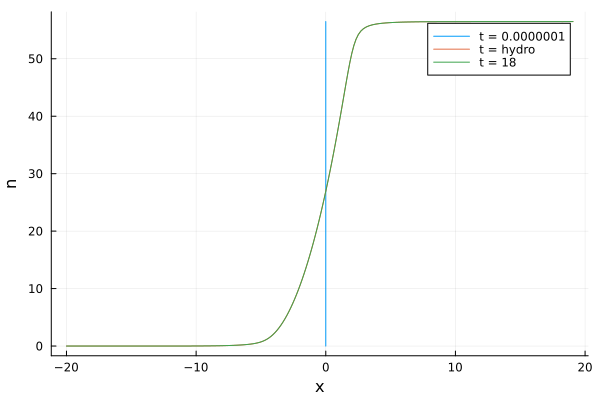

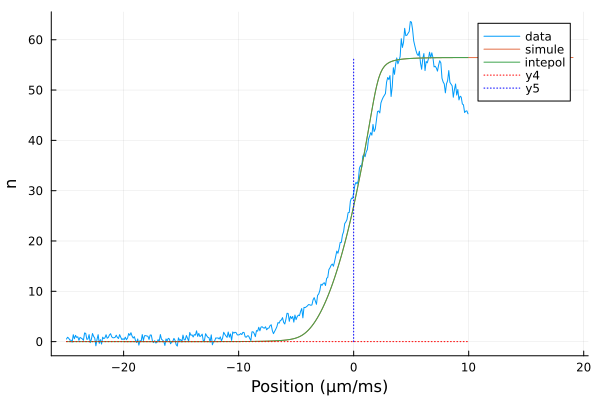

mu = 59.24928388361869
mu = 65.23451582049044
T = 148.40389626690376
n_p , model_mu(T , mu) 56.465046849999965
saved : 2024-04-24/theta_discr_ih1.npz
  0.018288 seconds (6.70 k allocations: 11.849 MiB)
saved : 2024-04-24/nu_discr_ih1_65.235_148.404.npz


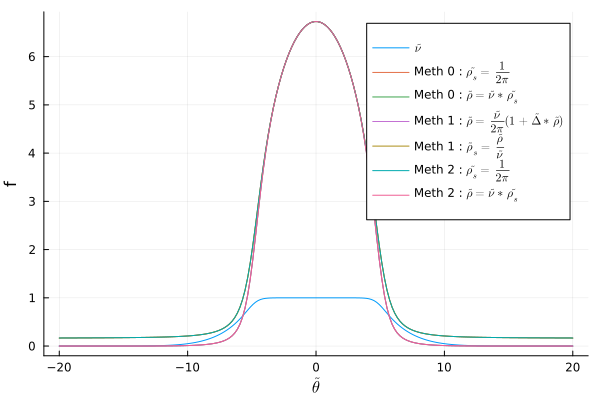

  0.001567 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.235_148.404.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.235_148.404.npz
  0.002687 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_65.235_148.404.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.235_148.404.npz


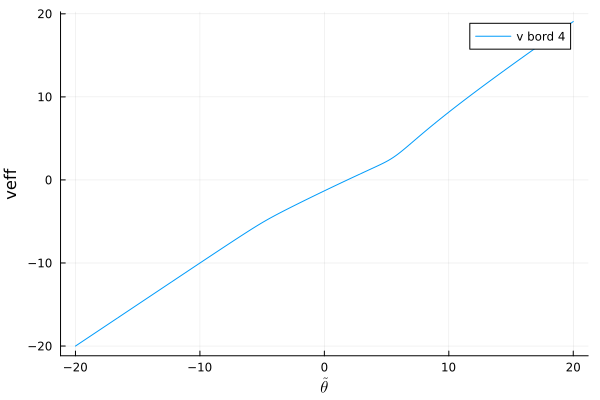

  0.177029 seconds (2.32 k allocations: 137.763 MiB, 4.42% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.235_148.404.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.235_148.404.npz
theta_star = 1.629 
  0.001572 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.235_148.404.npz
  0.000015 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.235_148.404.npz


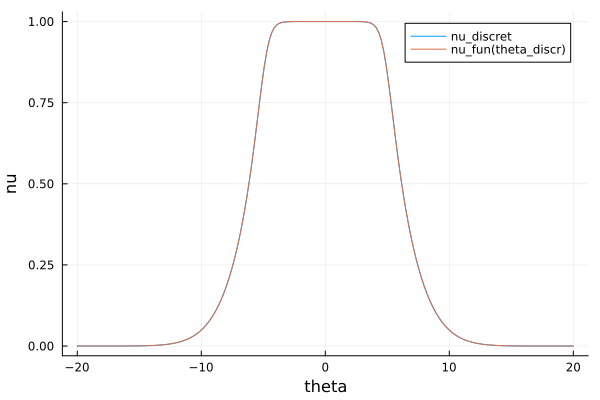

la densité haute est : 56.465046849999965
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.235_148.404_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.235_148.404_2.000_0.000.npz
la densité haute est : 56.465046849999965
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.235_148.404_2.000_veff_bord.npz


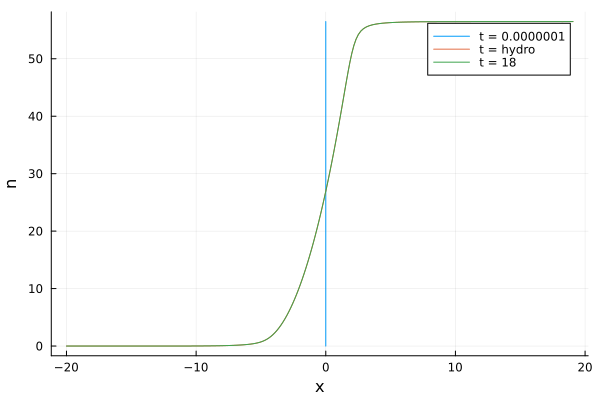

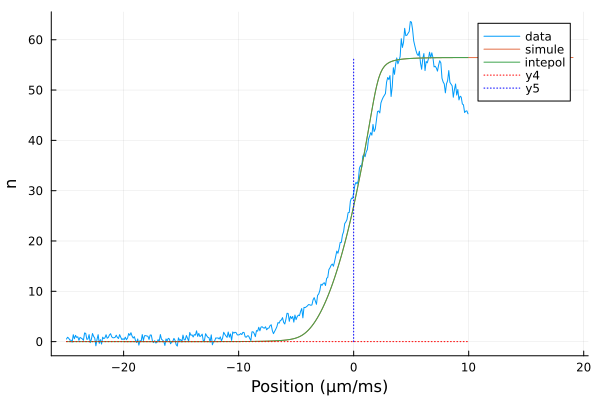

mu = 59.24928388361869
mu = 65.23451438967639
T = 148.40209897171837
n_p , model_mu(T , mu) 56.46504685000002
saved : 2024-04-24/theta_discr_ih1.npz
  0.020562 seconds (6.70 k allocations: 11.849 MiB, 11.40% gc time)
saved : 2024-04-24/nu_discr_ih1_65.235_148.402.npz


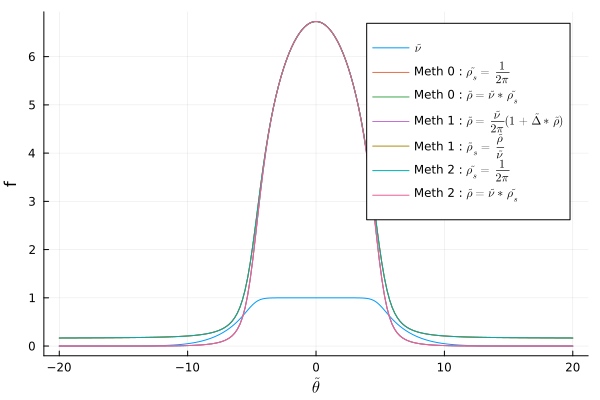

  0.001588 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.235_148.402.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.235_148.402.npz
  0.002683 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_65.235_148.402.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.235_148.402.npz


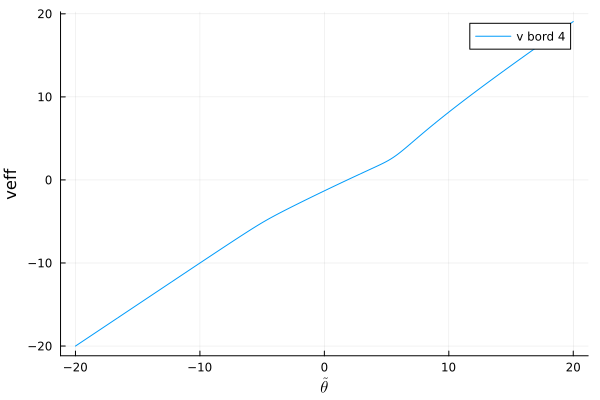

  0.172982 seconds (2.25 k allocations: 133.458 MiB, 5.04% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.235_148.402.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.235_148.402.npz
theta_star = 1.629 
  0.001582 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.235_148.402.npz
  0.000019 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.235_148.402.npz


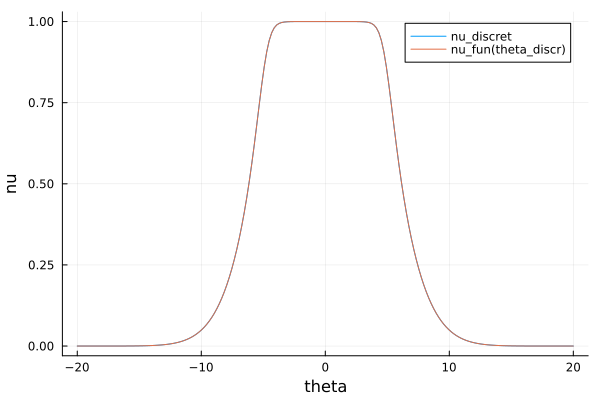

la densité haute est : 56.46504685000002
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.235_148.402_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.235_148.402_2.000_0.000.npz
la densité haute est : 56.46504685000002
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.235_148.402_2.000_veff_bord.npz


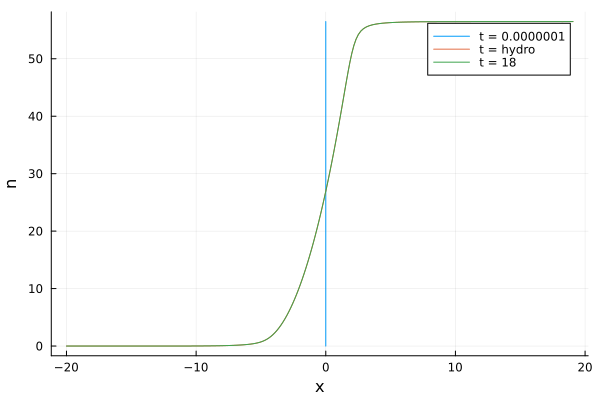

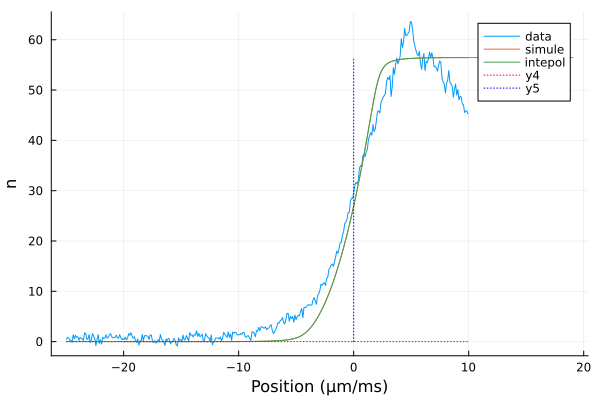

mu = 59.24928388361869
mu = 65.70264205464701
T = 375.6213735491201
n_p , model_mu(T , mu) 56.46504685000008
saved : 2024-04-24/theta_discr_ih1.npz
  0.019565 seconds (5.73 k allocations: 10.180 MiB, 16.40% gc time)
saved : 2024-04-24/nu_discr_ih1_65.703_375.621.npz


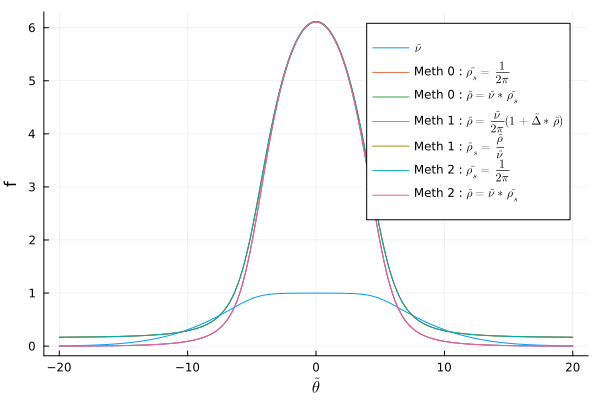

  0.001564 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.703_375.621.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.703_375.621.npz
  0.002681 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_65.703_375.621.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.703_375.621.npz


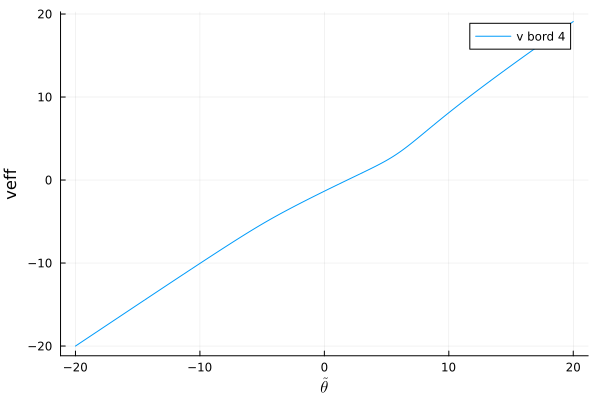

  0.178543 seconds (2.32 k allocations: 137.763 MiB, 4.94% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.703_375.621.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.703_375.621.npz
theta_star = 1.641 
  0.001588 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.703_375.621.npz
  0.000018 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.703_375.621.npz


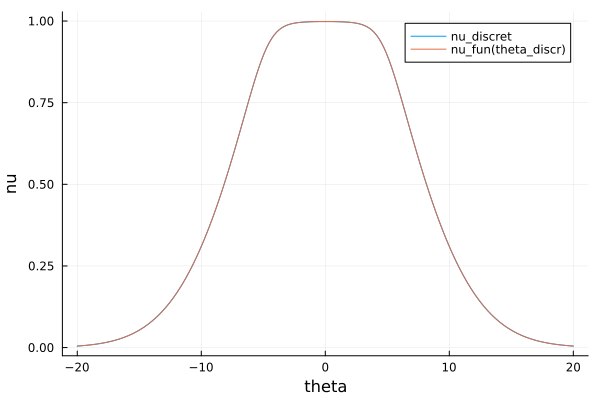

la densité haute est : 56.46504685000008
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.703_375.621_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.703_375.621_2.000_0.000.npz
la densité haute est : 56.46504685000008
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.703_375.621_2.000_veff_bord.npz


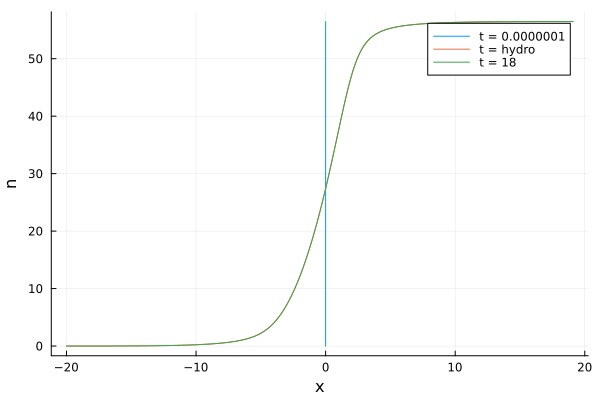

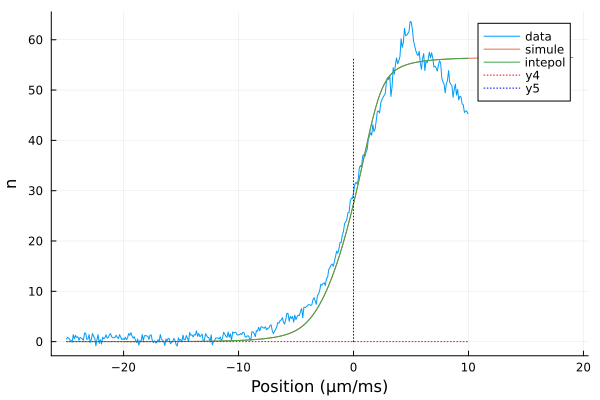

mu = 59.24928388361869
mu = 65.70264205464701
T = 375.6213735491201
n_p , model_mu(T , mu) 56.46504685000008
saved : 2024-04-24/theta_discr_ih1.npz
  0.019903 seconds (5.73 k allocations: 10.180 MiB, 16.25% gc time)
saved : 2024-04-24/nu_discr_ih1_65.703_375.621.npz


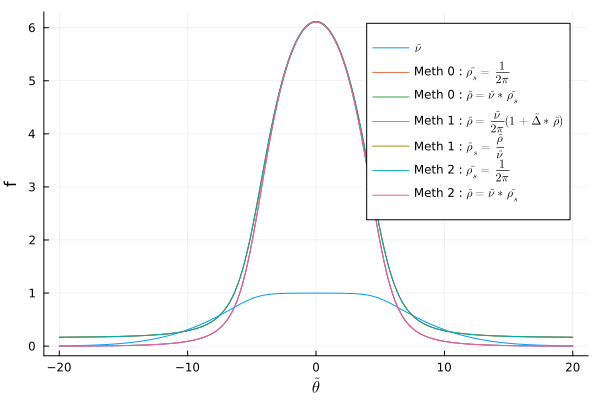

  0.001572 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.703_375.621.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.703_375.621.npz
  0.002727 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_65.703_375.621.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.703_375.621.npz


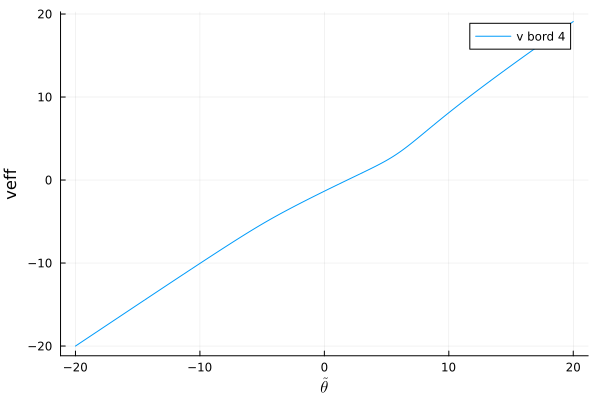

  0.179209 seconds (2.32 k allocations: 137.763 MiB, 4.98% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.703_375.621.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.703_375.621.npz
theta_star = 1.641 
  0.001579 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.703_375.621.npz
  0.000017 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.703_375.621.npz


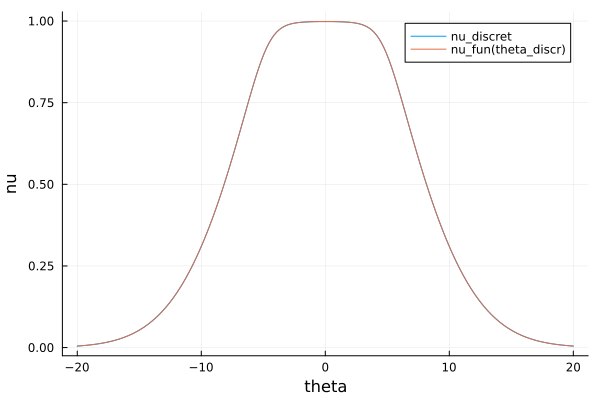

la densité haute est : 56.46504685000008
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.703_375.621_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.703_375.621_2.000_0.000.npz
la densité haute est : 56.46504685000008
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.703_375.621_2.000_veff_bord.npz


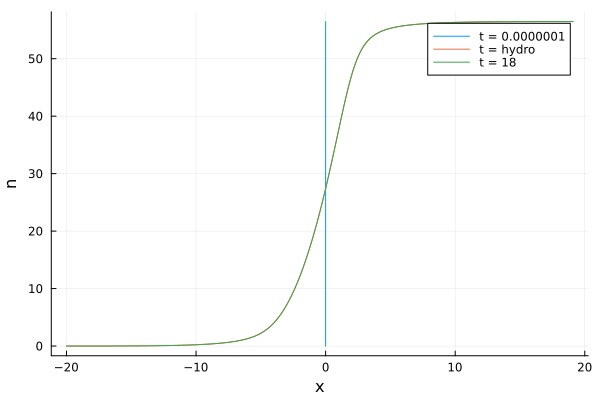

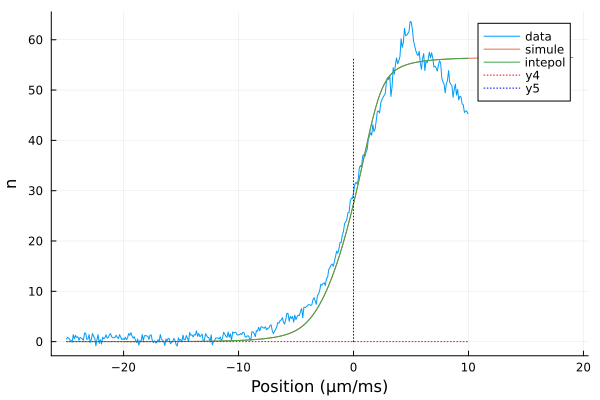

mu = 59.24928388361869
mu = 65.70264088951896
T = 375.623648107239
n_p , model_mu(T , mu) 56.46504685000002
saved : 2024-04-24/theta_discr_ih1.npz
  0.019449 seconds (5.73 k allocations: 10.180 MiB, 16.05% gc time)
saved : 2024-04-24/nu_discr_ih1_65.703_375.624.npz


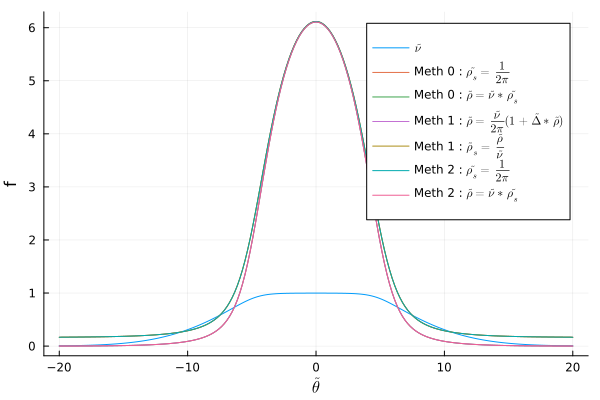

  0.001602 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.703_375.624.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.703_375.624.npz
  0.002640 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_65.703_375.624.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.703_375.624.npz


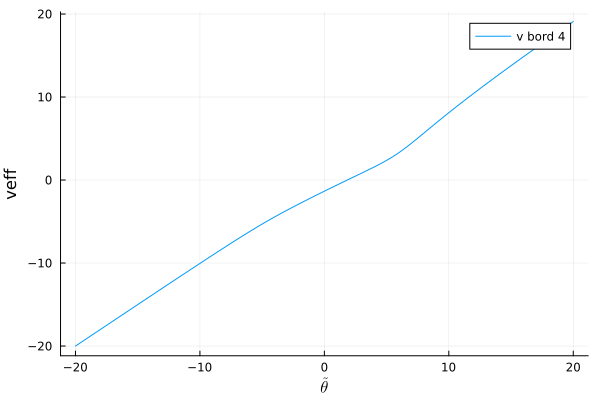

  0.178567 seconds (2.32 k allocations: 137.763 MiB, 4.99% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.703_375.624.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.703_375.624.npz
theta_star = 1.641 
  0.001582 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.703_375.624.npz
  0.000018 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.703_375.624.npz


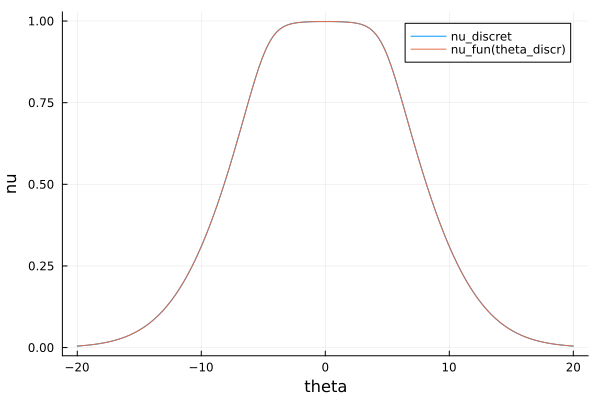

la densité haute est : 56.46504685000002
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.703_375.624_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.703_375.624_2.000_0.000.npz
la densité haute est : 56.46504685000002
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.703_375.624_2.000_veff_bord.npz


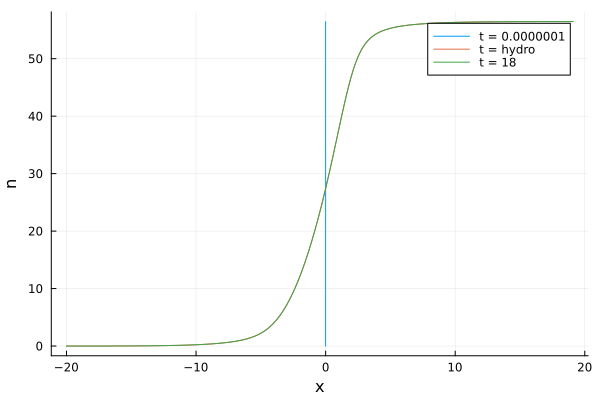

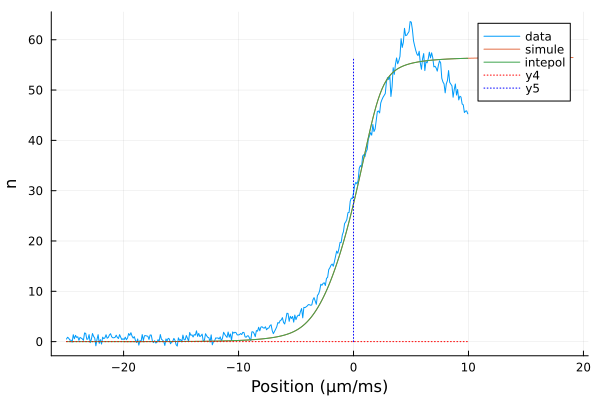

mu = 59.24928388361869
mu = 65.70264321948936
T = 375.61909899100124
n_p , model_mu(T , mu) 56.465046850000014
saved : 2024-04-24/theta_discr_ih1.npz
  0.019896 seconds (5.73 k allocations: 10.180 MiB, 15.27% gc time)
saved : 2024-04-24/nu_discr_ih1_65.703_375.619.npz


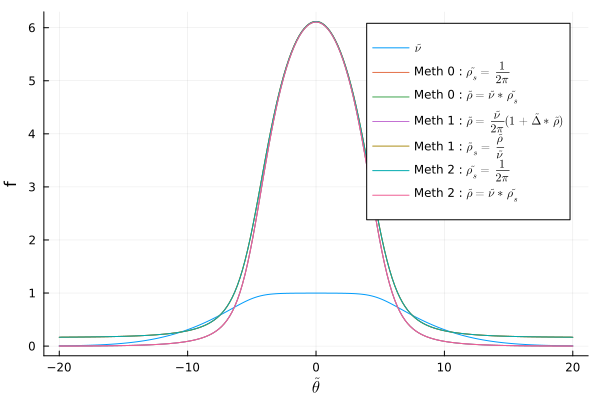

  0.001625 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_65.703_375.619.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_65.703_375.619.npz
  0.002675 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_65.703_375.619.npz
saved : 2024-04-24/veff_bord_discr_ih1_65.703_375.619.npz


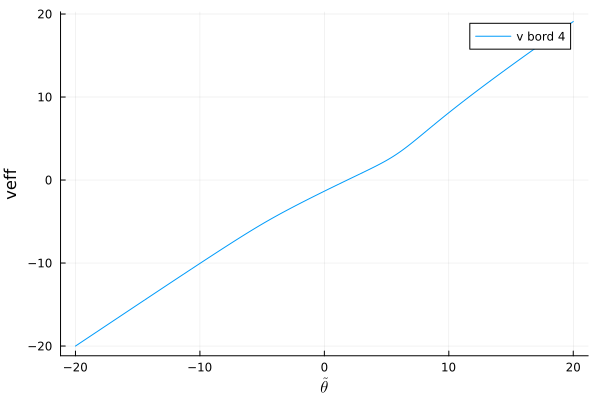

  0.177786 seconds (2.32 k allocations: 137.763 MiB, 5.05% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_65.703_375.619.npz
  0.000008 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_65.703_375.619.npz
theta_star = 1.641 
  0.001597 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_65.703_375.619.npz
  0.000018 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_65.703_375.619.npz


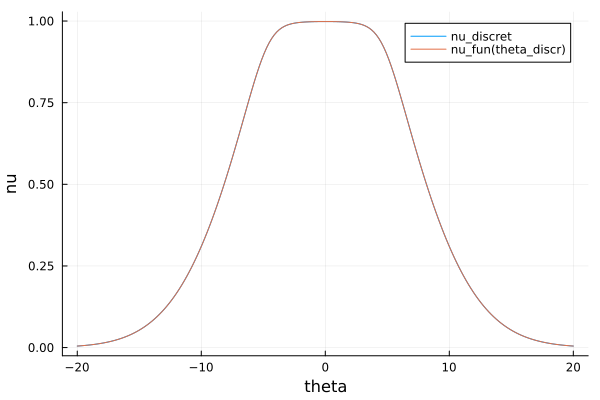

la densité haute est : 56.465046850000014
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.703_375.619_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_65.703_375.619_2.000_0.000.npz
la densité haute est : 56.465046850000014
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_65.703_375.619_2.000_veff_bord.npz


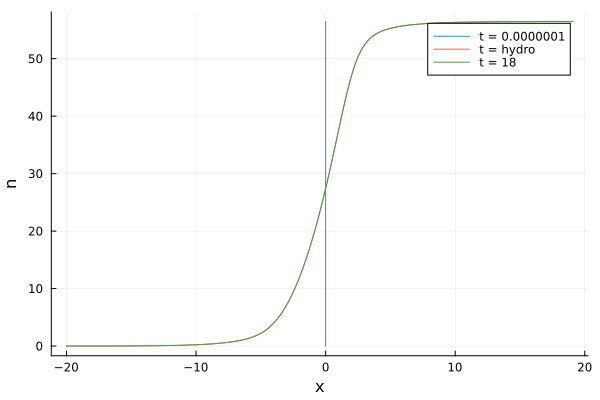

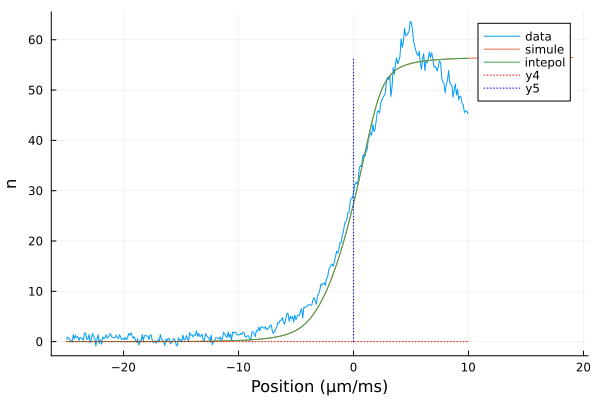

mu = 59.24928388361869
mu = 64.80577987331094
T = 535.5986875852122
n_p , model_mu(T , mu) 56.46504685000002
saved : 2024-04-24/theta_discr_ih1.npz
  0.014583 seconds (5.20 k allocations: 9.270 MiB)
saved : 2024-04-24/nu_discr_ih1_64.806_535.599.npz


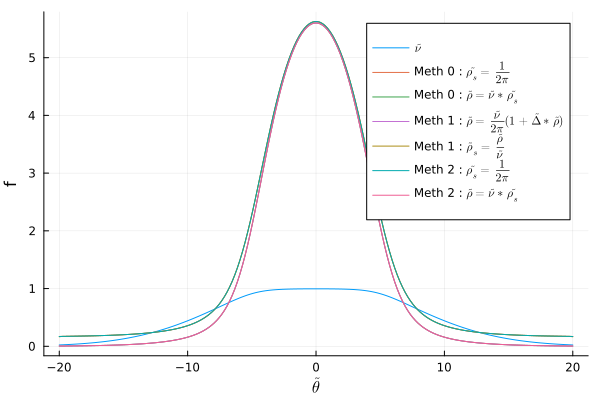

  0.001624 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.806_535.599.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.806_535.599.npz
  0.002660 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.806_535.599.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.806_535.599.npz


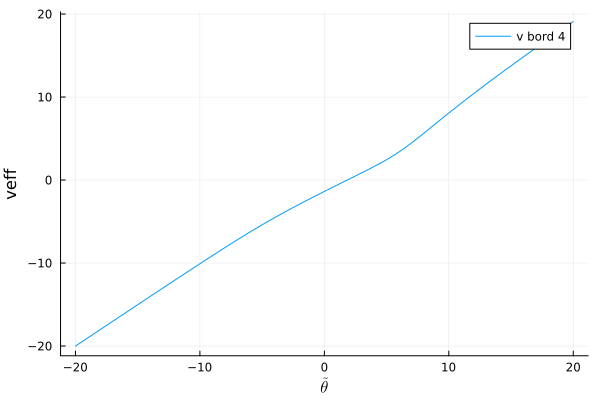

  0.176091 seconds (2.32 k allocations: 137.763 MiB, 4.43% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.806_535.599.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.806_535.599.npz
theta_star = 1.643 
  0.001568 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.806_535.599.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.806_535.599.npz


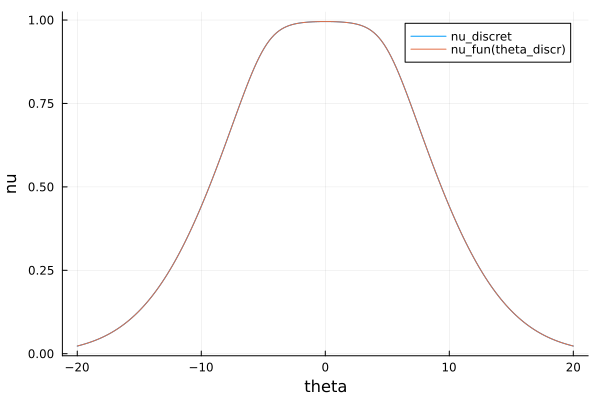

la densité haute est : 56.46504685000002
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.806_535.599_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.806_535.599_2.000_0.000.npz
la densité haute est : 56.46504685000002
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.806_535.599_2.000_veff_bord.npz


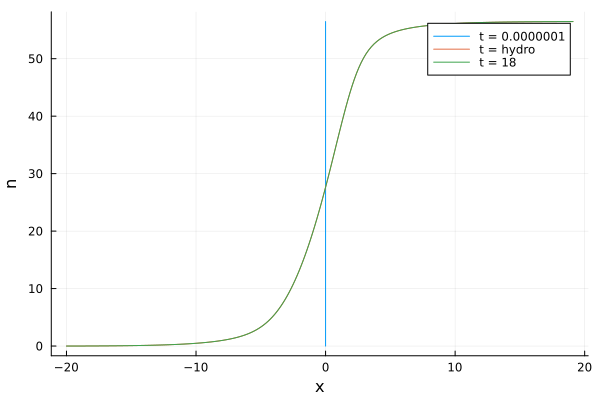

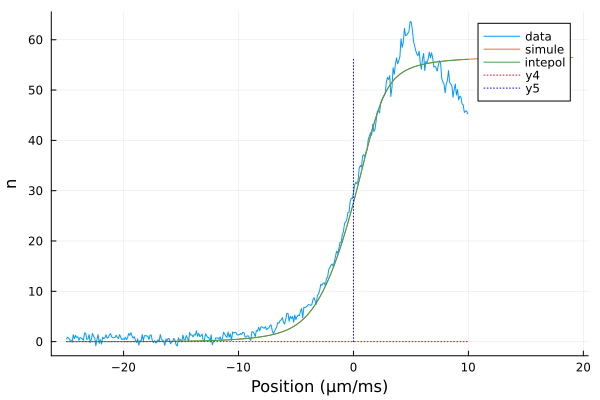

mu = 59.24928388361869
mu = 64.80577987331094
T = 535.5986875852122
n_p , model_mu(T , mu) 56.46504685000002
saved : 2024-04-24/theta_discr_ih1.npz
  0.014802 seconds (5.20 k allocations: 9.270 MiB)
saved : 2024-04-24/nu_discr_ih1_64.806_535.599.npz


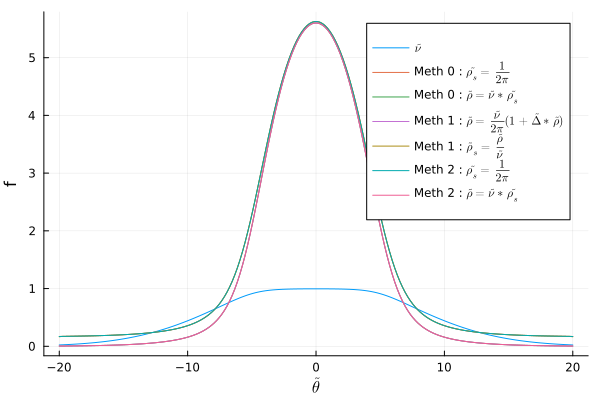

  0.001611 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.806_535.599.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.806_535.599.npz
  0.002708 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.806_535.599.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.806_535.599.npz


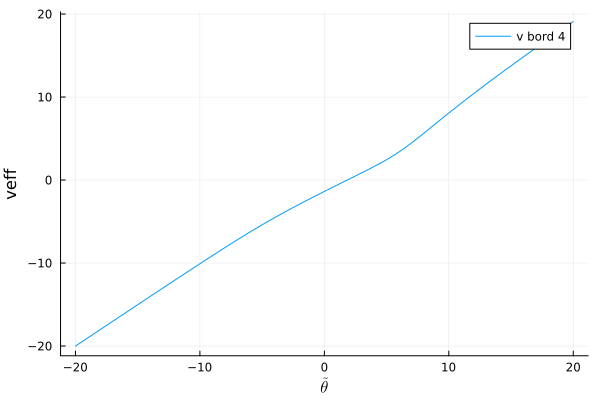

  0.177769 seconds (2.32 k allocations: 137.763 MiB, 5.05% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.806_535.599.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.806_535.599.npz
theta_star = 1.643 
  0.001572 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.806_535.599.npz
  0.000017 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.806_535.599.npz


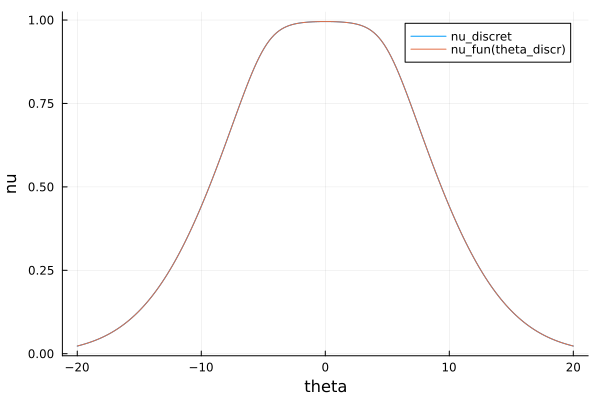

la densité haute est : 56.46504685000002
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.806_535.599_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.806_535.599_2.000_0.000.npz
la densité haute est : 56.46504685000002
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.806_535.599_2.000_veff_bord.npz


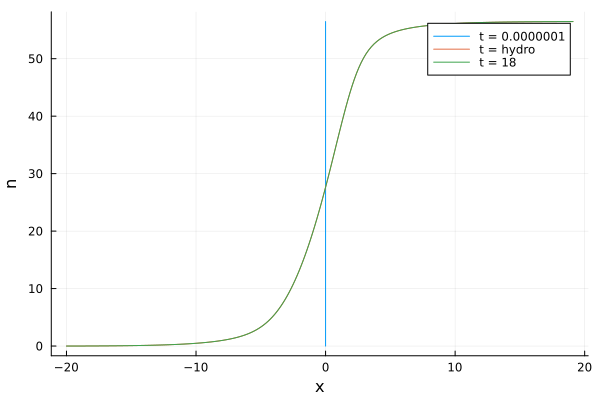

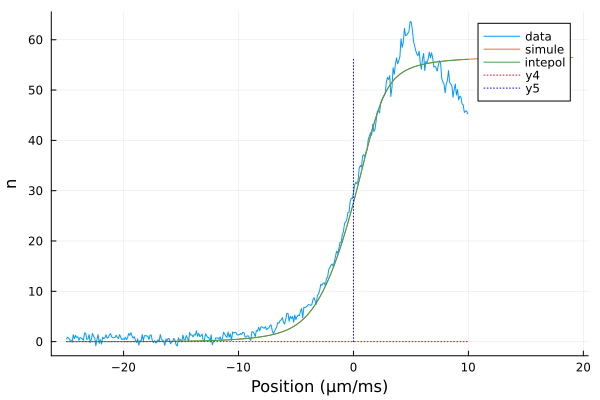

mu = 59.24928388361869
mu = 64.80574404662676
T = 535.6019308786697
n_p , model_mu(T , mu) 56.46504684999993
saved : 2024-04-24/theta_discr_ih1.npz
  0.016611 seconds (5.20 k allocations: 9.270 MiB)
saved : 2024-04-24/nu_discr_ih1_64.806_535.602.npz


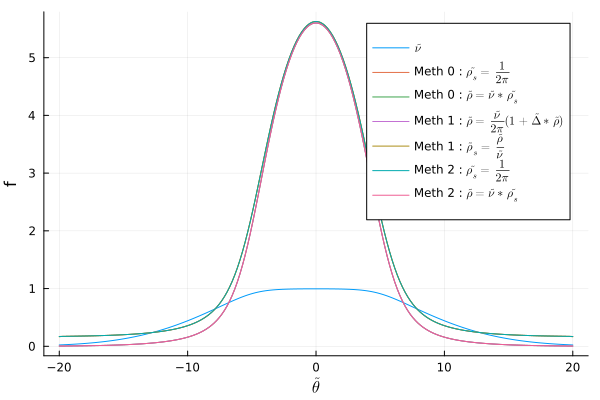

  0.001593 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.806_535.602.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.806_535.602.npz
  0.002662 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.806_535.602.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.806_535.602.npz


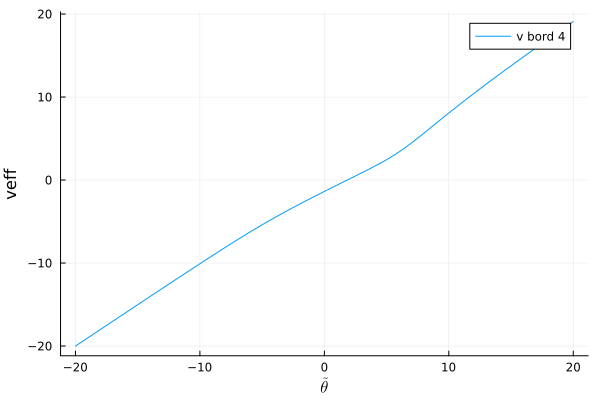

  0.177325 seconds (2.32 k allocations: 137.763 MiB, 5.13% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.806_535.602.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.806_535.602.npz
theta_star = 1.643 
  0.001575 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.806_535.602.npz
  0.000017 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.806_535.602.npz


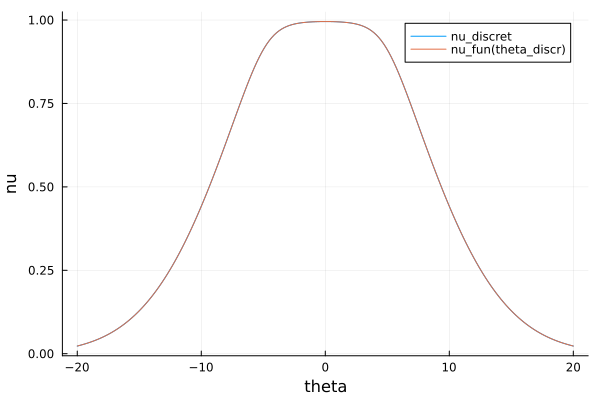

la densité haute est : 56.46504684999993
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.806_535.602_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.806_535.602_2.000_0.000.npz
la densité haute est : 56.46504684999993
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.806_535.602_2.000_veff_bord.npz


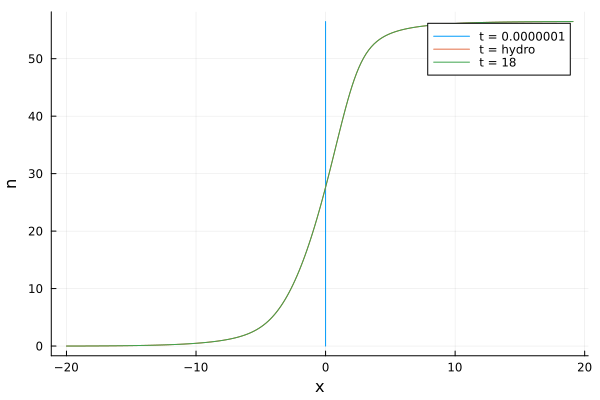

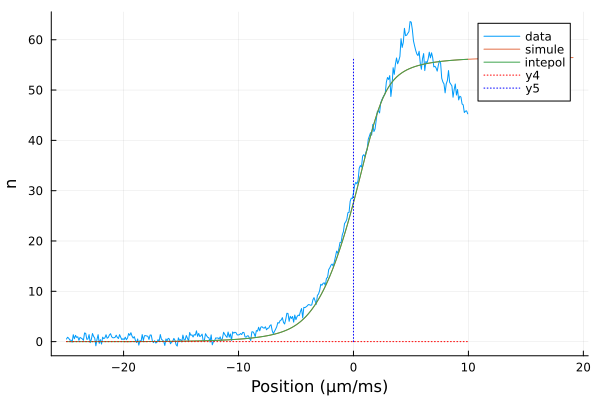

mu = 59.24928388361869
mu = 64.80581569926555
T = 535.5954442917548
n_p , model_mu(T , mu) 56.46504685000001
saved : 2024-04-24/theta_discr_ih1.npz
  0.014835 seconds (5.20 k allocations: 9.270 MiB)
saved : 2024-04-24/nu_discr_ih1_64.806_535.595.npz


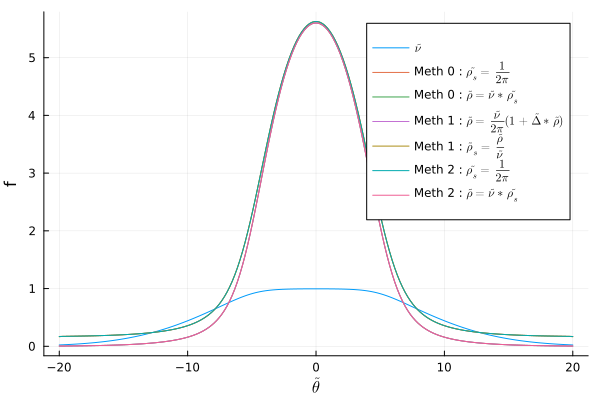

  0.001593 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.806_535.595.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.806_535.595.npz
  0.002687 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.806_535.595.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.806_535.595.npz


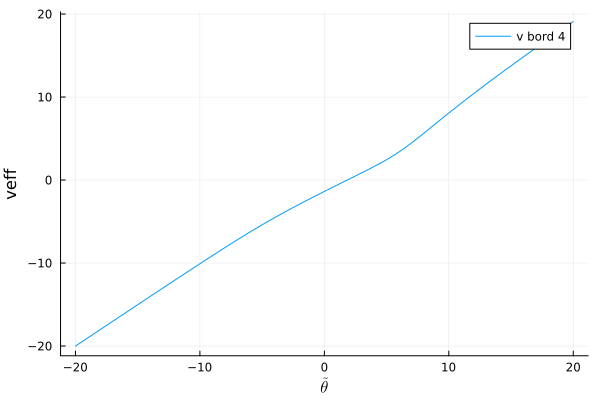

  0.176009 seconds (2.32 k allocations: 137.763 MiB, 4.16% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.806_535.595.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.806_535.595.npz
theta_star = 1.643 
  0.002064 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.806_535.595.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.806_535.595.npz


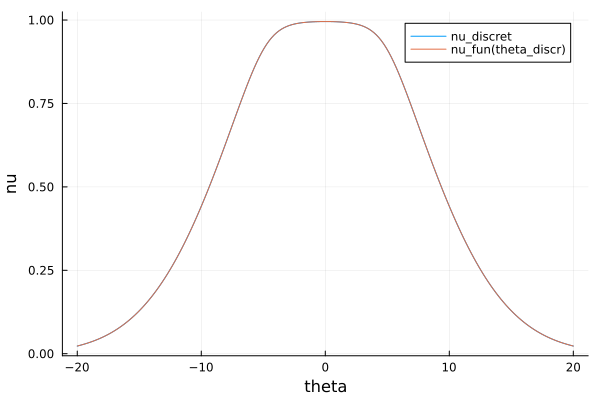

la densité haute est : 56.46504685000001
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.806_535.595_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.806_535.595_2.000_0.000.npz
la densité haute est : 56.46504685000001
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.806_535.595_2.000_veff_bord.npz


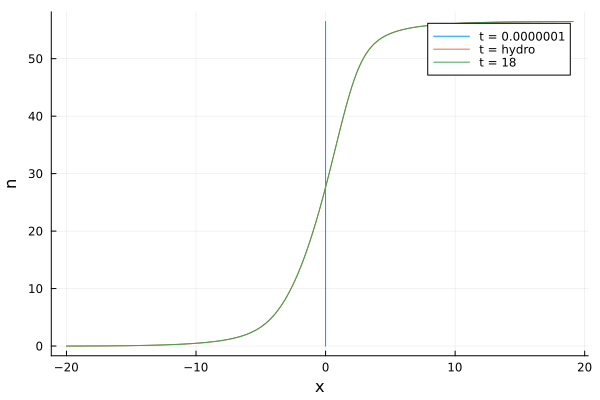

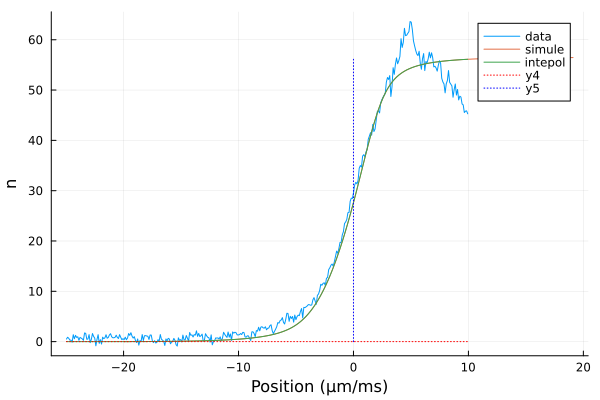

mu = 59.24928388361869
mu = 64.53464730559116
T = 558.5007421296101
n_p , model_mu(T , mu) 56.465046850000014
saved : 2024-04-24/theta_discr_ih1.npz
  0.014412 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.535_558.501.npz


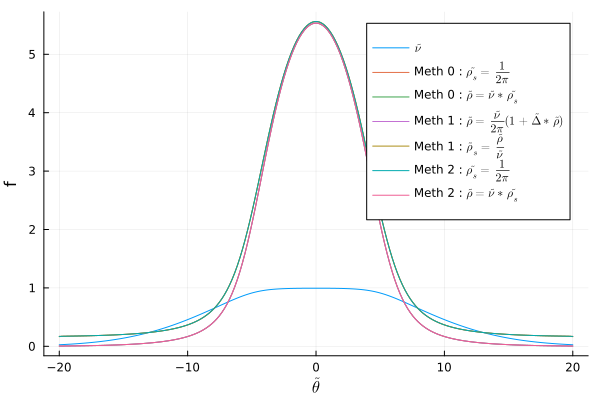

  0.001593 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.535_558.501.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.535_558.501.npz
  0.002664 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.535_558.501.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.535_558.501.npz


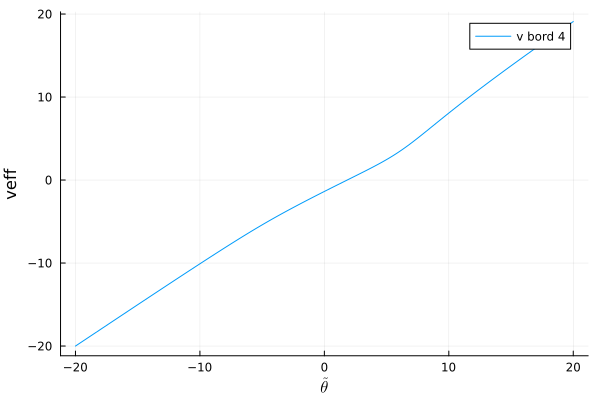

  0.177110 seconds (2.32 k allocations: 137.763 MiB, 5.14% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.535_558.501.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.535_558.501.npz
theta_star = 1.643 
  0.001557 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.535_558.501.npz
  0.000015 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.535_558.501.npz


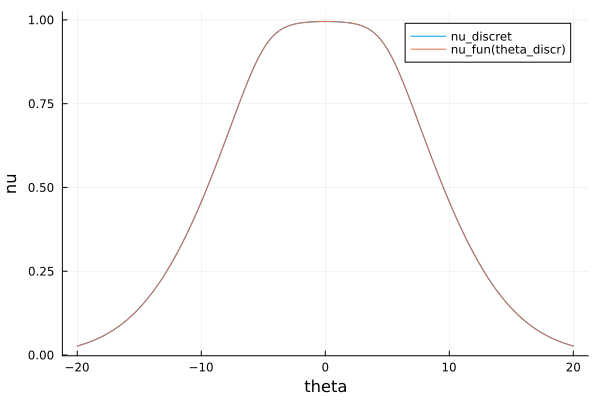

la densité haute est : 56.465046850000014
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.535_558.501_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.535_558.501_2.000_0.000.npz
la densité haute est : 56.465046850000014
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.535_558.501_2.000_veff_bord.npz


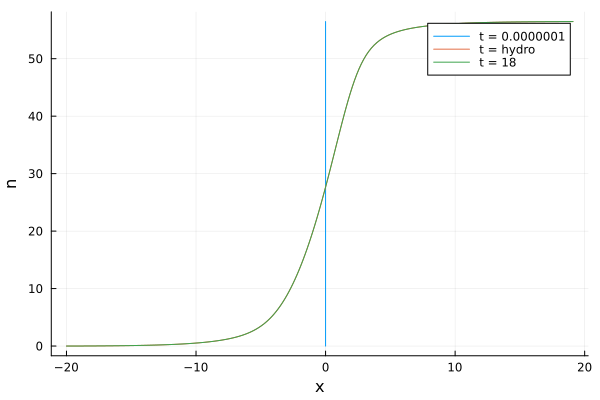

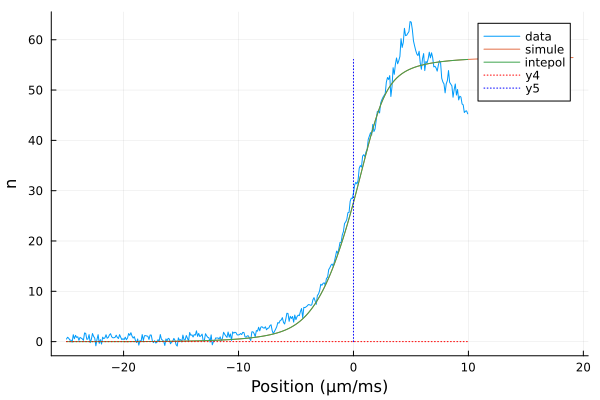

mu = 59.24928388361869
mu = 64.53464730559116
T = 558.5007421296101
n_p , model_mu(T , mu) 56.465046850000014
saved : 2024-04-24/theta_discr_ih1.npz
  0.016491 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.535_558.501.npz


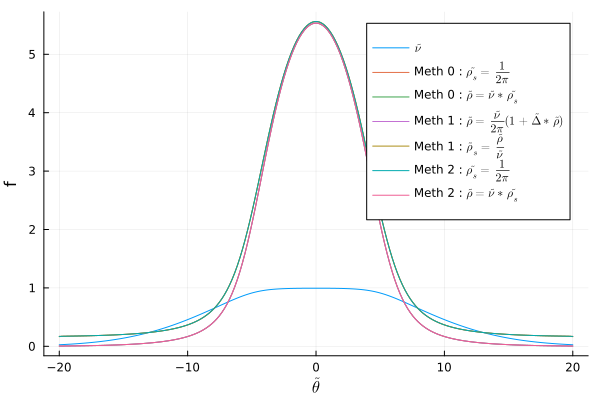

  0.001317 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.535_558.501.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.535_558.501.npz
  0.002141 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.535_558.501.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.535_558.501.npz


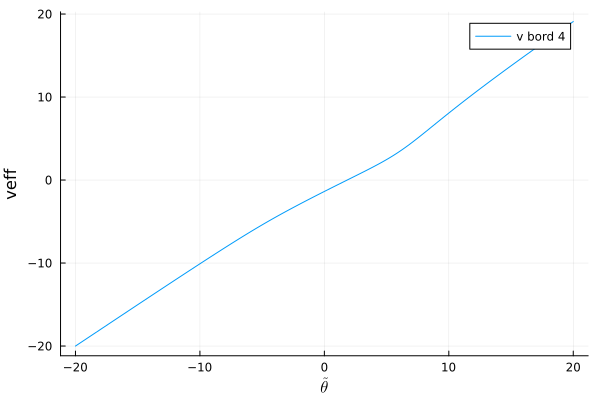

  0.179423 seconds (2.32 k allocations: 137.763 MiB, 7.31% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.535_558.501.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.535_558.501.npz
theta_star = 1.643 
  0.001299 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.535_558.501.npz
  0.000019 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.535_558.501.npz


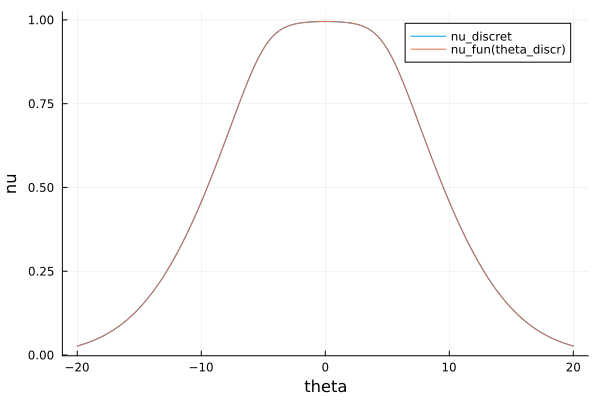

la densité haute est : 56.465046850000014
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.535_558.501_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.535_558.501_2.000_0.000.npz
la densité haute est : 56.465046850000014
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.535_558.501_2.000_veff_bord.npz


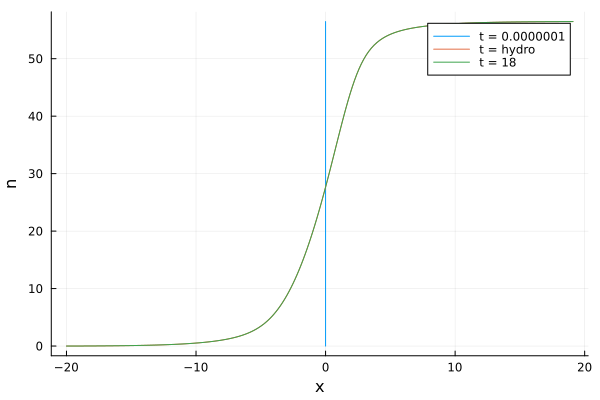

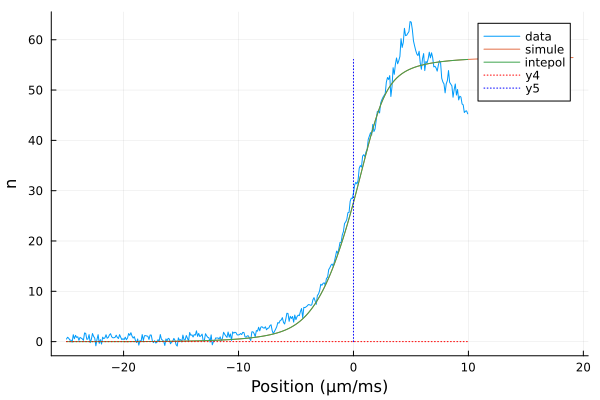

mu = 59.24928388361869
mu = 64.53460459251572
T = 558.5041241054157
n_p , model_mu(T , mu) 56.465046850000014
saved : 2024-04-24/theta_discr_ih1.npz
  0.014478 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.535_558.504.npz


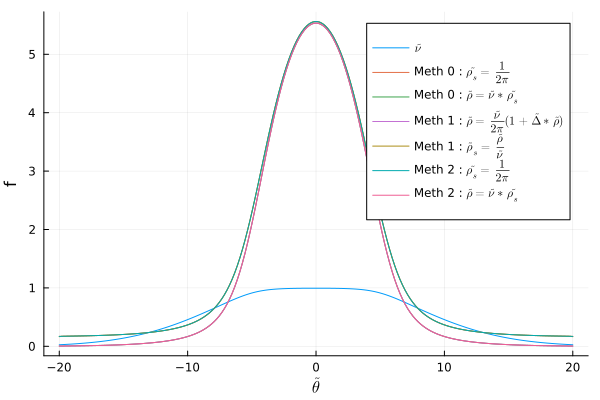

  0.001735 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.535_558.504.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.535_558.504.npz
  0.002677 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.535_558.504.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.535_558.504.npz


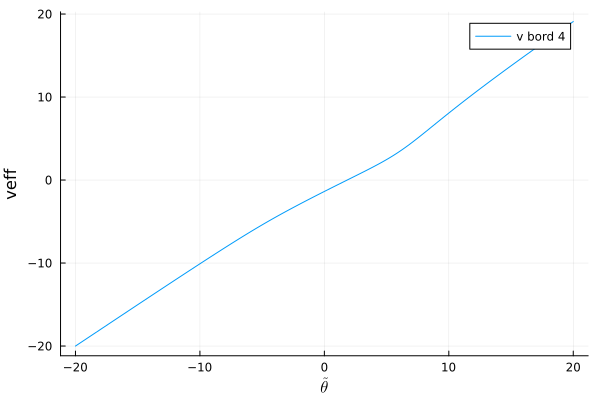

  0.179265 seconds (2.32 k allocations: 137.763 MiB, 6.44% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.535_558.504.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.535_558.504.npz
theta_star = 1.643 
  0.001534 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.535_558.504.npz
  0.000015 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.535_558.504.npz


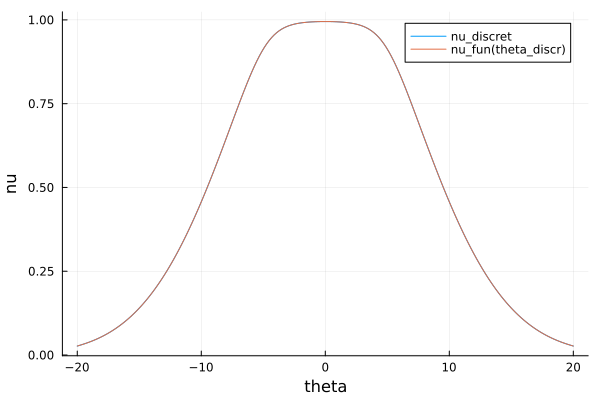

la densité haute est : 56.465046850000014
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.535_558.504_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.535_558.504_2.000_0.000.npz
la densité haute est : 56.465046850000014
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.535_558.504_2.000_veff_bord.npz


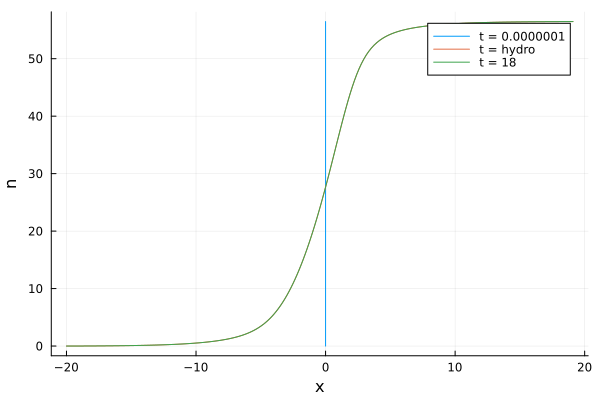

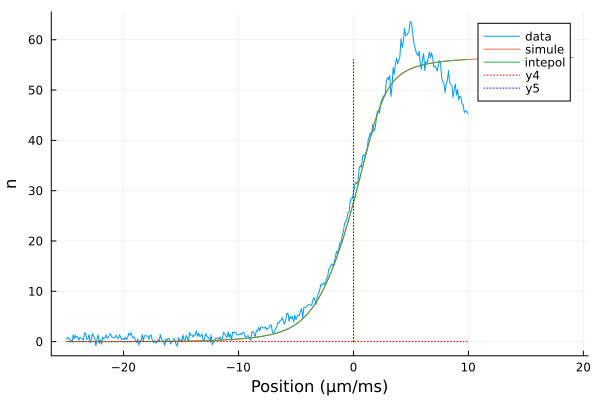

mu = 59.24928388361869
mu = 64.534690017879
T = 558.4973601538045
n_p , model_mu(T , mu) 56.46504685000004
saved : 2024-04-24/theta_discr_ih1.npz
  0.014563 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.535_558.497.npz


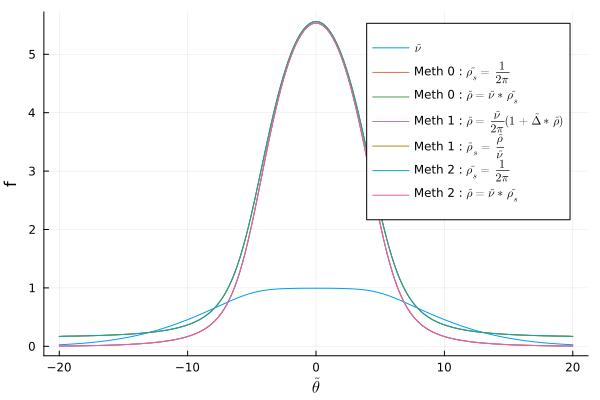

  0.001469 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.535_558.497.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.535_558.497.npz
  0.002185 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.535_558.497.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.535_558.497.npz


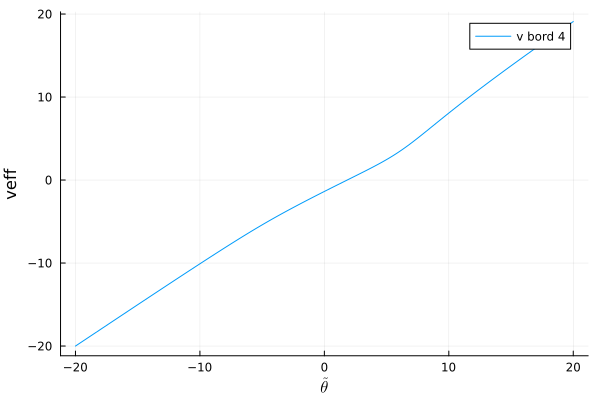

  0.141789 seconds (2.32 k allocations: 137.763 MiB, 6.43% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.535_558.497.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.535_558.497.npz
theta_star = 1.643 
  0.001266 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.535_558.497.npz
  0.000015 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.535_558.497.npz


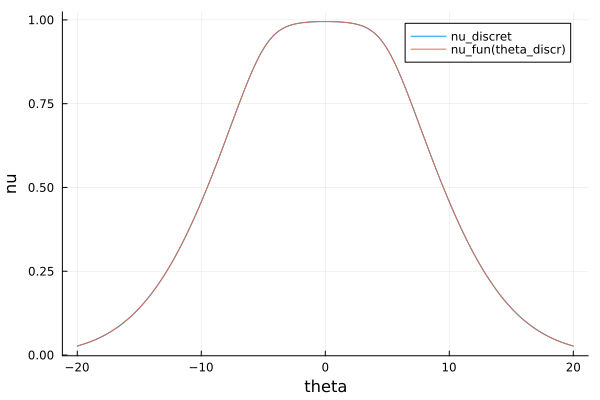

la densité haute est : 56.46504685000004
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.535_558.497_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.535_558.497_2.000_0.000.npz
la densité haute est : 56.46504685000004
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.535_558.497_2.000_veff_bord.npz


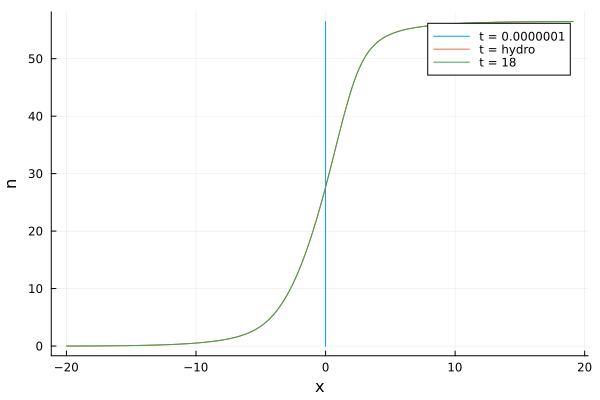

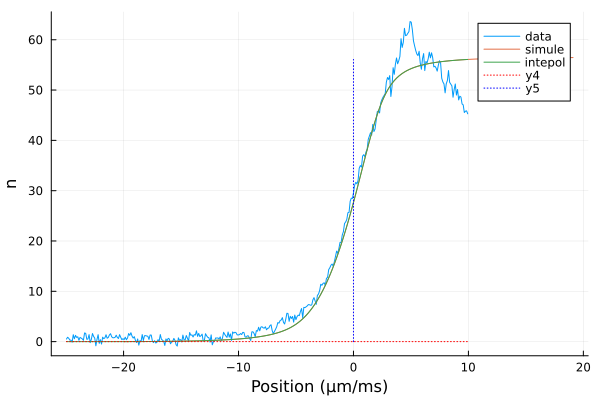

mu = 59.24928388361869
mu = 64.52811295393812
T = 559.017402108268
n_p , model_mu(T , mu) 56.465046849999965
saved : 2024-04-24/theta_discr_ih1.npz
  0.015841 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.528_559.017.npz


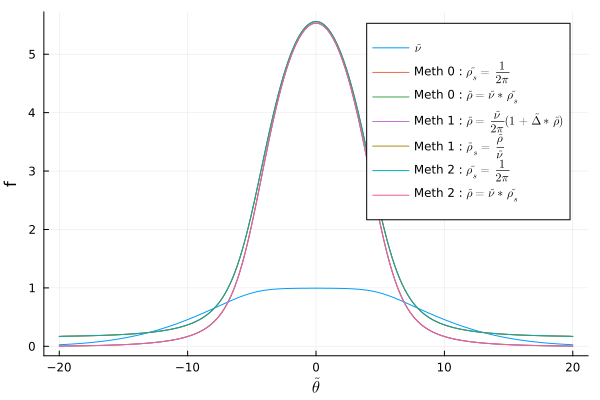

  0.001466 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.528_559.017.npz
  0.000011 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.528_559.017.npz
  0.002100 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.528_559.017.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.528_559.017.npz


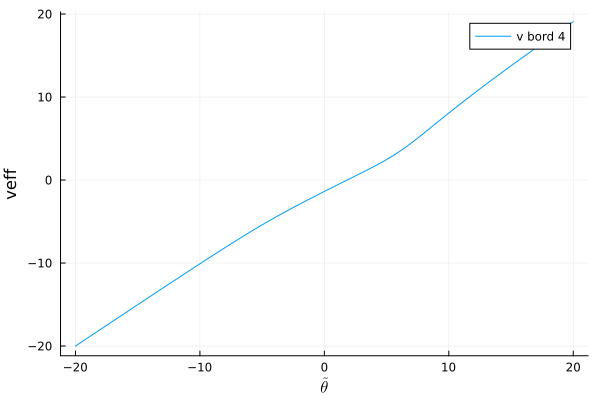

  0.142401 seconds (2.32 k allocations: 137.763 MiB, 6.45% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.528_559.017.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.528_559.017.npz
theta_star = 1.643 
  0.001299 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.528_559.017.npz
  0.000016 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.528_559.017.npz


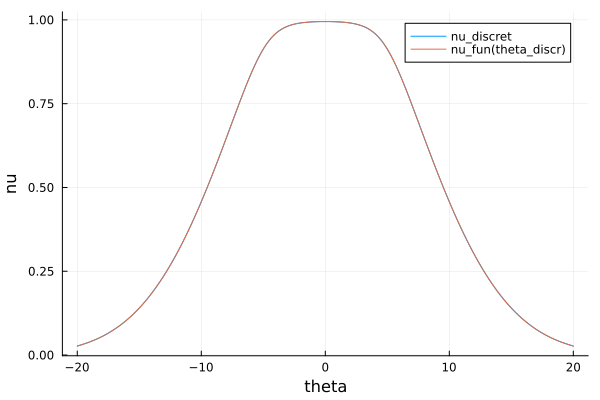

la densité haute est : 56.465046849999965
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.528_559.017_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.528_559.017_2.000_0.000.npz
la densité haute est : 56.465046849999965
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.528_559.017_2.000_veff_bord.npz


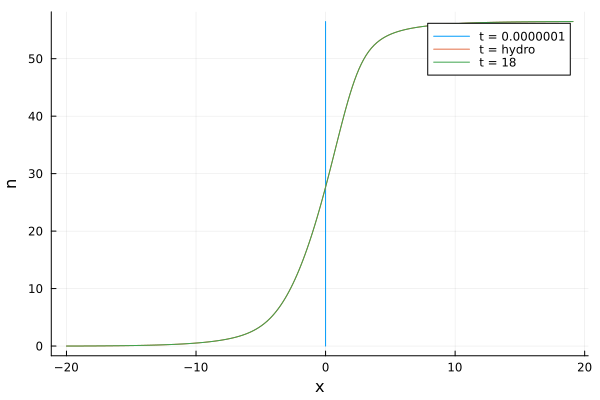

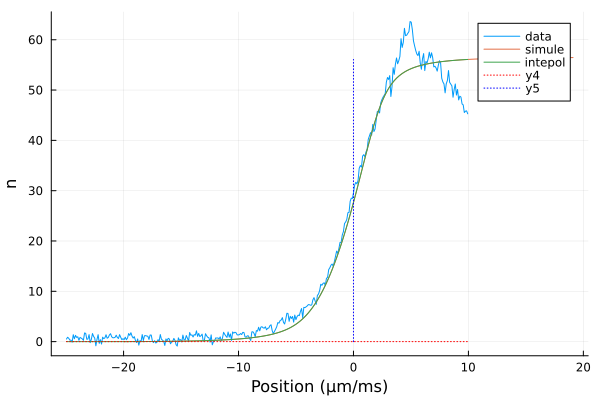

mu = 59.24928388361869
mu = 64.52811295393812
T = 559.017402108268
n_p , model_mu(T , mu) 56.465046849999965
saved : 2024-04-24/theta_discr_ih1.npz
  0.014541 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.528_559.017.npz


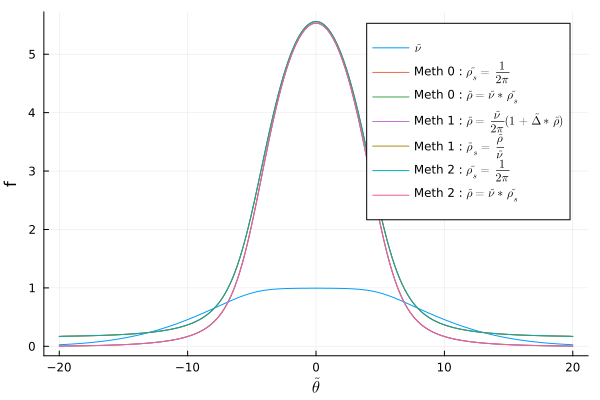

  0.001749 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.528_559.017.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.528_559.017.npz
  0.002648 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.528_559.017.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.528_559.017.npz


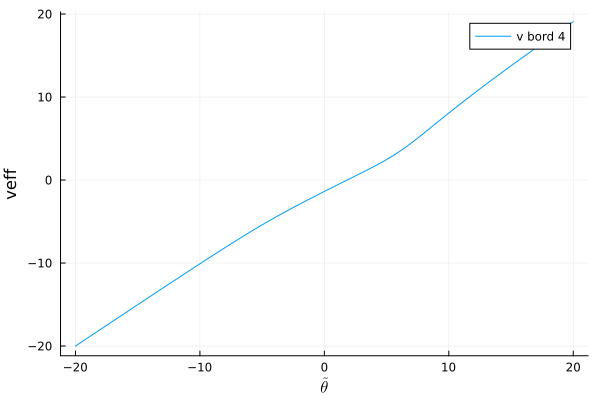

  0.179432 seconds (2.32 k allocations: 137.763 MiB, 6.54% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.528_559.017.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.528_559.017.npz
theta_star = 1.643 
  0.001542 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.528_559.017.npz
  0.000015 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.528_559.017.npz


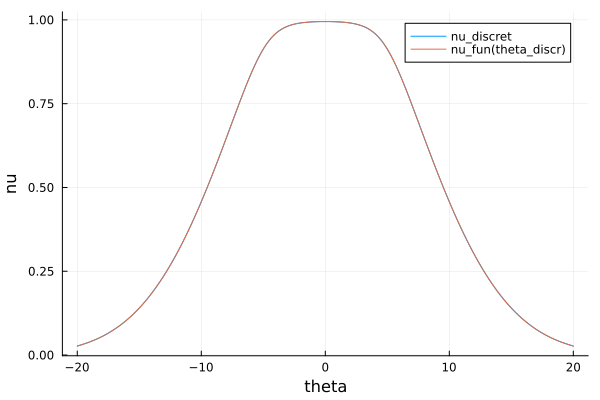

la densité haute est : 56.465046849999965
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.528_559.017_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.528_559.017_2.000_0.000.npz
la densité haute est : 56.465046849999965
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.528_559.017_2.000_veff_bord.npz


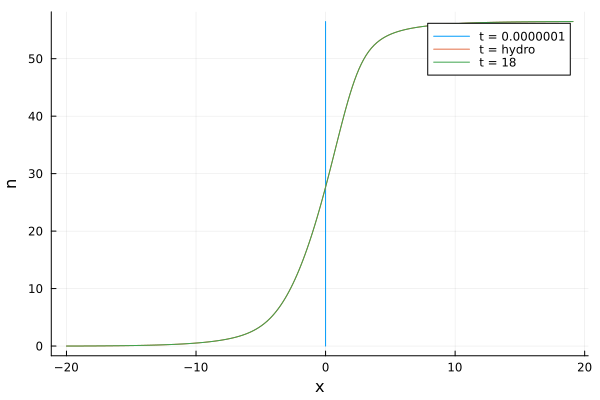

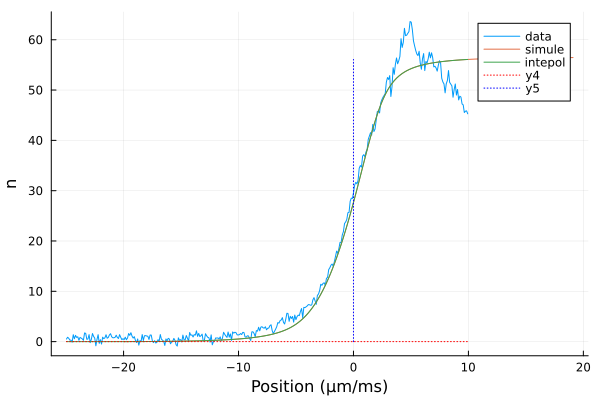

mu = 59.24928388361869
mu = 64.52807008090727
T = 559.0207872126846
n_p , model_mu(T , mu) 56.46504685000004
saved : 2024-04-24/theta_discr_ih1.npz
  0.014639 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.528_559.021.npz


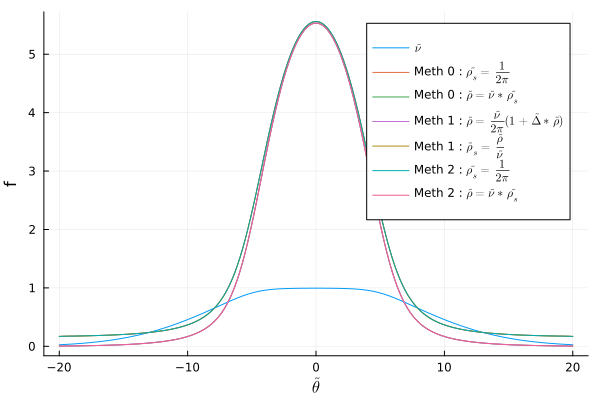

  0.001764 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.528_559.021.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.528_559.021.npz
  0.002658 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.528_559.021.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.528_559.021.npz


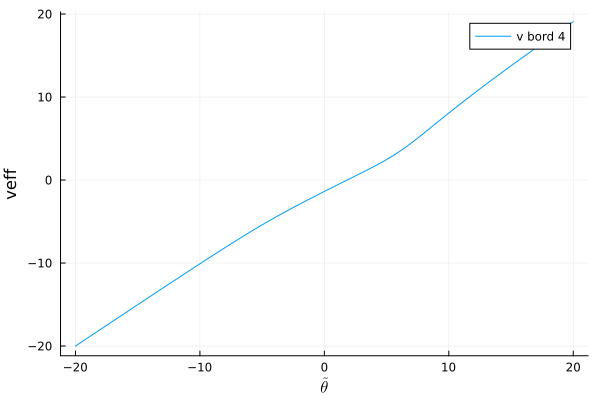

  0.176206 seconds (2.32 k allocations: 137.763 MiB, 4.54% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.528_559.021.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.528_559.021.npz
theta_star = 1.643 
  0.001550 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.528_559.021.npz
  0.000016 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.528_559.021.npz


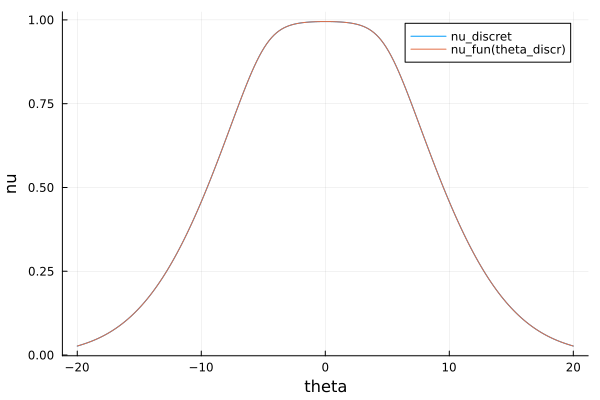

la densité haute est : 56.46504685000004
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.528_559.021_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.528_559.021_2.000_0.000.npz
la densité haute est : 56.46504685000004
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.528_559.021_2.000_veff_bord.npz


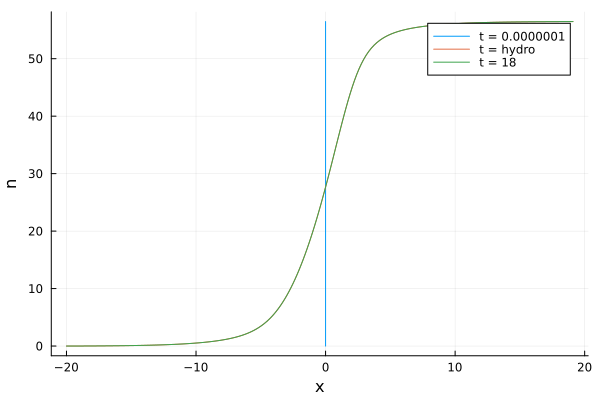

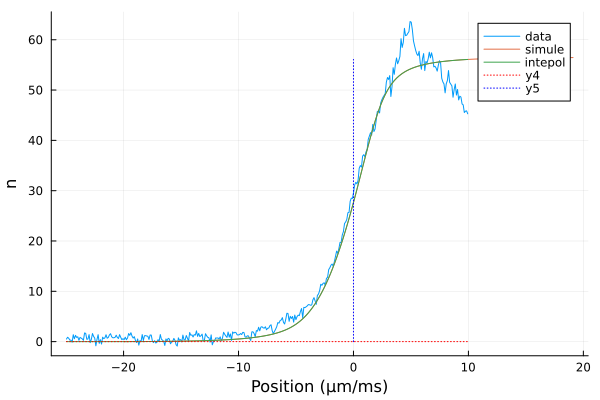

mu = 59.24928388361869
mu = 64.52815582617988
T = 559.0140170038514
n_p , model_mu(T , mu) 56.4650468500001
saved : 2024-04-24/theta_discr_ih1.npz
  0.015769 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.528_559.014.npz


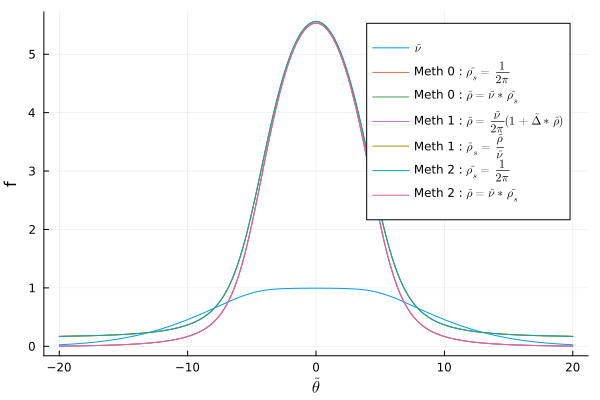

  0.001748 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.528_559.014.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.528_559.014.npz
  0.002677 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.528_559.014.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.528_559.014.npz


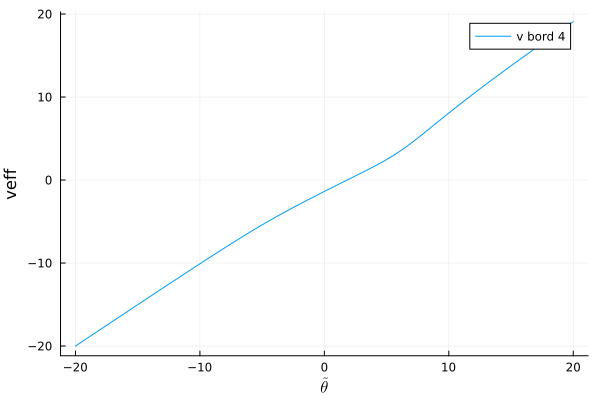

  0.177369 seconds (2.32 k allocations: 137.763 MiB, 5.25% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.528_559.014.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.528_559.014.npz
theta_star = 1.643 
  0.001563 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.528_559.014.npz
  0.000017 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.528_559.014.npz


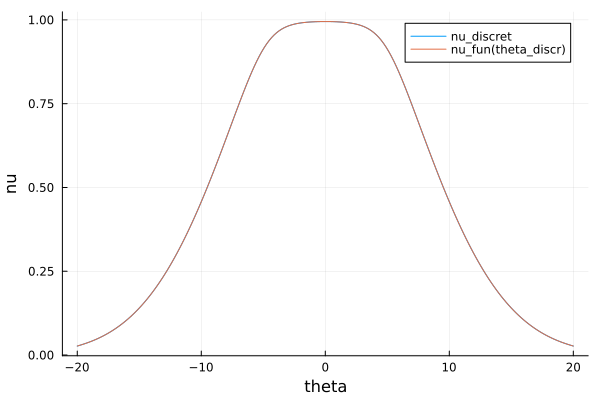

la densité haute est : 56.4650468500001
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.528_559.014_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.528_559.014_2.000_0.000.npz
la densité haute est : 56.4650468500001
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.528_559.014_2.000_veff_bord.npz


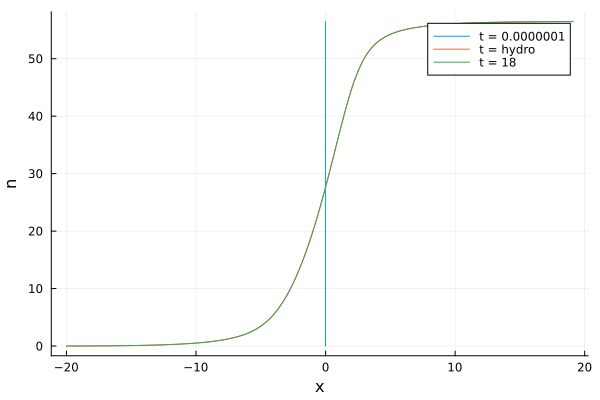

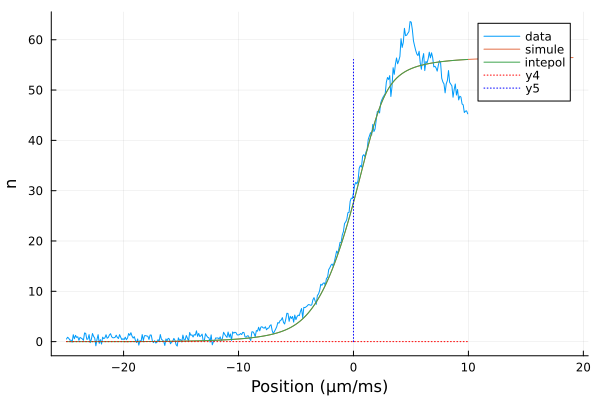

mu = 59.24928388361869
mu = 64.52909472132272
T = 558.9398681373104
n_p , model_mu(T , mu) 56.46504685000002
saved : 2024-04-24/theta_discr_ih1.npz
  0.014267 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.529_558.940.npz


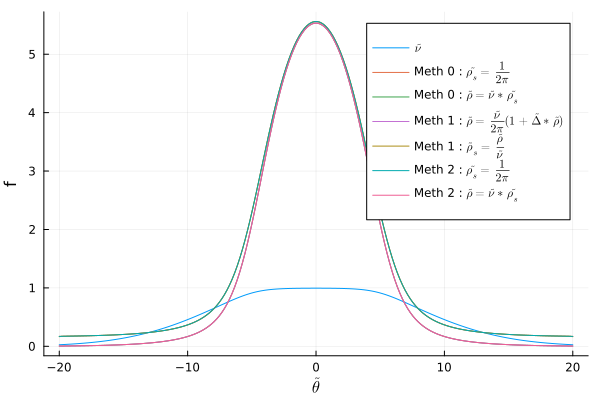

  0.001586 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.529_558.940.npz
  0.000012 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.529_558.940.npz
  0.002653 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.529_558.940.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.529_558.940.npz


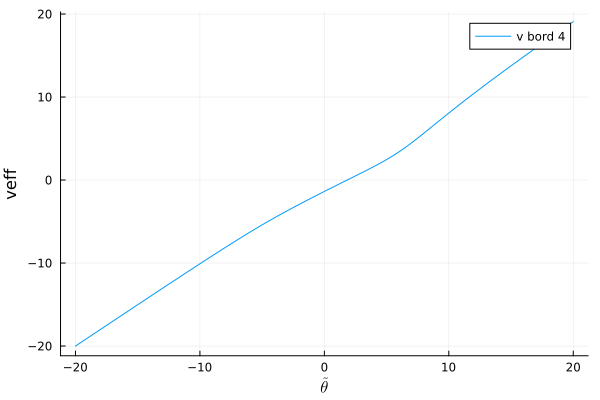

  0.179496 seconds (2.32 k allocations: 137.763 MiB, 6.55% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.529_558.940.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.529_558.940.npz
theta_star = 1.643 
  0.001575 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.529_558.940.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.529_558.940.npz


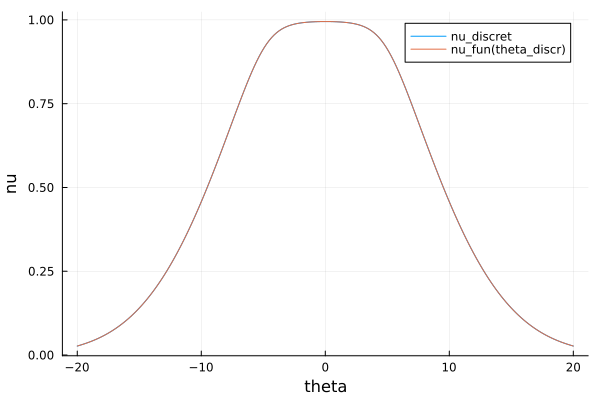

la densité haute est : 56.46504685000002
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.940_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.529_558.940_2.000_0.000.npz
la densité haute est : 56.46504685000002
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.940_2.000_veff_bord.npz


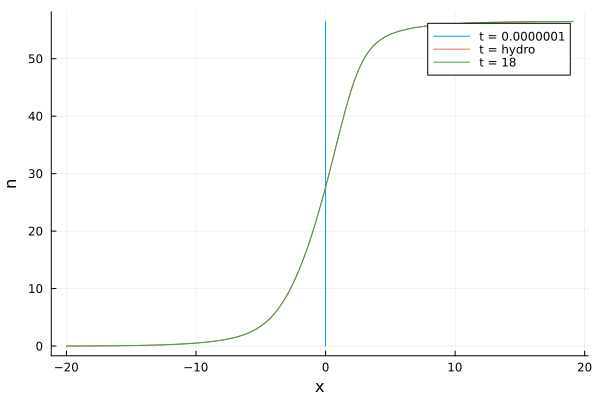

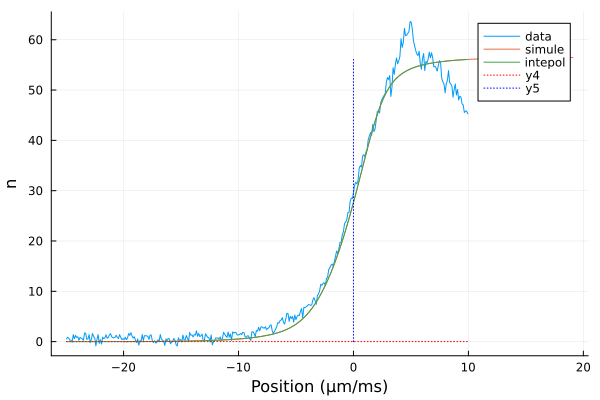

mu = 59.24928388361869
mu = 64.52909472132272
T = 558.9398681373104
n_p , model_mu(T , mu) 56.46504685000002
saved : 2024-04-24/theta_discr_ih1.npz
  0.014517 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.529_558.940.npz


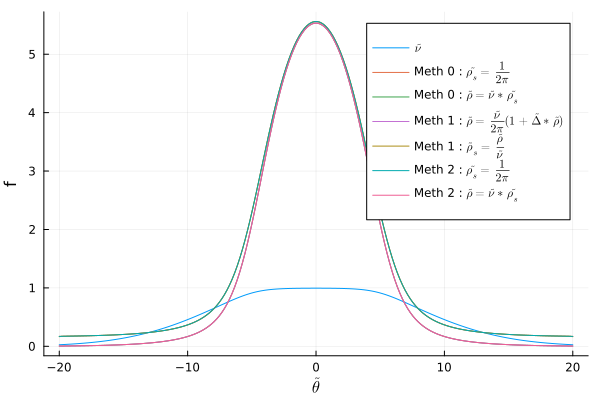

  0.001586 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.529_558.940.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.529_558.940.npz
  0.002665 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.529_558.940.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.529_558.940.npz


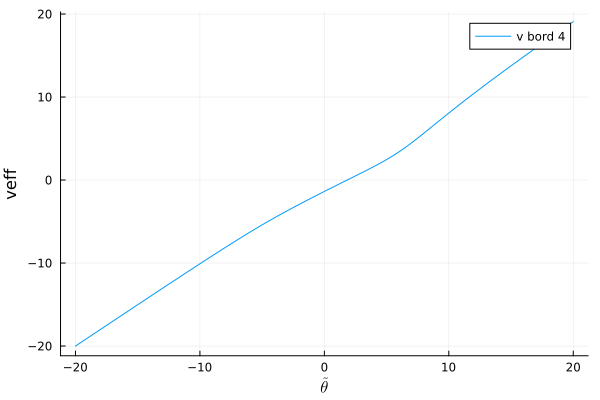

  0.175941 seconds (2.32 k allocations: 137.763 MiB, 4.55% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.529_558.940.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.529_558.940.npz
theta_star = 1.643 
  0.001537 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.529_558.940.npz
  0.000015 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.529_558.940.npz


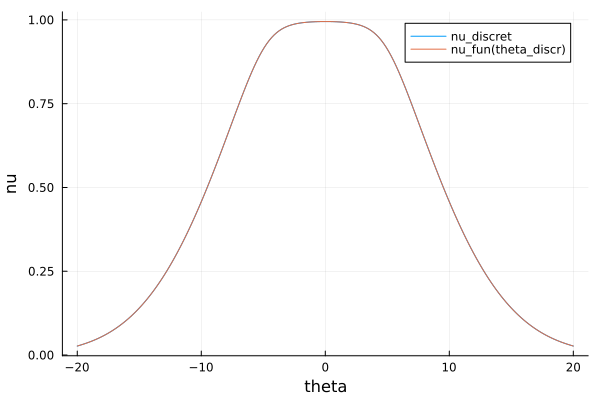

la densité haute est : 56.46504685000002
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.940_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.529_558.940_2.000_0.000.npz
la densité haute est : 56.46504685000002
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.940_2.000_veff_bord.npz


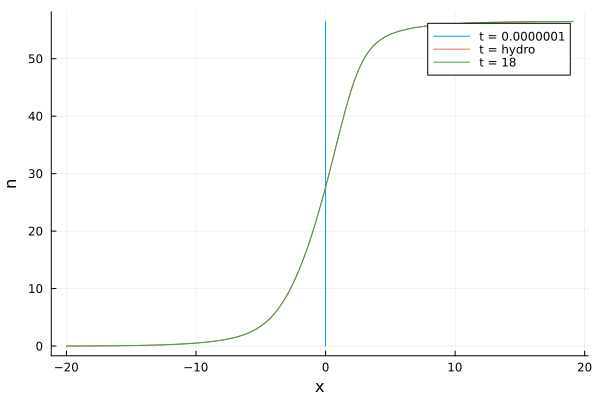

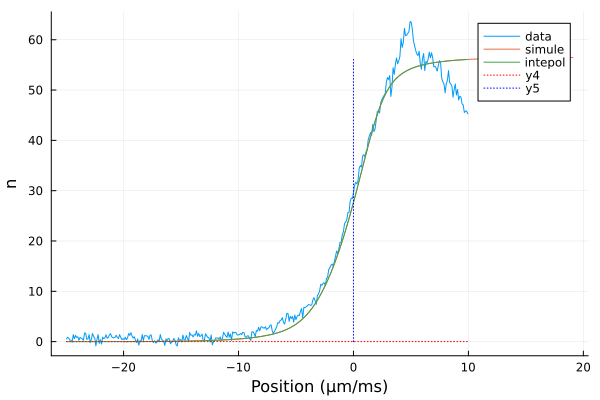

mu = 59.24928388361869
mu = 64.52905187230857
T = 558.9432527722236
n_p , model_mu(T , mu) 56.465046850000014
saved : 2024-04-24/theta_discr_ih1.npz
  0.016084 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.529_558.943.npz


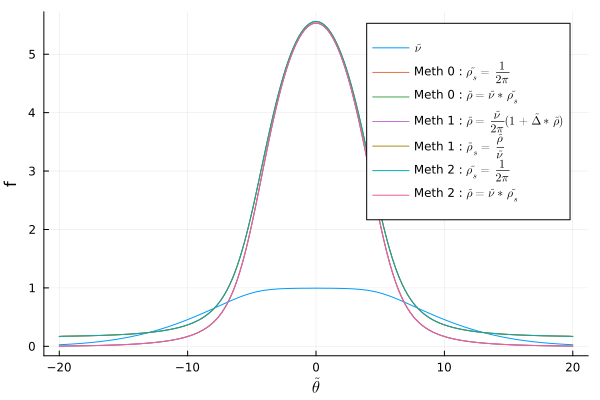

  0.001585 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.529_558.943.npz
  0.000012 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.529_558.943.npz
  0.002691 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.529_558.943.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.529_558.943.npz


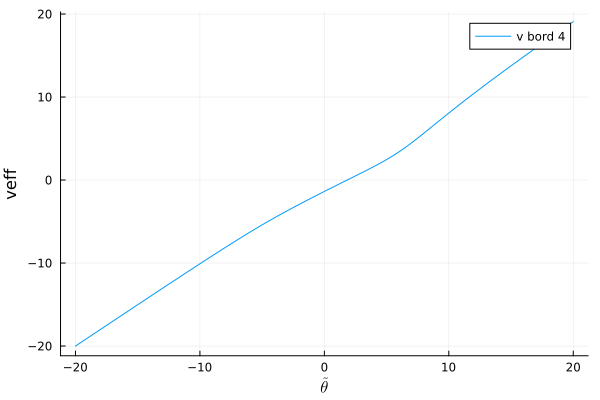

  0.176606 seconds (2.32 k allocations: 137.763 MiB, 5.27% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.529_558.943.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.529_558.943.npz
theta_star = 1.643 
  0.001568 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.529_558.943.npz
  0.000017 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.529_558.943.npz


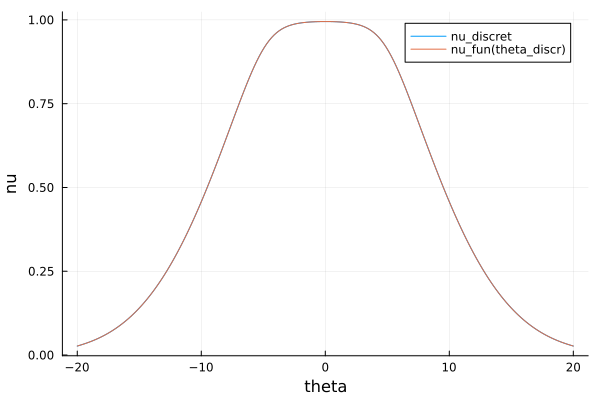

la densité haute est : 56.465046850000014
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.943_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.529_558.943_2.000_0.000.npz
la densité haute est : 56.465046850000014
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.943_2.000_veff_bord.npz


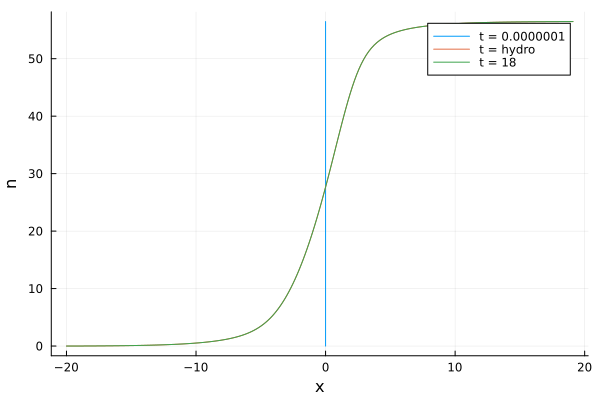

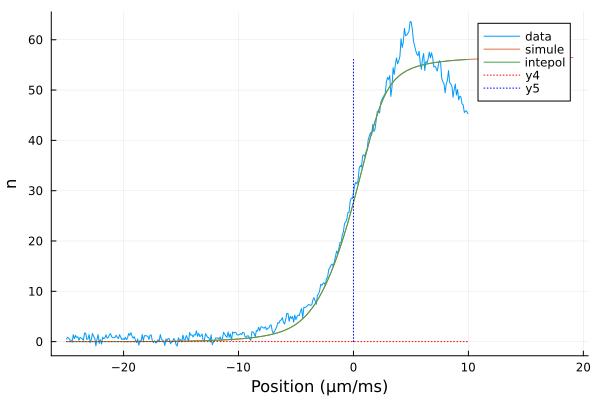

mu = 59.24928388361869
mu = 64.5291375695479
T = 558.9364835023973
n_p , model_mu(T , mu) 56.46504685000005
saved : 2024-04-24/theta_discr_ih1.npz
  0.014915 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.529_558.936.npz


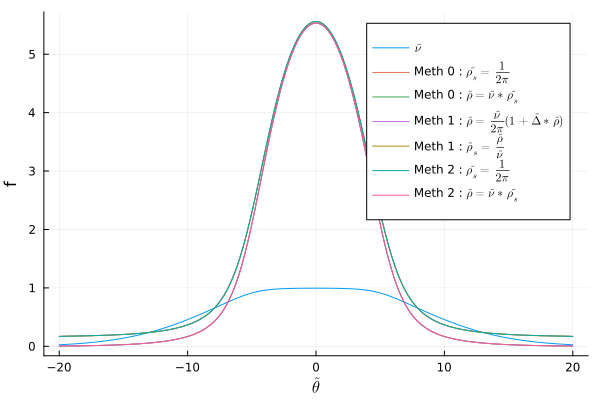

  0.001624 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.529_558.936.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.529_558.936.npz
  0.002726 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.529_558.936.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.529_558.936.npz


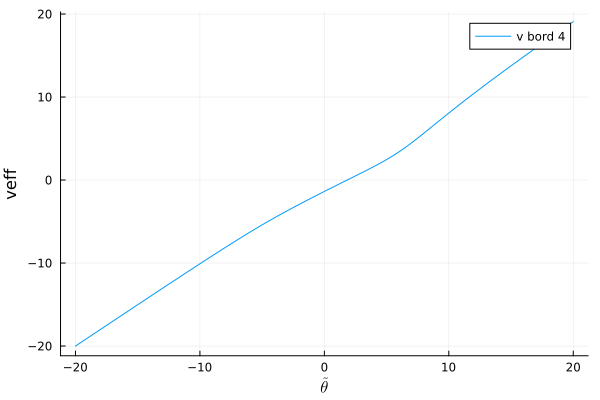

  0.182228 seconds (2.32 k allocations: 137.763 MiB, 6.55% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.529_558.936.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.529_558.936.npz
theta_star = 1.643 
  0.001580 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.529_558.936.npz
  0.000015 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.529_558.936.npz


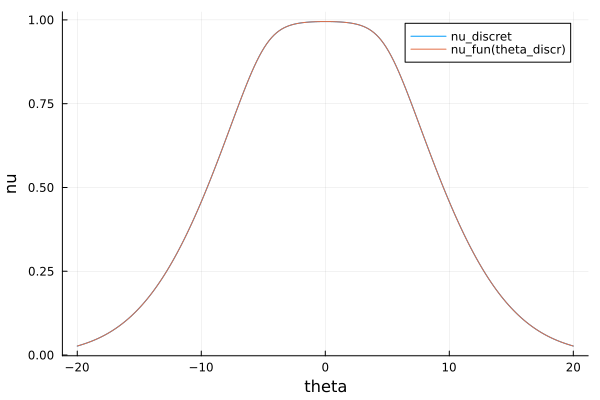

la densité haute est : 56.46504685000005
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.936_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.529_558.936_2.000_0.000.npz
la densité haute est : 56.46504685000005
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.936_2.000_veff_bord.npz


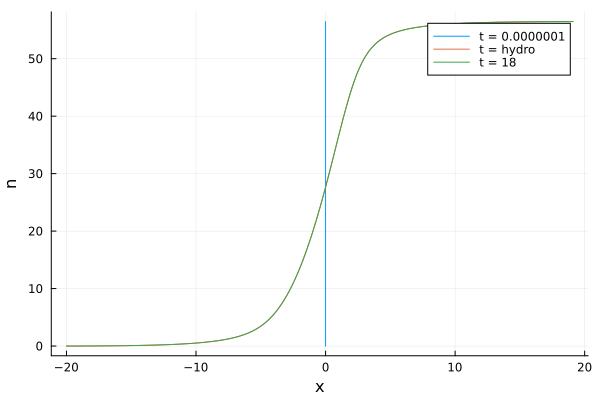

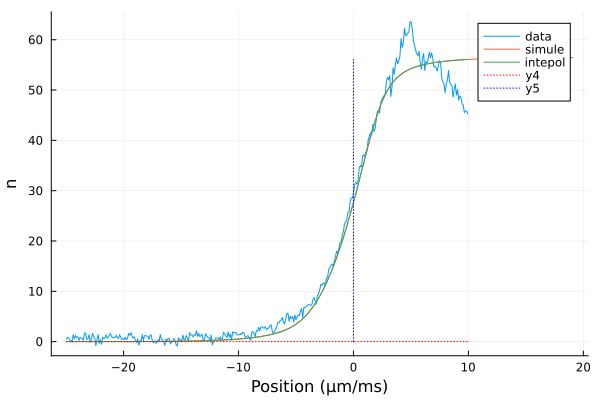

mu = 59.24928388361869
mu = 64.52909999054889
T = 558.9394519178908
n_p , model_mu(T , mu) 56.46504684999999
saved : 2024-04-24/theta_discr_ih1.npz
  0.014443 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.529_558.939.npz


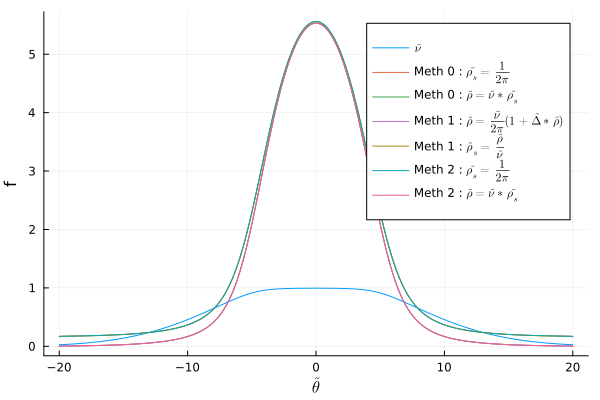

  0.001602 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.529_558.939.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.529_558.939.npz
  0.002688 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.529_558.939.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.529_558.939.npz


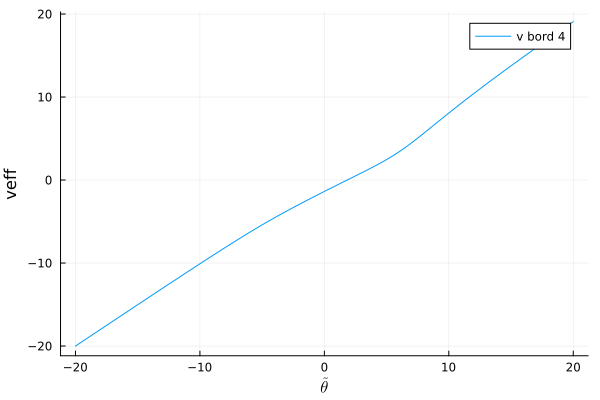

  0.175556 seconds (2.32 k allocations: 137.763 MiB, 4.58% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.529_558.939.npz
  0.000006 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.529_558.939.npz
theta_star = 1.643 
  0.001530 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.529_558.939.npz
  0.000015 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.529_558.939.npz


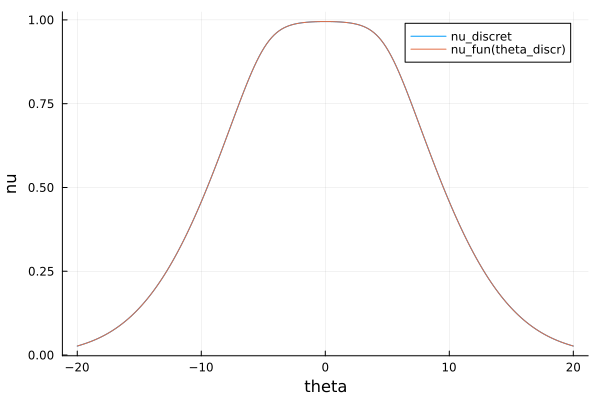

la densité haute est : 56.46504684999999
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.939_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.529_558.939_2.000_0.000.npz
la densité haute est : 56.46504684999999
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.939_2.000_veff_bord.npz


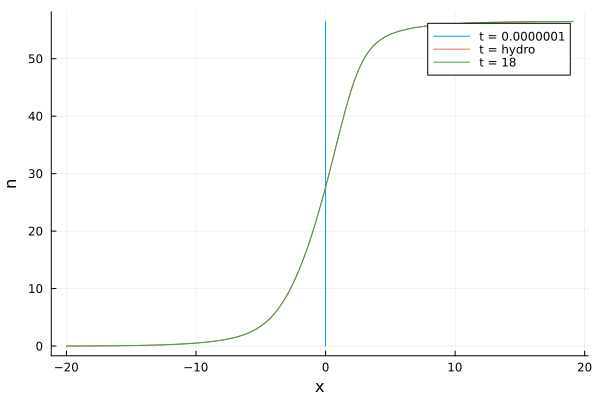

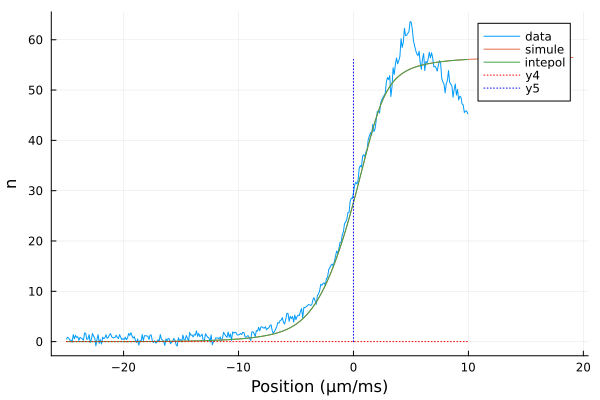

mu = 59.24928388361869
mu = 64.52909999054889
T = 558.9394519178908
n_p , model_mu(T , mu) 56.46504684999999
saved : 2024-04-24/theta_discr_ih1.npz
  0.027165 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.529_558.939.npz


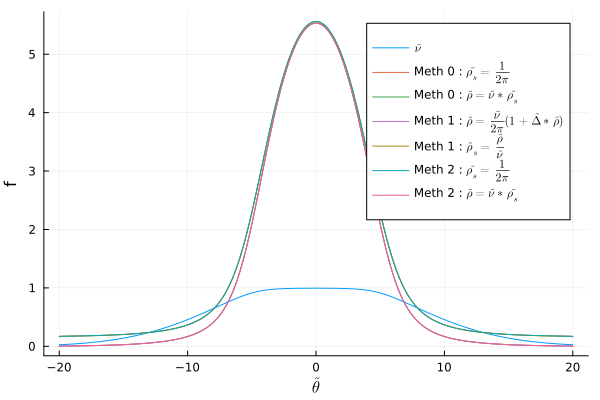

  0.002280 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.529_558.939.npz
  0.000021 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.529_558.939.npz
  0.004073 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.529_558.939.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.529_558.939.npz


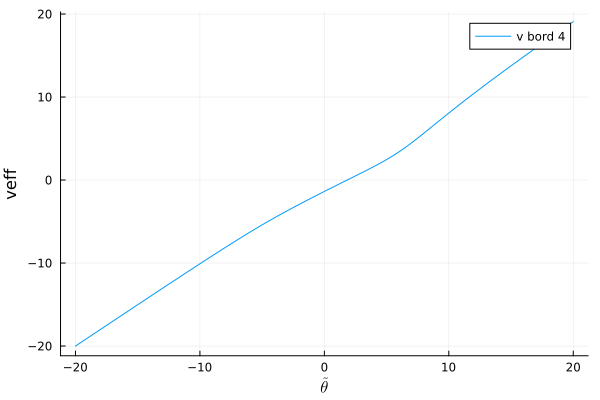

  0.271200 seconds (2.32 k allocations: 137.763 MiB, 5.63% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.529_558.939.npz
  0.000013 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.529_558.939.npz
theta_star = 1.643 
  0.002411 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.529_558.939.npz
  0.000029 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.529_558.939.npz


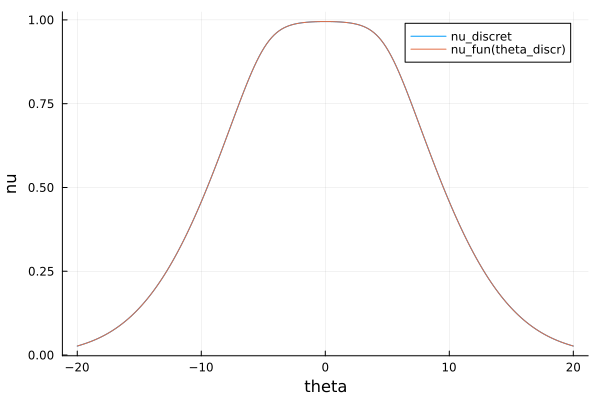

la densité haute est : 56.46504684999999
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.939_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.529_558.939_2.000_0.000.npz
la densité haute est : 56.46504684999999
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.939_2.000_veff_bord.npz


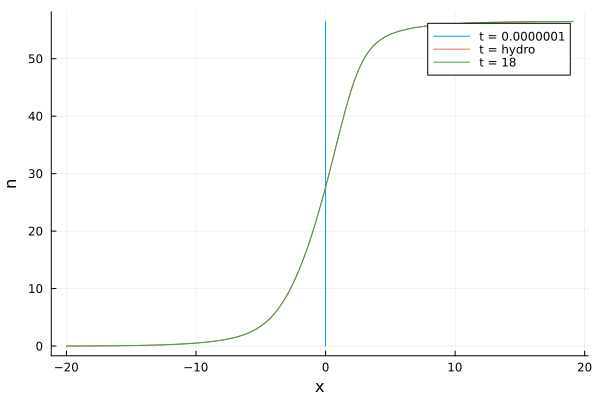

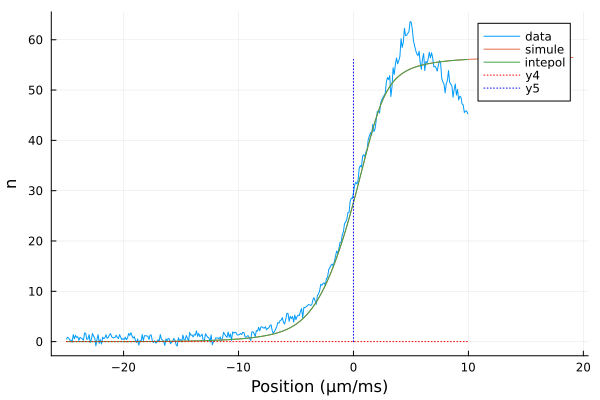

mu = 59.24928388361869
mu = 64.52905714166377
T = 558.9428365502835
n_p , model_mu(T , mu) 56.46504685000002
saved : 2024-04-24/theta_discr_ih1.npz
  0.024520 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.529_558.943.npz


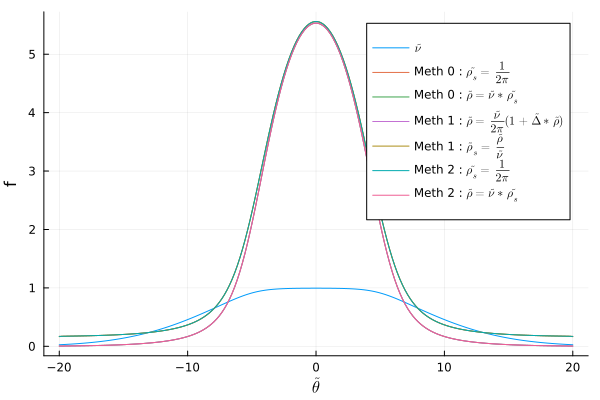

  0.002318 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.529_558.943.npz
  0.000024 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.529_558.943.npz
  0.004023 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.529_558.943.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.529_558.943.npz


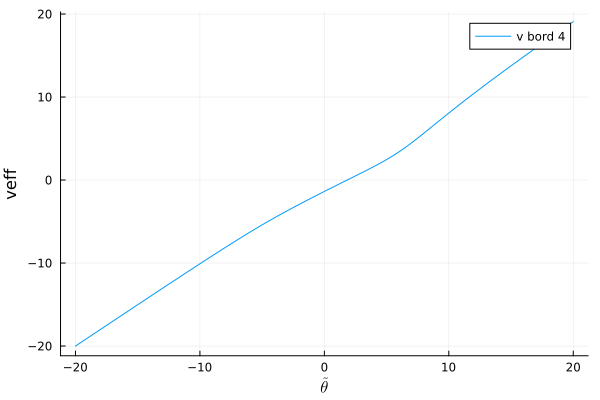

  0.274517 seconds (2.32 k allocations: 137.763 MiB, 6.75% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.529_558.943.npz
  0.000011 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.529_558.943.npz
theta_star = 1.643 
  0.002415 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.529_558.943.npz
  0.000025 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.529_558.943.npz


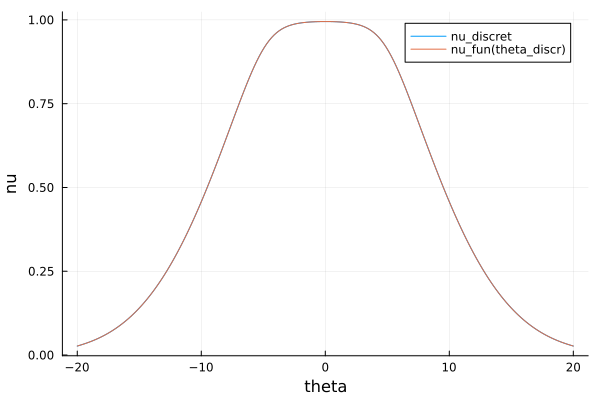

la densité haute est : 56.46504685000002
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.943_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.529_558.943_2.000_0.000.npz
la densité haute est : 56.46504685000002
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.943_2.000_veff_bord.npz


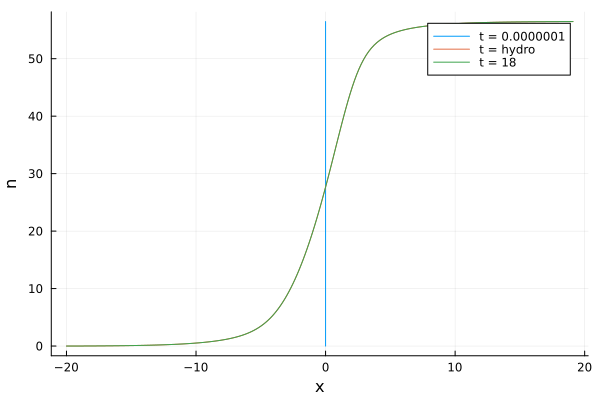

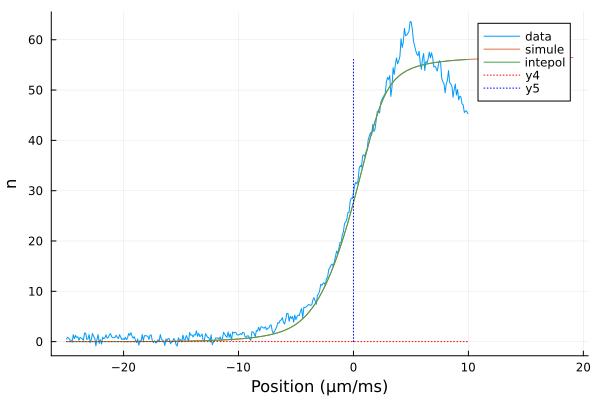

mu = 59.24928388361869
mu = 64.5291428386452
T = 558.9360672854981
n_p , model_mu(T , mu) 56.46504685000004
saved : 2024-04-24/theta_discr_ih1.npz
  0.024689 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.529_558.936.npz


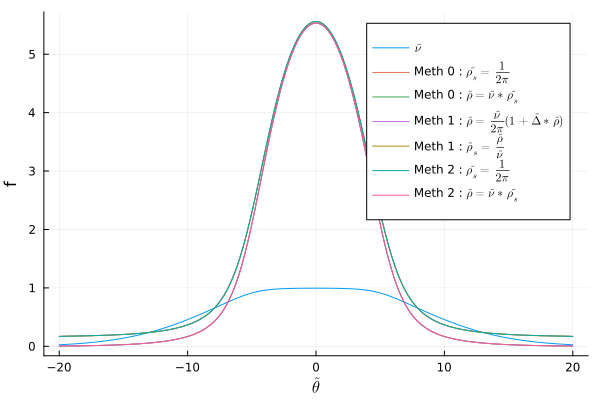

  0.002318 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.529_558.936.npz
  0.000022 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.529_558.936.npz
  0.004012 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.529_558.936.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.529_558.936.npz


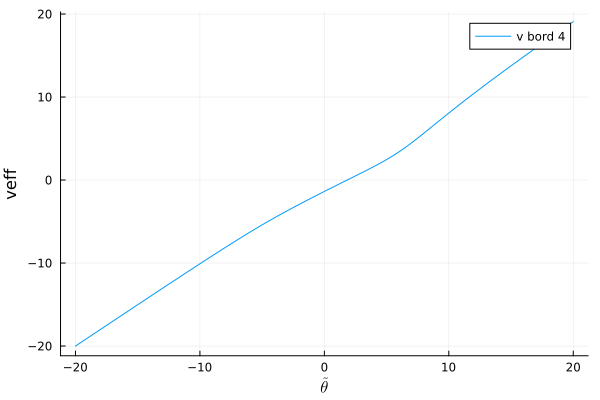

  0.270025 seconds (2.32 k allocations: 137.763 MiB, 4.62% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.529_558.936.npz
  0.000012 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.529_558.936.npz
theta_star = 1.643 
  0.002381 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.529_558.936.npz
  0.000026 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.529_558.936.npz


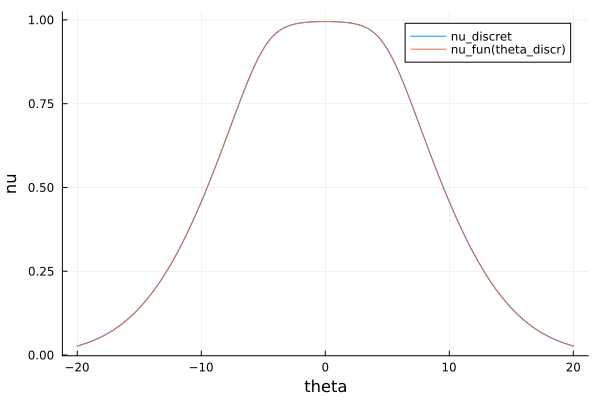

la densité haute est : 56.46504685000004
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.936_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.529_558.936_2.000_0.000.npz
la densité haute est : 56.46504685000004
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.936_2.000_veff_bord.npz


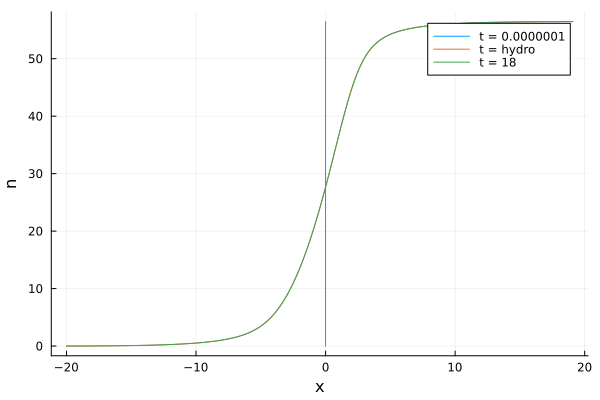

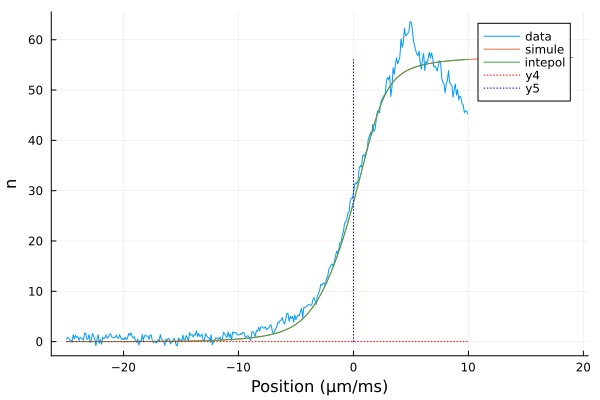

mu = 59.24928388361869
mu = 64.5291000184444
T = 558.9394497144137
n_p , model_mu(T , mu) 56.465046850000064
saved : 2024-04-24/theta_discr_ih1.npz
  0.026357 seconds (5.14 k allocations: 9.159 MiB)
saved : 2024-04-24/nu_discr_ih1_64.529_558.939.npz


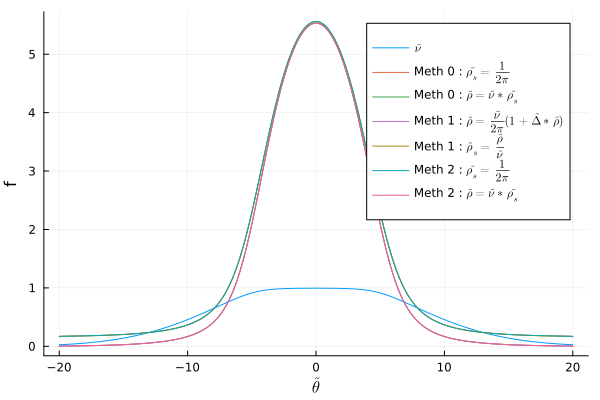

  0.002265 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.529_558.939.npz
  0.000021 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.529_558.939.npz
  0.004053 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.529_558.939.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.529_558.939.npz


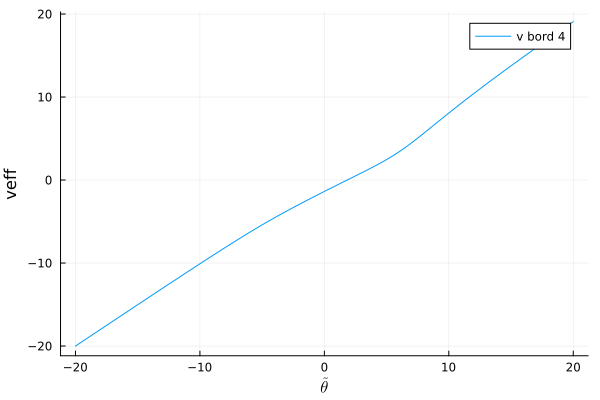

  0.271193 seconds (2.32 k allocations: 137.763 MiB, 5.61% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.529_558.939.npz
  0.000013 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.529_558.939.npz
theta_star = 1.643 
  0.002432 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.529_558.939.npz
  0.000029 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.529_558.939.npz


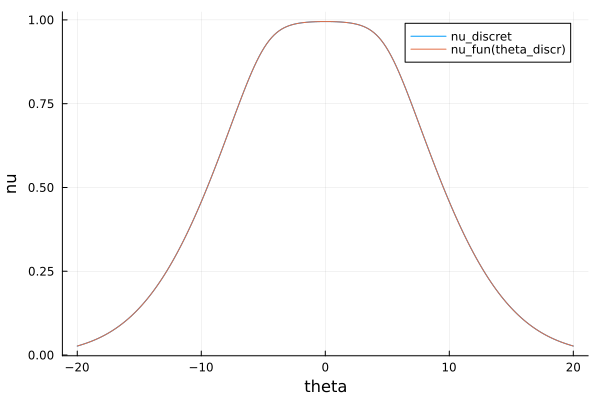

la densité haute est : 56.465046850000064
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.939_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.529_558.939_2.000_0.000.npz
la densité haute est : 56.465046850000064
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.529_558.939_2.000_veff_bord.npz


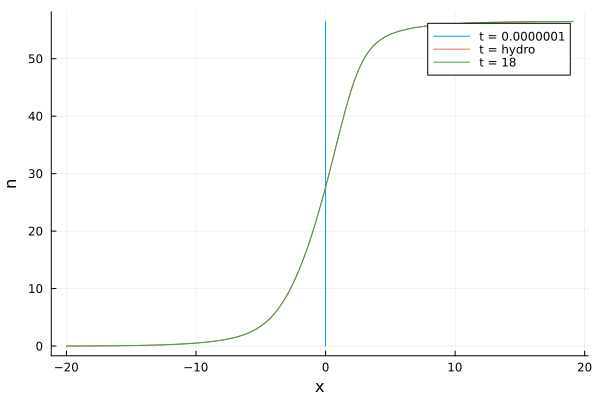

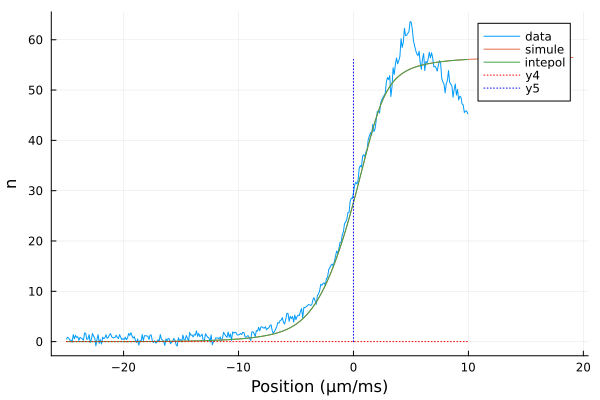

LsqFit.LsqFitResult{Vector{Float64}, Vector{Float64}, Matrix{Float64}, Vector{Float64}, Vector{LsqFit.LMState{LsqFit.LevenbergMarquardt}}}([558.9394519178908], [10.795621974041666, 10.20439829984997, 10.249795717705183, 10.511227229899028, 8.97298388785407, 8.778805186048032, 7.392506390204282, 7.2019085562888066, 7.9328328967907, 5.837373719198958  …  -0.8328119324947245, -1.2408271180861332, -0.5713494114129904, -1.3747097683323224, 0.11651224917100134, -0.2955989704914108, -0.2907682134251788, -0.6662401818476571, -0.8663245428127722, -0.5118296269247482], [-0.0014482014423384067; -0.0014858347463965569; … ; 0.0; 0.0;;], true, Iter     Function value   Gradient norm 
------   --------------   --------------
, Float64[])

In [14]:
n_p = 56.46504685
Taille = 2 #23.818206787109375#24.780000000000086  #mu m 


fit_deformation = 1 == 1 
fit_expension = 1 == 1

if fit_deformation
    x_data = DONNEES[2][1]/18 
    y_data = DONNEES[2][2]
    mask = (x_data .> -25 ) .& (x_data .< 10)
    x_data = x_data[mask]
    y_data = y_data[mask]
elseif fit_expension
    x_data = DONNEES[4][1]/Taille 
    y_data = DONNEES[4][2]
    mask = (x_data .> -25000 ) .& (x_data .< 100000)
    x_data = x_data[mask]
    y_data = y_data[mask]
elseif fit_expension 
    x_data = last(DONNEES)[1]./Taille 
    y_data = last(DONNEES)[2]
end

new_date = date_donnees
# Creer  le dossier
if !isdir(new_date)
    mkdir(new_date)
end

calcule_deformation = 1 == 1 # si on veut calculer les deformations
if fit_deformation
    calcule_expension = 0 == 1 # Si on veut fair les clacule GHD d'expension 
#fit_deformation = 0 == 1 # si on veut fiter la deformation
elseif  fit_expension   
    calcule_expension = 1 == 1 # Si on veut fair les clacule GHD d'expension 
#fit_expension = 1 == 1 # si on veut faire un fit sur l'expension 
end

function model_fit_inhomo_un(x, p)
    T = p[1]
    n_p = 56.46504685
    mu = hbar*om_perp * (sqrt(1 + 4 * n_p * a3D) - 1)/kB
    println("mu = ", mu)
    mu = coef(curve_fit(model_mu, T*ones(1) , n_p*ones(1) , mu*kB/hbar*ones(1) ))[1]  
    #mup = hbar * om_perp * (sqrt(1 + 4 * n_p * a3D) - 1)   #kg um^2.ms^-1
    println("mu = ", mu)
    println("T = ", T) 
    println("n_p , model_mu(T , mu) ", model_mu(T*ones(1) , mu*ones(1))[1])
    mup = mu*kB
    n_p = "None"
    theta_discr = LinRange(-theta_max, theta_max, npts)
    

    mode = [calcule_deformation, fit_deformation, calcule_expension, fit_expension]
    x_simul, y_simul = pre_model_fit_inhomo(new_date, nom, theta_discr, n_p, mup, T, Taille, gbar , mode , "None" ,"None")    

    
    function density_fun(x)
        L = size(x)[1]
        y = ones(L)
        fun = LinearInterpolation(x_simul, y_simul)
        for i in 1:L
            if minimum(x_simul) < x[i] < maximum(x_simul) 
                y[i] = fun(x[i])
            elseif x[i]<minimum(x_simul)
                y[i] = fun(minimum(x_simul))
            else 
                y[i] = fun(maximum(x_simul))
            end
        end 
        return y
    end
    #density_fun = LinearInterpolation(x_simul, y_simul) 
    p = plot(xlabel="Position (μm/ms)", ylabel="n", legend=:topright)

    densi = density_fun(x)

    plot!(p, x,  y_data, label = "data")
    plot!(p, x_simul, y_simul , label = "simule")
    plot!(p, x, densi , label = "intepol")
    # Tracer une ligne horizontale en pointillé (par exemple, à y = 0)
    plot!(p, [minimum(x), maximum(x)], [0, 0],  linestyle = :dot, color = :red)

    # Tracer une ligne verticale en pointillé (par exemple, à x = 0)
    plot!(p, [0, 0], [minimum(densi), maximum(densi)],  linestyle = :dot, color = :blue)

    display(p)
    return densi
end 
    
using LsqFit


# Tracer les données
scatter(x_data, y_data, label="Données", xlabel="x", ylabel="y", legend=:topleft)                                                                        
p = plot(xlabel="x", ylabel="n", legend=:topright)
plot!(p, x_data, y_data )
display(p)
                                                                        
println("size x dat :"  , size(x_data))
p0 = 100*ones(1) 
println( "size(p0) : " , size(p0))
# Bornes des paramètres
lower_bounds = 0.5 .* p0.*ones(size(p0)[1])
upper_bounds = 1.5 .* p0.*ones(size(p0)[1])
# Afficher les bornes
println("lower_bounds = ", lower_bounds , size(lower_bounds))
println("upper_bounds = ", upper_bounds, size(upper_bounds))
# Effectuer l'ajustement avec bornes
println("3")
println("size x_data : " , size(x_data))
println("size y_data : " , size(y_data))    
fit = curve_fit(model_fit_inhomo_un, x_data, y_data , p0 ) 




mu = 59.24928388361869
mu = 64.56601502013731
T = 556
n_p , model_mu(T , mu)56.46504685000005
saved : 2024-04-24/theta_discr_ih1.npz
  0.035387 seconds (5.15 k allocations: 9.173 MiB, 58.69% gc time)
saved : 2024-04-24/nu_discr_ih1_64.566_556.000.npz


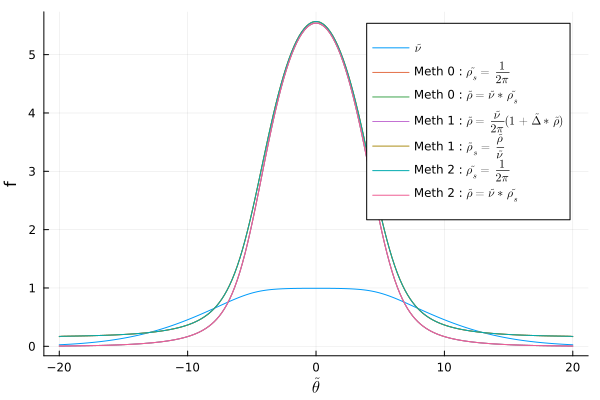

  0.001725 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih1_64.566_556.000.npz
  0.000018 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_64.566_556.000.npz
  0.002818 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_64.566_556.000.npz
saved : 2024-04-24/veff_bord_discr_ih1_64.566_556.000.npz


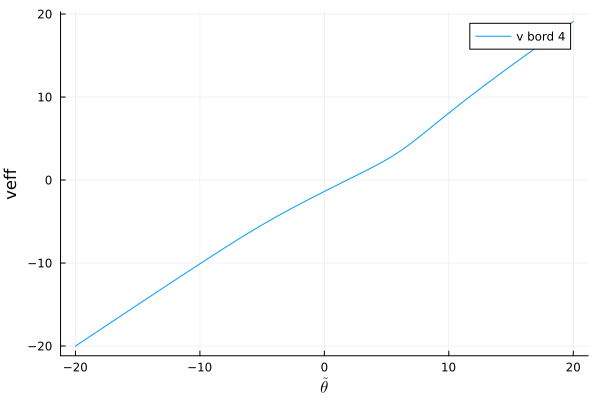

  0.187724 seconds (2.32 k allocations: 137.763 MiB, 5.27% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_64.566_556.000.npz
  0.000011 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_64.566_556.000.npz
theta_star = 1.643 
  0.001656 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_64.566_556.000.npz
  0.000021 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_64.566_556.000.npz


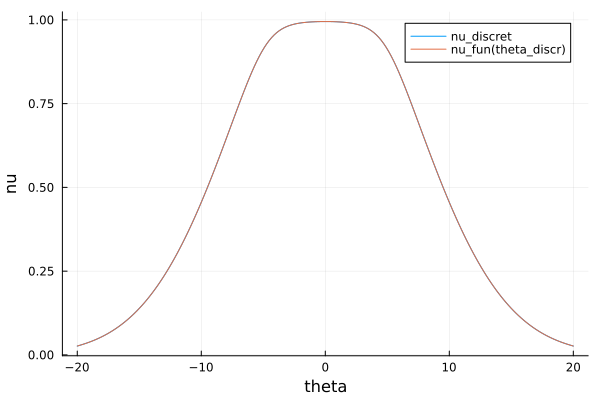

la densité haute est : 56.46504685000005
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.566_556.000_2.000_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_64.566_556.000_2.000_0.000.npz
la densité haute est : 56.46504685000005
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_64.566_556.000_2.000_veff_bord.npz


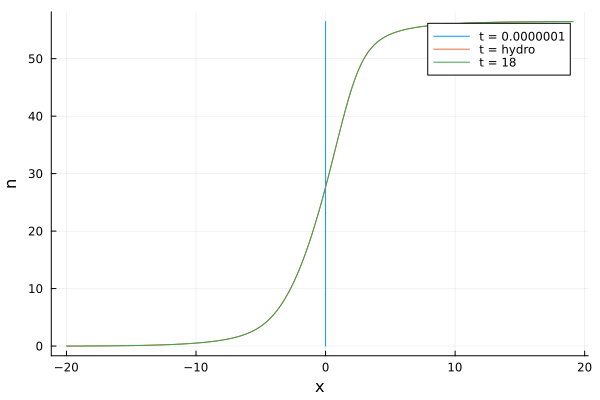

ih2


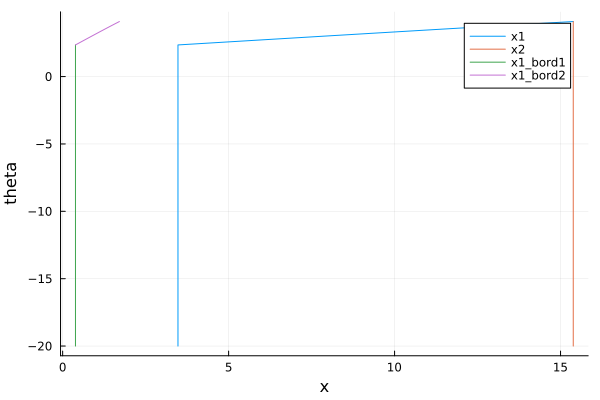

saved : 2024-04-24/theta_discr_ih2.npz
  0.015514 seconds (5.73 k allocations: 10.180 MiB)
saved : 2024-04-24/nu_discr_ih2_64.566_556.000.npz


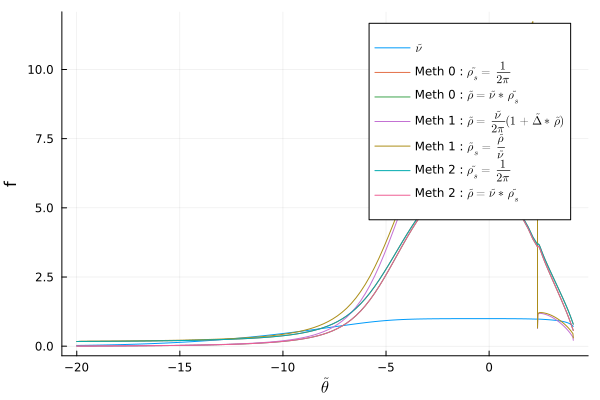

  0.001753 seconds (20 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih2_64.566_556.000.npz
  0.000027 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih2_64.566_556.000.npz
  0.002813 seconds (23 allocations: 2.150 MiB)
saved : 2024-04-24/veff_discr_ih2_64.566_556.000.npz
saved : 2024-04-24/veff_bord_discr_ih2_64.566_556.000.npz


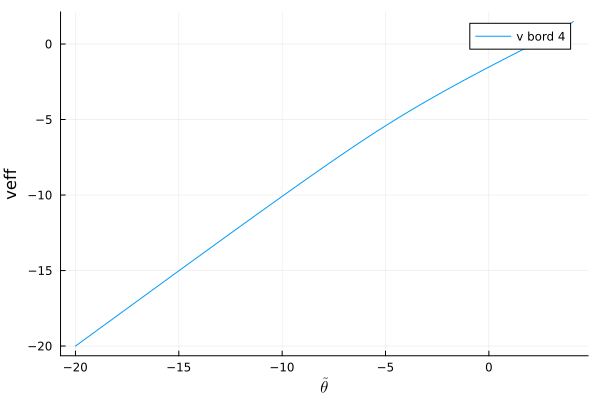

  0.194820 seconds (3.06 k allocations: 140.721 MiB, 6.45% gc time)
saved : 2024-04-24/theta_edge_1.0_ih2_64.566_556.000.npz
  0.000010 seconds (96 allocations: 5.000 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih2_64.566_556.000.npz
theta_star = 1.189 
  0.001683 seconds (20 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih2_64.566_556.000.npz
  0.000024 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih2_64.566_556.000.npz


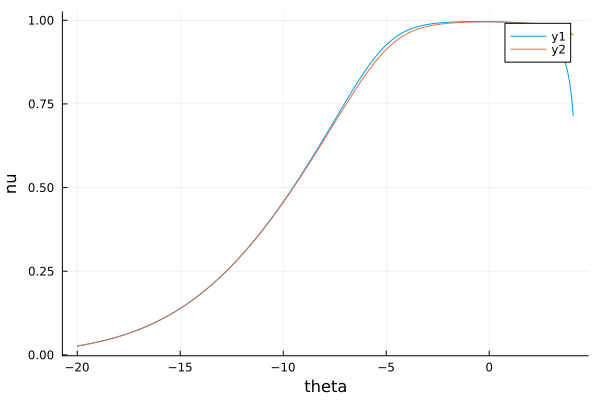

t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih2_64.566_556.000_2.000_0.000.npz
saved : 2024-04-24/bord1_theta_edge_1.0_ih2_64.566_556.000_2.000_0.000.npz
saved : 2024-04-24/bord2_theta_edge_1.0_ih2_64.566_556.000_2.000_0.000.npz


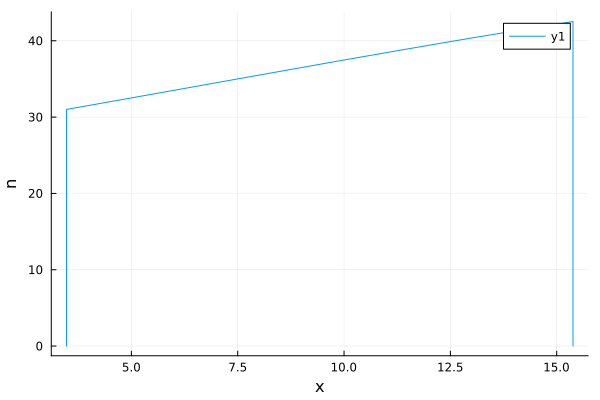

t = 0.000 
t = 1.000 saved
t = 1.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih2_64.566_556.000_2.000_1.000.npz
saved : 2024-04-24/bord1_theta_edge_1.0_ih2_64.566_556.000_2.000_1.000.npz
saved : 2024-04-24/bord2_theta_edge_1.0_ih2_64.566_556.000_2.000_1.000.npz


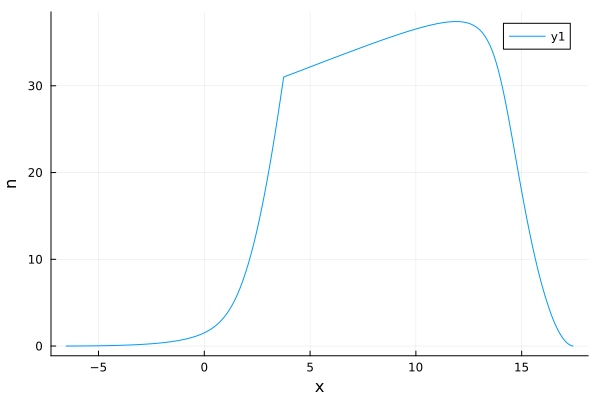

t = 2.000 saved
t = 3.000 saved
t = 4.000 saved


LoadError: InterruptException:

In [161]:
T = 556#556.975#coef(fit)[1] 
#T = coef(fit)[1] 

n_p = 56.46504685
mu = hbar*om_perp * (sqrt(1 + 4 * n_p * a3D) - 1)/kB
println("mu = ", mu)
mu = coef(curve_fit(model_mu, T*ones(1) , n_p*ones(1) , mu*kB/hbar*ones(1) ))[1] 

calcule_deformation = 1 == 1 # si on veut calculer les deformations
fit_deformation = 1 == 0 # si on veut fiter la deformation
    
calcule_expension = 1 == 1 # Si on veut fair les clacule GHD d'expension 
fit_expension = 1 == 1 # si on veut faire un fit sur l'expension 

mode = [calcule_deformation, fit_deformation, calcule_expension, fit_expension]



println("mu = ", mu)
println("T = ", T) 
println("n_p , model_mu(T , mu)", model_mu(T*ones(1) , mu*ones(1))[1])
mup = mu*kB
Taille = 23.818206787109375#24.780000000000086  #mu m 
n_p = "None"
theta_discr = LinRange(-theta_max, theta_max, npts)


x_simul, y_simul = pre_model_fit_inhomo(new_date, nom, theta_discr, n_p, mup, T, Taille, gbar , mode , "None" , "None")

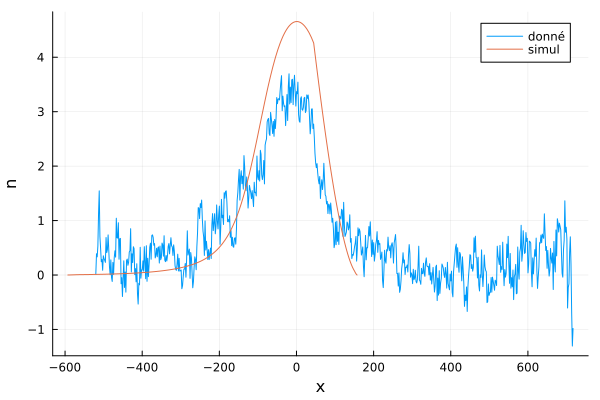

In [135]:
x_data = DONNEES[4][1] 
y_data = DONNEES[4][2]

p = plot(xlabel="x", ylabel="n", legend=:topright)
plot!(p, x_data, y_data , label = "donné")
plot!(p, x_simul * Taille, y_simul, label = "simul")
display(p)

mu = 59.69976341937398
T = 795.571439555881
n_p , model_mu(T , mu)56.46504684999994
saved : 2024-04-24/theta_discr_ih1.npz
  0.017888 seconds (4.59 k allocations: 8.207 MiB)
saved : 2024-04-24/nu_discr_ih1_59.700_795.571.npz


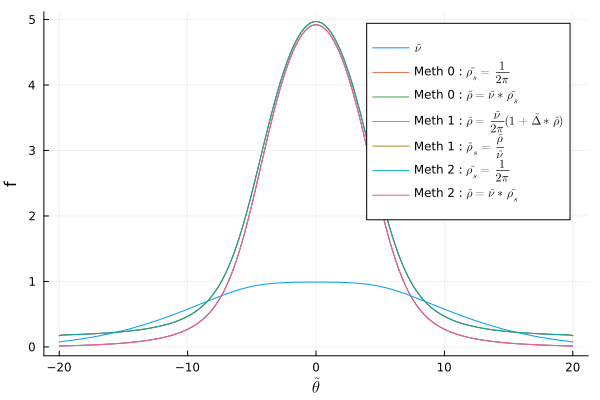

  0.014488 seconds (21 allocations: 1.840 MiB, 88.38% gc time)
saved : 2024-04-24/rho_s_discr_ih1_59.700_795.571.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih1_59.700_795.571.npz
  0.002140 seconds (23 allocations: 2.149 MiB)
saved : 2024-04-24/veff_discr_ih1_59.700_795.571.npz
saved : 2024-04-24/veff_bord_discr_ih1_59.700_795.571.npz


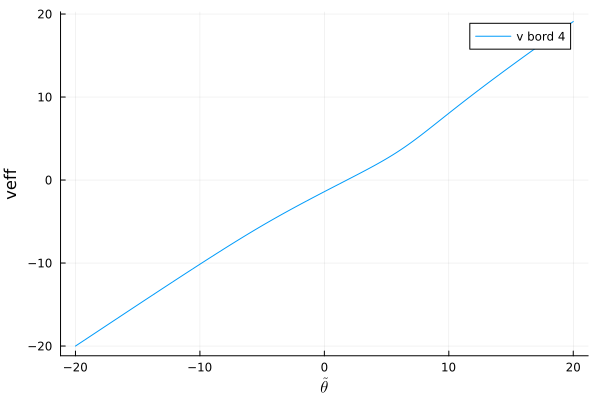

  0.143608 seconds (2.32 k allocations: 137.763 MiB, 4.50% gc time)
saved : 2024-04-24/theta_edge_1.0_ih1_59.700_795.571.npz
  0.000007 seconds (111 allocations: 5.266 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih1_59.700_795.571.npz
theta_star = 1.636 
  0.001305 seconds (21 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih1_59.700_795.571.npz
  0.000014 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih1_59.700_795.571.npz


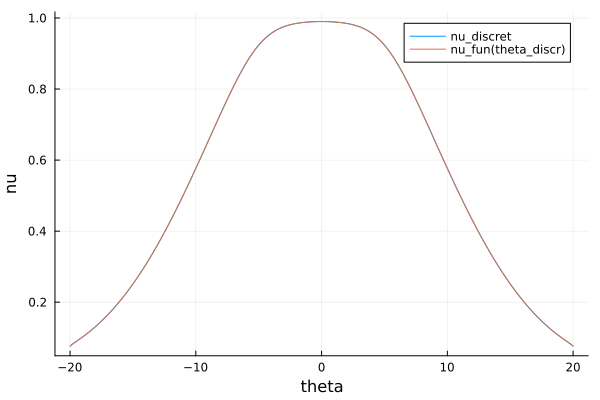

la densité haute est : 56.46504684999994
t = 0.000 saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_59.700_795.571_24.780_0.000.npz
saved : 2024-04-24/bord_theta_edge_1.0_ih1_59.700_795.571_24.780_0.000.npz
la densité haute est : 56.46504684999994
t = veff_bord saved
saved : 2024-04-24/density_expansion_nu_theta_edge_1.0_ih1_59.700_795.571_24.780_veff_bord.npz


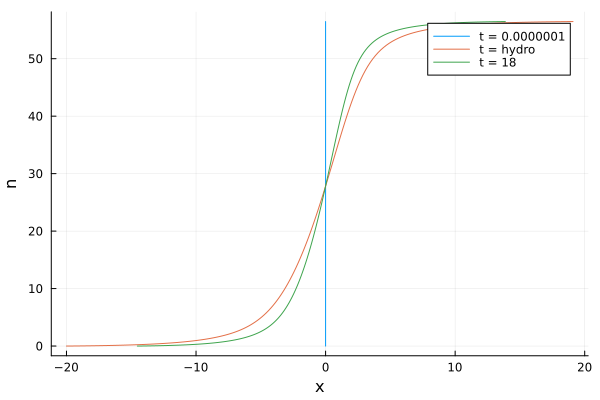

ih2


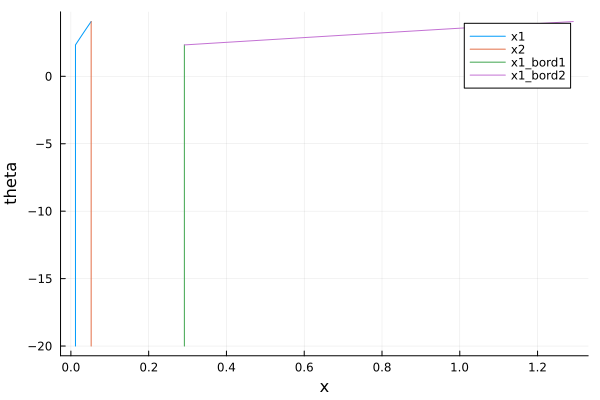

saved : 2024-04-24/theta_discr_ih2.npz
  0.026832 seconds (4.82 k allocations: 8.607 MiB, 48.34% gc time)
saved : 2024-04-24/nu_discr_ih2_59.700_795.571.npz


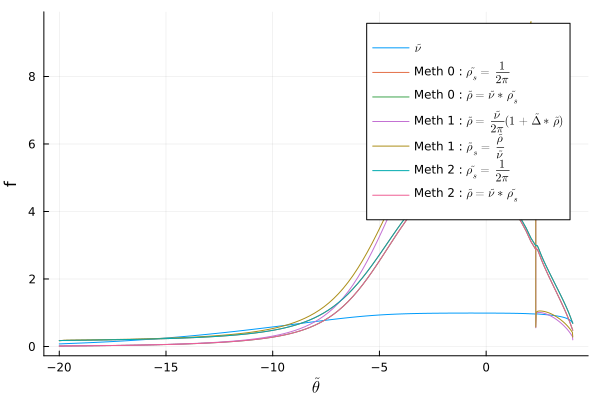

  0.001333 seconds (20 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_discr_ih2_59.700_795.571.npz
  0.000013 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_discr_ih2_59.700_795.571.npz
  0.002149 seconds (23 allocations: 2.150 MiB)
saved : 2024-04-24/veff_discr_ih2_59.700_795.571.npz
saved : 2024-04-24/veff_bord_discr_ih2_59.700_795.571.npz


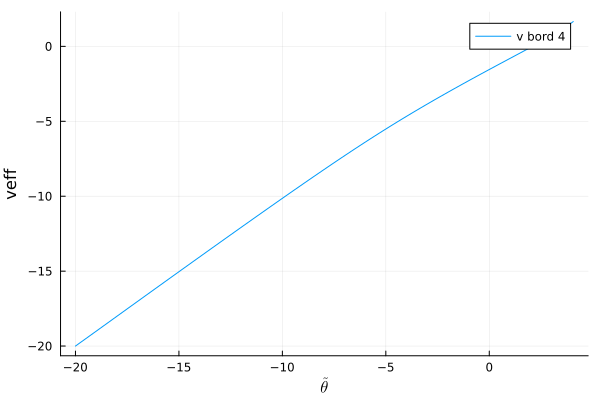

  0.148436 seconds (3.06 k allocations: 140.721 MiB, 6.01% gc time)
saved : 2024-04-24/theta_edge_1.0_ih2_59.700_795.571.npz
  0.000010 seconds (96 allocations: 5.000 KiB)
saved : 2024-04-24/nu_theta_edge_1.0_discr_ih2_59.700_795.571.npz
theta_star = 1.119 
  0.001339 seconds (20 allocations: 1.840 MiB)
saved : 2024-04-24/rho_s_theta_edge_1.0_discr_ih2_59.700_795.571.npz
  0.000017 seconds (3 allocations: 1.828 KiB)
saved : 2024-04-24/rho_theta_edge_1.0_discr_ih2_59.700_795.571.npz


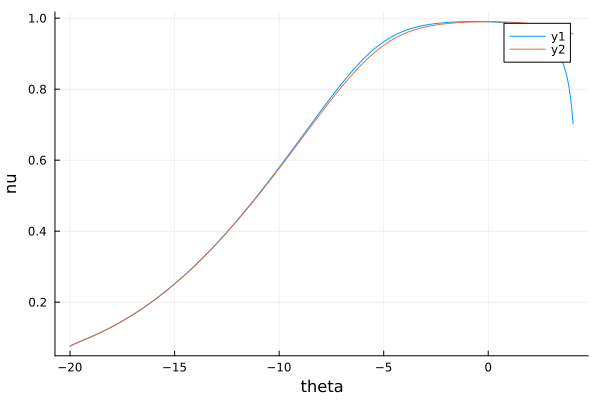

LoadError: MethodError: no method matching iterate(::Nothing)

[0mClosest candidates are:
[0m  iterate([91m::Union{LinRange, StepRangeLen}[39m)
[0m[90m   @[39m [90mBase[39m [90m[4mrange.jl:880[24m[39m
[0m  iterate([91m::Union{LinRange, StepRangeLen}[39m, [91m::Integer[39m)
[0m[90m   @[39m [90mBase[39m [90m[4mrange.jl:880[24m[39m
[0m  iterate([91m::T[39m) where T<:Union{Base.KeySet{<:Any, <:Dict}, Base.ValueIterator{<:Dict}}
[0m[90m   @[39m [90mBase[39m [90m[4mdict.jl:698[24m[39m
[0m  ...


In [101]:
#T = coef(fit)[1] 
T = 795.571439555881

n_p = 56.46504685
mu = coef(curve_fit(model_mu, T*ones(1) , n_p*ones(1) , 30*ones(1) ))[1]  
println("mu = ", mu)
println("T = ", T) 
println("n_p , model_mu(T , mu)", model_mu(T*ones(1) , mu*ones(1))[1])
mup = mu*kB
#n_p = "None"
theta_discr = LinRange(-theta_max, theta_max, npts)

calcule_deformation = 1 == 1 
fit_deformation = 0 == 1 
calcule_expension = 1 == 1
fit_expension = 0 == 1 
mode = [calcule_deformation, fit_deformation, calcule_expension, fit_expension]    
x_simul, y_simul = pre_model_fit_inhomo(new_date, nom, theta_discr, n_p, mup, T, Taille, gbar , mode , "None" ,"None")    
 
p = plot(xlabel="x", ylabel="n", legend=:topright)
plot!(p, x_data, y_data , label = "donné")
plot!(p, x_simul * Taille, y_simul, label = "simul")
display(p)

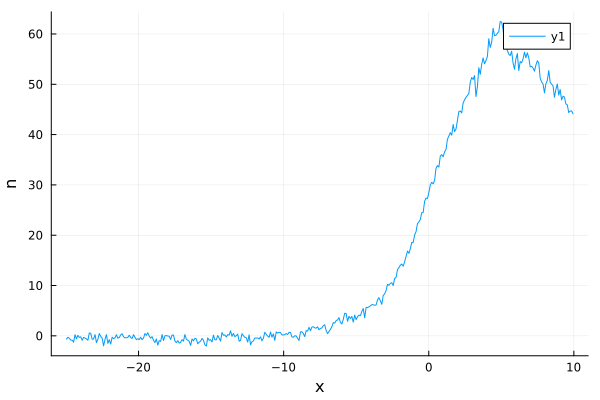

size x dat :(356,)
size(p0) : (3,)


LoadError: BoundsError: attempt to access 3-element Vector{Float64} at index [0]

In [102]:
Taille = 24.780000000000086  #mu m 

fit_deformation = 1 == 1 
fit_expension = 0 == 1 # on ne peux pas Tailles est un paramentre , doit faire varier les parametre à deux paramatre peux etre

if fit_deformation
    x_data = DONNEES[2][1]/18 
    y_data = DONNEES[2][2]
    mask = (x_data .> -25 ) .& (x_data .< 10)
    x_data = x_data[mask]
    y_data = y_data[mask]
elseif fit_expension
    x_data = DONNEES[4][1]/Taille 
    y_data = DONNEES[4][2]
    mask = (x_data .> -25000 ) .& (x_data .< 100000)
    x_data = x_data[mask]
    y_data = y_data[mask]
elseif fit_expension 
    x_data = last(DONNEES)[1]./Taille 
    y_data = last(DONNEES)[2]
end

new_date = date_donnees
# Creer  le dossier
if !isdir(new_date)
    mkdir(new_date)
end

calcule_deformation = 1 == 1 # si on veut calculer les deformations
if fit_deformation
    calcule_expension = 0 == 1 # Si on veut fair les clacule GHD d'expension 
#fit_deformation = 0 == 1 # si on veut fiter la deformation
elseif  fit_expension   
    calcule_expension = 1 == 1 # Si on veut fair les clacule GHD d'expension 
#fit_expension = 1 == 1 # si on veut faire un fit sur l'expension 
end


function model_fit_inhomo_trois(x, p)
    mup , T , Taille = p[1]*kB , p[2] , p[3]  
    n_p = "None"
    Taille = 24.780000000000086  #mu m On fix car complique de le faire varier
    println("mu = ", mup/kB)
    println("T = ", T)  
    println("Taille = ", Taille)
    theta_discr = LinRange(-theta_max, theta_max, npts) 
    mode = [calcule_deformation, fit_deformation, calcule_expension, fit_expension]    
    x_simul, y_simul = pre_model_fit_inhomo(new_date, nom, theta_discr, n_p, mup, T, Taille, gbar , mode , "None" ,"None")    
 
    #x_simul,y_simul = Float64.(x) , Float64.(y_data)

    x_simul, y_simul = trier_x_et_y(x_simul[:,1], y_simul[:,1])
    
    function density_fun(x)
        L = size(x)[1]
        y = ones(L)
        fun = LinearInterpolation(x_simul, y_simul)
        for i in 1:L
            if minimum(x_simul) < x[i] < maximum(x_simul) 
                y[i] = fun(x[i])
            else 
                y[i] = 0
            end
        end 
        return y
    end
    #density_fun = LinearInterpolation(x_simul, y_simul) 
    p = plot(xlabel="x/Taille", ylabel="n", legend=:topright)

    densi = density_fun(x)

    plot!(p, x,  y_data, label = "data")
    plot!(p, x_simul, y_simul , label = "simule")
    plot!(p, x, densi , label = "intepol")
    display(p)
    return densi
end 
    
using LsqFit


x_data, y_data = trier_x_et_y(x_data[:,1], y_data[:,1])



# Tracer les données
scatter(x_data, y_data, label="Données", xlabel="x", ylabel="y", legend=:topleft)                                                                        
p = plot(xlabel="x", ylabel="n", legend=:topright)
plot!(p, x_data, y_data )
display(p)
                                                                        
println("size x dat :"  , size(x_data))
p0 = [55 , 910.0 , 59] 
println( "size(p0) : " , size(p0))
# Bornes des paramètres
lower_bounds = 0.5 .* p0
upper_bounds = 1.5 .* p0
lower_bounds[3] = p0[0] - 0.1
upper_bounds[3] = p0[0] + 0.1


# Afficher les bornes
println("lower_bounds = ", lower_bounds , size(lower_bounds))
println("upper_bounds = ", upper_bounds, size(upper_bounds))
# Effectuer l'ajustement avec bornes
println("3")
println("size x_data : " , size(x_data))
println("size y_data : " , size(y_data))    
fit = curve_fit(model_fit_inhomo_trois, x_data, y_data , p0 ,  lower_bounds , upper_bounds)    